In [1]:
from dask.distributed import Client

client = Client("tcp://127.0.0.1:43531")
client

<Client: 'tcp://127.0.0.1:43531' processes=8 threads=40, memory=157.35 GiB>

In [2]:
import numpy as np
import xarray as xr
import pandas as pd
from xhistogram.xarray import histogram as xhist
from xgcm.grid import Grid
import xrft
import s3fs
import gsw

import glob

import gcm_filters

import os.path as op

from xeofs.models import EOF
from pydmd import DMD, BOPDMD, MrDMD
from pydmd.mrcosts import mrCOSTS
from pydmd.preprocessing import hankel_preprocessing
from pydmd.plotter import plot_eigs, plot_summary

from matplotlib import ticker
import matplotlib.colors as clr
import matplotlib.pyplot as plt
plt.rcParams['pcolor.shading'] = 'auto'
%matplotlib inline

In [3]:
import warnings
warnings.filterwarnings("ignore")

In [4]:
sdir = '/tank/spectre/tuchida/DMD/'

In [7]:
from validate_catalog import all_params
params_dict, cat = all_params()
entries = list(cat._entries.keys())
entries

['GIGATL', 'HYCOM25', 'HYCOM50', 'eNATL60', 'FESOM', 'ORCA36', 'FIO-COM32']

In [8]:
# hycom01w = cat.HYCOM50(region='1_GS', datatype='surf', season='fma', decode_times=False
#                       ).to_dask().isel(lat=slice(240,490),lon=slice(-280,None))
hycom01s = cat.HYCOM50(region='1_GS', datatype='surf', season='aso', decode_times=False
                      ).to_dask()

hycom01s

<xarray.Dataset>
Dimensions:    (lat: 615, lon: 503, time: 2208)
Coordinates:
  * time       (time) int64 0 1 2 3 4 5 6 ... 2201 2202 2203 2204 2205 2206 2207
Dimensions without coordinates: lat, lon
Data variables:
    latitude   (lat) float32 dask.array<chunksize=(615,), meta=np.ndarray>
    longitude  (lon) float32 dask.array<chunksize=(503,), meta=np.ndarray>
    ssh        (time, lat, lon) float32 dask.array<chunksize=(24, 615, 503), meta=np.ndarray>
    sss        (time, lat, lon) float32 dask.array<chunksize=(24, 615, 503), meta=np.ndarray>
    sst        (time, lat, lon) float32 dask.array<chunksize=(24, 615, 503), meta=np.ndarray>
    tauewd     (time, lat, lon) float32 dask.array<chunksize=(24, 615, 503), meta=np.ndarray>
    taunwd     (time, lat, lon) float32 dask.array<chunksize=(24, 615, 503), meta=np.ndarray>
    uu1        (time, lat, lon) float32 dask.array<chunksize=(24, 615, 503), meta=np.ndarray>
    vv1        (time, lat, lon) float32 dask.array<chunksize=(24, 615, 503), meta=np.ndarray>

In [9]:
hycom50_grids = xr.open_dataset('/tank/spectre/tuchida/SWOT/Models/HYCOM50/HYCOM50_grid_GS_all.nc'
                               )
hycom50_grids

<xarray.Dataset>
Dimensions:  (lat: 615, lon: 503)
Dimensions without coordinates: lat, lon
Data variables: (12/20)
    plat     (lat, lon) float64 ...
    plon     (lat, lon) float64 ...
    qlat     (lat, lon) float64 ...
    qlon     (lat, lon) float64 ...
    ulat     (lat, lon) float64 ...
    ulon     (lat, lon) float64 ...
    ...       ...
    vscx     (lat, lon) float64 ...
    vscy     (lat, lon) float64 ...
    pang     (lat, lon) float64 ...
    cori     (lat, lon) float64 ...
    pasp     (lat, lon) float64 ...
    depth    (lat, lon) float64 ...

<xarray.Dataset>
Dimensions:  (lat: 260, lon: 280)
Dimensions without coordinates: lat, lon
Data variables: (12/20)
    plat     (lat, lon) float64 ...
    plon     (lat, lon) float64 ...
    qlat     (lat, lon) float64 ...
    qlon     (lat, lon) float64 ...
    ulat     (lat, lon) float64 ...
    ulon     (lat, lon) float64 ...
    ...       ...
    vscx     (lat, lon) float64 ...
    vscy     (lat, lon) float64 ...
    pang     (lat, lon) float64 ...
    cori     (lat, lon) float64 ...
    pasp     (lat, lon) float64 ...
    depth    (lat, lon) float64 ...

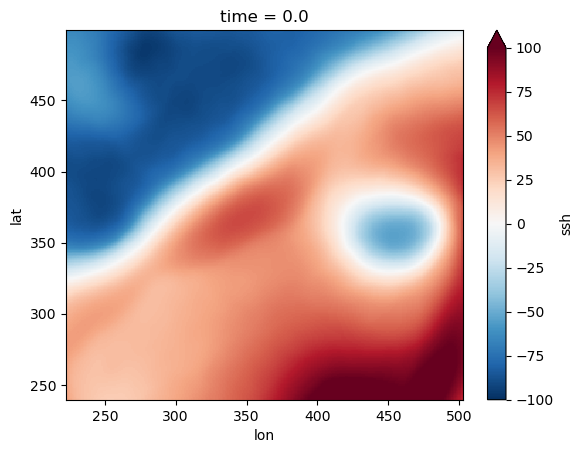

In [10]:
fscale = 10
nh = 3
dsh = xr.open_zarr(
    '/tank/spectre/tuchida/SWOT/Models/HYCOM50/SSH_%02dkm.zarr'
    % fscale
).isel(lat=slice(240,500),lon=slice(-280,None))
SSH = dsh.ssh.isel(time=np.arange(0,len(dsh.time),nh))
SSH = SSH.assign_coords({'time':np.arange(len(SSH.time)) * 3600.*nh})
SSH.isel(time=0).plot(rasterized=True, vmax=100)

hycom_grid = xr.open_dataset(
    '/tank/spectre/tuchida/SWOT/Models/HYCOM50/HYCOM50_grid_GS_all.nc'
                            ).isel(lat=slice(240,500),lon=slice(-280,None))
hycom_grid

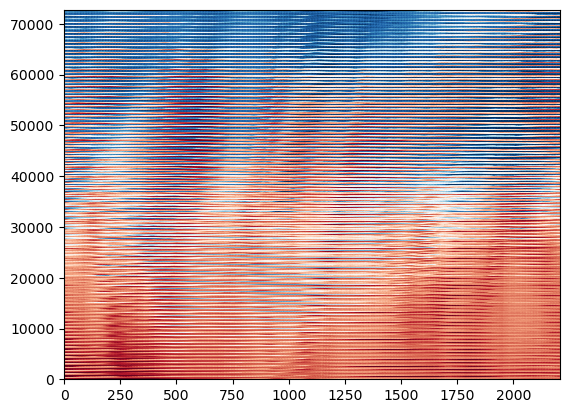

<xarray.DataArray 'ssh' (z: 72800, time: 736)>
dask.array<transpose, shape=(72800, 736), dtype=float32, chunksize=(1750, 8), chunktype=numpy.ndarray>
Coordinates:
  * time     (time) float64 0.0 1.08e+04 2.16e+04 ... 7.927e+06 7.938e+06
  * z        (z) object MultiIndex
  * lat      (z) int64 240 240 240 240 240 240 240 ... 499 499 499 499 499 499
  * lon      (z) int64 223 224 225 226 227 228 229 ... 497 498 499 500 501 502

In [11]:
zchunk = 1750
# h_stacked = SSH.stack(z=("lat","lon")).chunk({'z':zchunk})
h_stacked = SSH.stack(z=("lat","lon")).chunk({'z':zchunk})
# t_stacked = SST.stack(z=("lat","lon")).chunk({'z':zchunk})
# s_stacked = SSS.stack(z=("lat","lon")).chunk({'z':zchunk})
# u_stacked = hycom01s.uu1.stack(z=("lat","lon")).chunk({'z':zchunk})
# v_stacked = hycom01s.vv1.stack(z=("lat","lon")).chunk({'z':zchunk})
# hts = xr.concat([xr.concat([h_stacked.drop("z")/ampH, 
#                             t_stacked.drop("z")/ampT
#                            ], dim="z"), 
#                  s_stacked.drop("z")/ampS
#                 ], dim='z')

fig, ax = plt.subplots()
ax.pcolormesh(dsh.ssh.stack(z=("lat","lon")).chunk({'z':zchunk}).T.values, 
               rasterized=True, vmax=100, vmin=-100, cmap='RdBu_r')
plt.show()
h_stacked.T

In [16]:
# # window_lengths = np.array([8, 16, 64, 240])
# # step_sizes = np.array([1, 1, 2, 16])
window_lengths = (np.array([24, 48, 192, 720]) / nh).astype(int)     # 3 hourly, 4 layers
step_sizes = np.array([1, 1, 2, 16])
# # window_lengths = np.array([8, 16, 28, 72, 240
# # step_sizes = np.array([1, 2, 2, 4, 16])
# window_lengths = (np.array([24, 48, 84, 216, 720]) / nh).astype(int) # 3 hourly, 5 layers
# step_sizes = np.array([1, 2, 2, 4, 16])
# window_lengths = (np.array([96, 192, 720]) / nh).astype(int)         # 12 hourly, 3 layers
# step_sizes = np.array([2, 4, 16])
window_lengths, window_lengths*(nh*3600)/86400

(array([  8,  16,  64, 240]), array([ 1.,  2.,  8., 30.]))

In [17]:
fit = False

In [18]:
# window_lengths = [15, 60]
# step_sizes = [1, 12]
# step_sizes = (window_lengths * .07).astype(int)
sr = 6
svd_ranks = [sr] * len(window_lengths)
suppress_growth = True
transform_method = "absolute"
# n_components_array = [2] * len(window_lengths)
global_svd_array = [False] * len(window_lengths)

dmd = mrCOSTS(
    svd_rank_array=svd_ranks,
    window_length_array=window_lengths,
    step_size_array=step_sizes,
    global_svd_array=global_svd_array,
    cluster_sweep=True,
    transform_method=transform_method,
    # pydmd_kwargs={'eig_constraints':{"imag", "conjugate_pairs"}},
    # n_components_array=n_components_array,
)

if fit:
    dmd.fit(h_stacked.values.T, 
            np.atleast_2d(h_stacked.time.data)
           )

In [19]:
if fit:
    dmd.to_netcdf(op.join(sdir, 
                          "HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d_fit"
                          % (nh,len(window_lengths))
                         )
                 )
else:
    mrc = glob.glob(op.join(sdir, 
                            "HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d_fit*.nc"
                            % (nh,len(window_lengths))
                           )
                   )
    print(mrc)
    dmd = mrCOSTS()
    dmd.from_netcdf(mrc)

['/tank/spectre/tuchida/DMD/HYCOM50/ASO/mrCOSTS_h/03hourly/04_fit.window=64.nc', '/tank/spectre/tuchida/DMD/HYCOM50/ASO/mrCOSTS_h/03hourly/04_fit.window=16.nc', '/tank/spectre/tuchida/DMD/HYCOM50/ASO/mrCOSTS_h/03hourly/04_fit.window=8.nc', '/tank/spectre/tuchida/DMD/HYCOM50/ASO/mrCOSTS_h/03hourly/04_fit.window=240.nc']


In [122]:
# Plot the 3rd decomposition level
n_decomp = 2
mrd = dmd.costs_array[n_decomp]

# The data for each decomposition level is built here to avoid
# reconstructing the data for each plot. If this is not done the
# plots can still be rendered but will take slightly longer.
if n_decomp == 0:
    x_iter = data
else:
    x_iter, _ = dmd.costs_array[n_decomp - 1].scale_separation(
        scale_reconstruction_kwargs=dmd._costs_recon_kwargs
    )

Text(0.5, 0.98, 'Window length=64')

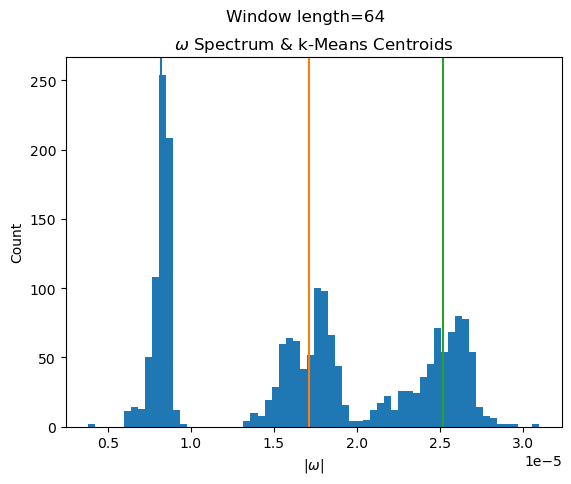

In [123]:
fig, ax = mrd.plot_omega_histogram()
fig.suptitle("Window length={}".format(mrd.window_length))

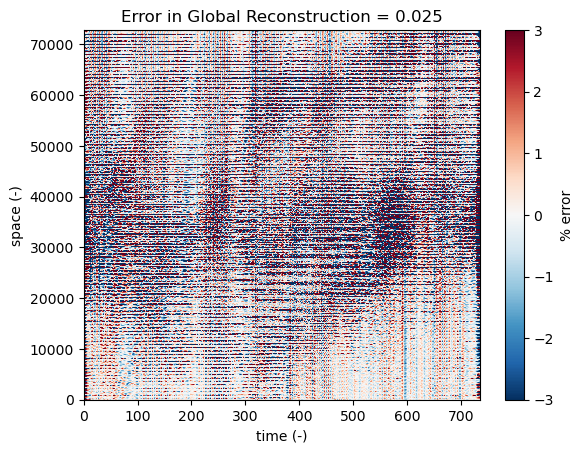

In [124]:
# Error in global reconstruction
dmd.plot_local_error(
    n_decomp, data=x_iter, scale_reconstruction_kwargs=dmd._costs_recon_kwargs
)

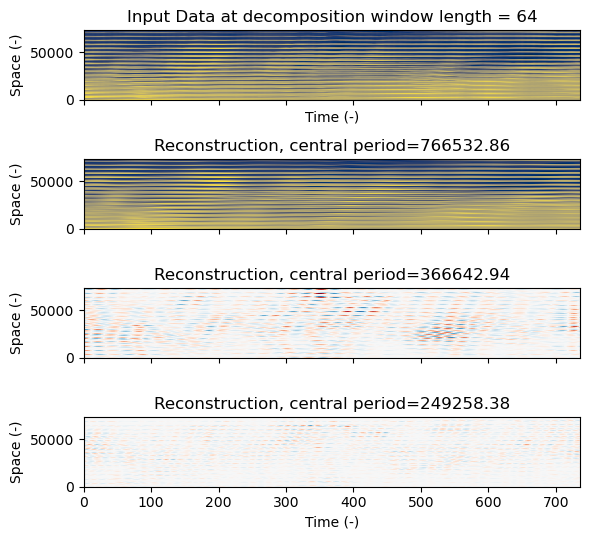

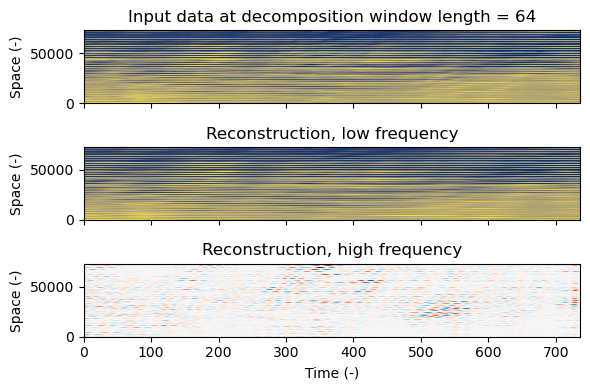

In [125]:
# Scale separation
_ = dmd.plot_local_reconstructions(
    n_decomp,
    data=x_iter,
    kwargs={"plot_period": True},
    scale_reconstruction_kwargs=dmd._costs_recon_kwargs,
)

# Alternatively you can use the local scale separation to visualize the individual frequency bands
# seen in the eigenvalue histogram.
_ = dmd.plot_local_scale_separation(
    n_decomp, data=x_iter, scale_reconstruction_kwargs=dmd._costs_recon_kwargs
)

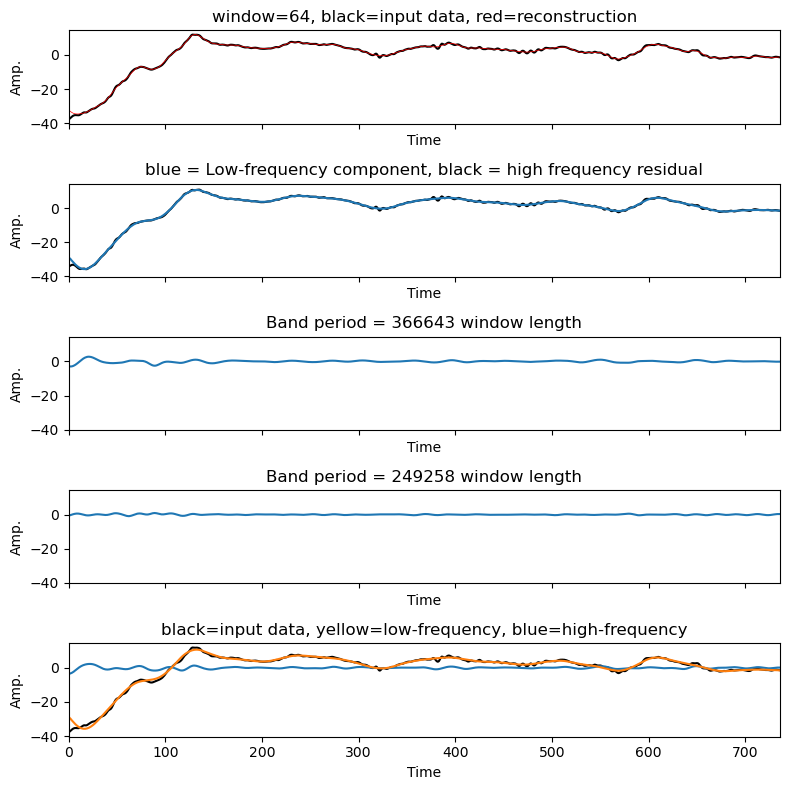

In [126]:
# Single points in space
space_index = 40
_, _ = dmd.plot_local_time_series(
    space_index,
    n_decomp,
    x_iter,
    scale_reconstruction_kwargs=dmd._costs_recon_kwargs,
)

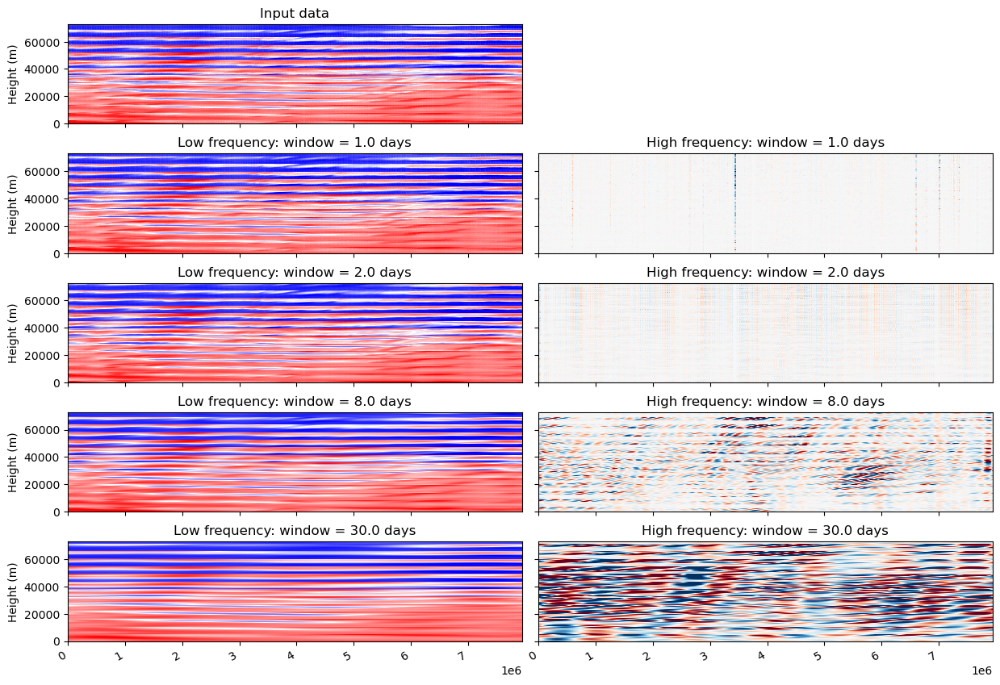

In [127]:
vscale = 10
fig, axes = plt.subplots(
    dmd.n_decompositions + 1,
    2,
    figsize=(6.25*2, dmd.n_decompositions * 1.25*2),
    sharex=True,
    sharey=True,
)

plot_kwargs = {
    "cmap": "RdBu_r",
    "vmin": -vscale,
    "vmax": vscale,
}

plot_kwargs_lf = {
    "cmap": "bwr",
    "vmin": -100,
    "vmax": 100,
}

ax = axes[0, 0]
ax.pcolormesh(h_stacked.time.values, np.arange(len(h_stacked.z)), h_stacked.T, **plot_kwargs_lf)
ax.set_title("Input data")
ax.set_ylabel("Height (m)")

axes[0, 1].axis("off")
for nm, m in enumerate(dmd.costs_array):
    xr_low_frequency, xr_high_frequency = m.scale_separation()

    ax = axes[nm + 1, 1]
    ax.pcolormesh(
        h_stacked.time.values, np.arange(len(h_stacked.z)), xr_high_frequency, **plot_kwargs
    )
    ax.set_title(
        "High frequency: window = {} days".format(m._window_length*nh*3600./86400.))

    ax = axes[nm + 1, 0]
    ax.pcolormesh(
        h_stacked.time.values, 
        np.arange(len(h_stacked.z)),
        xr_low_frequency,
        **plot_kwargs_lf
    )
    ax.set_title(
        "Low frequency: window = {} days".format(m._window_length*nh*3600./86400.))
    ax.set_ylabel("Height (m)")

# axes[-1, 0].xaxis.set_major_formatter(DateFormatter("%H:%M"))

fig.tight_layout()
fig.autofmt_xdate()

## Interpolate to time scales

In [20]:
dmd.multi_res_interp()
dmd._da_omega

<xarray.DataArray 'omega' (window_length: 4, window_time_means: 729, svd_rank: 6)>
array([[[-8.25826472e-05+0.00028726j,  1.77775535e-05-0.00025796j,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        [-1.18219751e-05+0.00029237j, -8.76770188e-06-0.00023383j,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        [-5.24336553e-05+0.00027215j, -2.68776331e-05-0.00028597j,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        ...,
        [-1.12019420e-04+0.00031144j, -1.12505070e-04-0.00031202j,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        [-4.73127549e-05+0.00029753j,  6.56881325e-05-0.00029237j,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        [-5.56671297e-05+0.00026914j, -5.17327564e-05-0.00026975j,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj]],

...

       [[            nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        [            nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        [            nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        ...,
        [            nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        [            nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj],
        [            nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj,
                     nan       +nanj,             nan       +nanj]]])
Coordinates:
  * window_time_means    (window_time_means) float64 3.78e+04 ... 7.9e+06
  * svd_rank             (svd_rank) int64 0 1 2 3 4 5
    slide                (window_length, window_time_means) float64 0.0 ... 31.0
  * window_length        (window_length) int64 8 16 64 240
    decomposition_level  (window_length) int64 0 1 2 3

(4, 4374)


Text(0, 0.5, 'Weighted Count (-)')

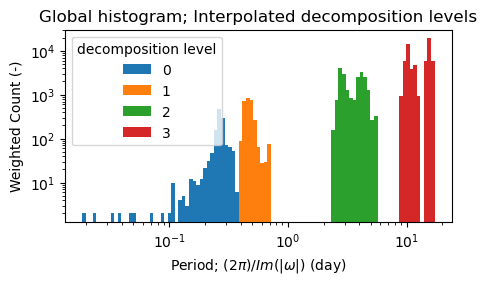

In [21]:
da = dmd._da_omega
omega = da.values
omega = omega.reshape(
    len(da.window_length), len(da.window_time_means) * len(da.svd_rank)
)

fig, ax = plt.subplots(figsize=(5, 2.5))
omega_trans = (2 * np.pi) / np.abs(omega.imag) / 86400
print(omega_trans.shape)

# Provide weights so that the smallest decomposition level and the largest
# are visually comparable (this also foreshadows the interpolation problem below).
weights = dmd.window_length_array / dmd.window_length_array[0]
weights = np.broadcast_to(np.atleast_2d(weights).T, (omega_trans.shape))

ax.hist(
    x=omega_trans.T,
    bins=np.logspace(start=np.log10(np.nanmin(omega_trans)), 
                     stop=np.log10(np.nanmax(omega_trans)), num=100),
    histtype="barstacked",
    label=range(dmd.n_decompositions),
    weights=weights.T,
)
ax.set_xscale("log")
ax.set_yscale("log")
ax.legend(title="decomposition level")
ax.set_title("Global histogram; Interpolated decomposition levels")
ax.set_xlabel(r"Period; $(2 \pi) / Im(|\omega|)$ (day)")
ax.set_ylabel("Weighted Count (-)")

Text(0.5, 0, 'Period; $(2 \\pi) / Im(|\\omega|)$ (s)')

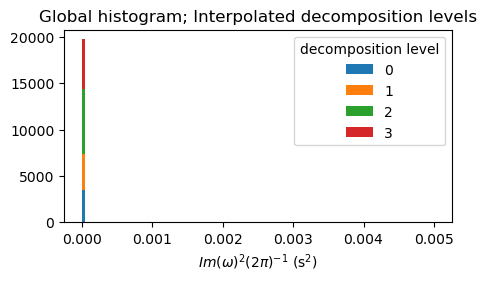

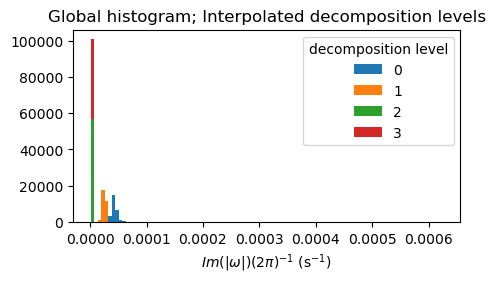

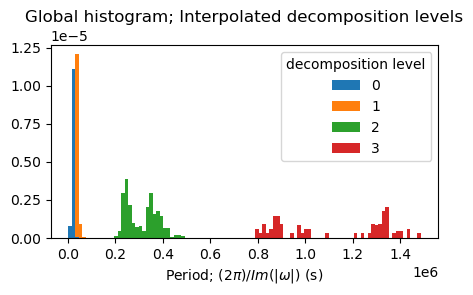

In [22]:
da = dmd._da_omega
x = da.values
x = x.reshape(
    len(da.window_length), 
    len(da.window_time_means) * len(da.svd_rank)
)

# Squared frequencies
x_trans = np.abs(x.imag) ** 2 / (2 * np.pi)
fig, ax = plt.subplots(figsize=(5, 2.5))
ax.hist(
    x=x_trans.T,
    bins=np.linspace(0, 0.005, 100),
    histtype="barstacked",
    density=True,
    label=range(dmd.n_decompositions),
)
ax.set_title("Global histogram; Interpolated decomposition levels")
ax.set_xlabel(r"$Im(\omega)^2 (2 \pi)^{-1}$ (s$^2$)")
ax.legend(title="decomposition level")

# Frequency
fig, ax = plt.subplots(figsize=(5, 2.5))
x_trans = np.abs(x.imag) / (2 * np.pi)
ax.hist(
    x=x_trans.T,
    bins=100,
    histtype="barstacked",
    density=True,
    label=range(dmd.n_decompositions),
)
ax.set_title("Global histogram; Interpolated decomposition levels")
ax.set_xlabel(r"$Im(|\omega|) (2 \pi)^{-1}$ (s$^{-1}$)")
ax.legend(title="decomposition level")

# Period
fig, ax = plt.subplots(figsize=(5, 2.5))
x_trans = (2 * np.pi) / np.abs(x.imag)
ax.hist(
    x=x_trans.T,
    bins=100,
    histtype="barstacked",
    density=True,
    label=range(dmd.n_decompositions),
)
ax.legend(title="decomposition level")
ax.set_title("Global histogram; Interpolated decomposition levels")
ax.set_xlabel(r"Period; $(2 \pi) / Im(|\omega|)$ (s)")

Text(0, 0.5, 'Weighted Count (-)')

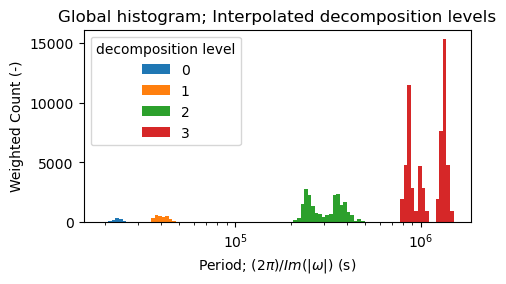

In [17]:
fig, ax = plt.subplots(figsize=(5, 2.5))
x_trans = (2 * np.pi) / np.abs(x.imag)

# Provide weights so that the smallest decomposition level and the largest
# are visually comparable (this also foreshadows the interpolation problem below).
weights = dmd.window_length_array / dmd.window_length_array[0]
weights = np.broadcast_to(np.atleast_2d(weights).T, 
                          (x_trans.shape))

ax.hist(
    x=x_trans.T,
    bins=np.logspace(start=np.log10(1.9e4), 
                     stop=np.log10(1.5e6), 
                     num=100),
    histtype="barstacked",
    label=range(dmd.n_decompositions),
    weights=weights.T,
)
ax.set_xscale("log")
ax.legend(title="decomposition level")
ax.set_title("Global histogram; Interpolated decomposition levels")
ax.set_xlabel(r"Period; $(2 \pi) / Im(|\omega|)$ (s)")
ax.set_ylabel("Weighted Count (-)")

Text(0.5, 1.0, 'Normalized mode spatial amplitude for each decomp. level')

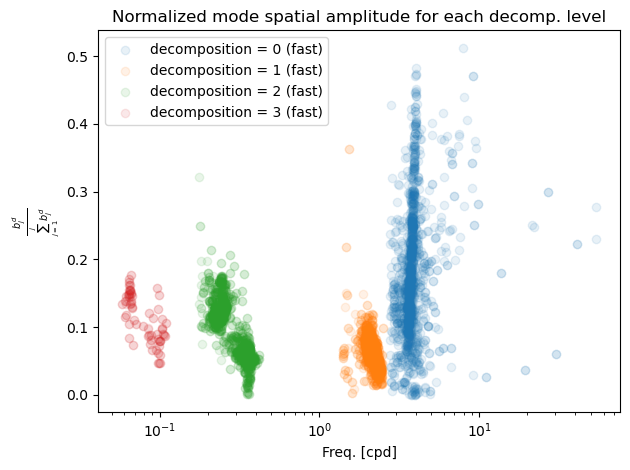

In [20]:
fig, ax = plt.subplots(1, 1)
fig.set_tight_layout(True)
for nm, m in enumerate(dmd.costs_array):
    # Extract out the amplitudes of the spatial modes
    b = m.amplitudes_array
    mode_periods = m.periods()

    # Ratio of spatial amplitude for each mode relative to the amplitudes for all
    # high frequency modes (selected using the `omega_classes > 0` indexing)
    sum_b_ratio = (b.T / np.sum(b, axis=1)).T[m.omega_classes > 0].real

    ax.scatter(
        x=mode_periods**-1*86400,
        y=sum_b_ratio,
        alpha=0.1,
        label="decomposition = {} (fast)".format(nm),
    )

    # # Ratio of spatial amplitude for each mode relative to the amplitudes for all
    # # low frequency modes (selected using the `omega_classes == 0` indexing)
    # sum_b_ratio = (b.T / np.sum(b, axis=1)).T[m.omega_classes == 0].real

    # ax.scatter(
    #     x=mode_periods**-1*86400,
    #     y=sum_b_ratio[:len(mode_periods)],
    #     alpha=0.1,
    #     marker='x',
    #     label="decomposition = {} (slow)".format(nm),
    # )

# ax.set_ylim(0, 0.25)
ax.legend()
ax.set_xscale("log")
ax.set_ylabel(r"$\frac{b^{d}_j}{\sum^{j}_{j=1}b^{d}_j}$")
ax.set_xlabel("Freq. [cpd]")
ax.set_title("Normalized mode spatial amplitude for each decomp. level")

In [18]:
delta_t = 3600.*nh
Fh = xrft.power_spectrum(SSH.isel(lat=np.arange(0,len(SSH.lat),50),
                                  lon=np.arange(0,len(SSH.lon),50)
                                 ).chunk({'time':-1}), 
                         dim='time', window='hann', window_correction=True
                        ).astype(np.single)
############################
ds = xr.open_zarr(op.join(sdir,'HYCOM50/ASO/DMD_h/%02dhourly/modes_%02dkm.zarr'
                          % (3,fscale)), 
                  decode_times=False)
DMDfreqs = np.abs(np.log(ds.Lamb).imag.load() / (2*np.pi*delta_t))
DMDpwr = (np.abs(ds.B.load()) * (delta_t * len(SSH.time))) ** 2

DMDpwr *= Fh.freq_time.spacing.data
ds.close()
############################
mrls = 7
ds = xr.open_zarr(op.join(sdir,
                'HYCOM50/ASO/mrDMD_h/%02dhourly/%02dlevels/%02dmax-cycle/modes_%02dkm.zarr'
                          % (3, mrls, 4, fscale)), 
                  decode_times=False)
mrDMDfreqs = np.abs(np.log(ds.Lamb).imag.load() / (2*np.pi*delta_t))
for i in range(mrls):
    bb = ds.B.where(ds.B.level==i, drop=True).load()
    if i == 0:
        mrDMDpwr = (np.abs(bb) * (delta_t * len(SSH.time) // len(bb))) ** 2
    else:
        mrDMDpwr = xr.concat([mrDMDpwr, 
                              (np.abs(bb) * (delta_t * len(SSH.time) // len(bb))) ** 2
                             ], 'mode')
    del bb

mrDMDpwr *= Fh.freq_time.spacing.data
ds.close()

Text(0.5, 1.0, 'Frequency spectra')

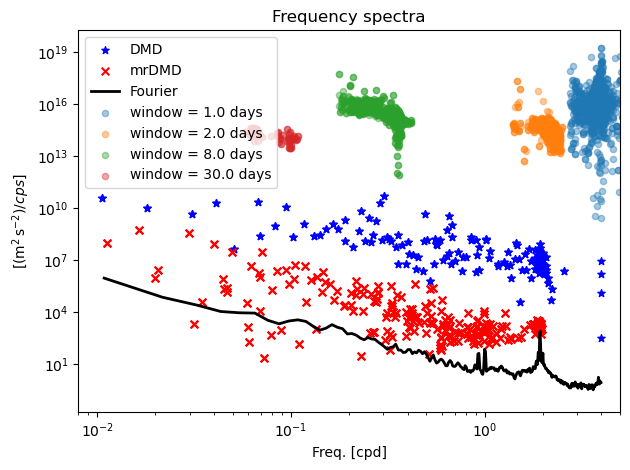

In [50]:
fig, ax = plt.subplots()
fig.set_tight_layout(True)

ax.scatter(DMDfreqs*86400, DMDpwr * 1e-4, 
           s=30, c='b', marker='*', label=r"DMD")
ax.scatter(mrDMDfreqs*86400, mrDMDpwr * 1e-4, 
           s=30, c='r', marker='x', label=r"mrDMD")
ax.plot(Fh.freq_time.isel(freq_time=slice(len(Fh.freq_time)//2+1,None))*86400, 
        Fh.isel(freq_time=slice(len(Fh.freq_time)//2+1,None)
               ).mean(['lat','lon'])*2 * 1e-4, 
        c='k', lw=2, label=r"Fourier")

for nm, m in enumerate(dmd.costs_array):
    # Extract out the amplitudes of the spatial modes
    b = m.amplitudes_array
    # mrCOSTSf = np.abs(np.log(m._da_omega).imag.load() / (2*np.pi*delta_t))

    # Ratio of spatial amplitude for each mode relative to the amplitudes for all
    # high frequency modes (selected using the `omega_classes > 0` indexing)
    # sum_b_ratio = (b.T / np.sum(b, axis=1)).T[m.omega_classes > 0].real
    sum_b_ratio = (np.abs((b 
                           #.T / np.sum(b, axis=1)).T
                          )[m.omega_classes > 0]) 
                   * (delta_t * len(m.periods()))) ** 2
    mode_periods = m.periods()

    ax.scatter(
        x=mode_periods**-1*86400,
        # x=mrCOSTSf*86400,
        y=sum_b_ratio * 1e-4,
        alpha=0.4,
        s=20,
        label="window = {} days".format(window_lengths[nm]*3*3600./86400),
    )

# ax.set_ylim(0, 0.25)
ax.set_xlim([8e-3,5e0])
ax.legend(loc='upper left')
ax.set_xscale("log")
ax.set_yscale("log")
# ax.set_ylabel(r"$\frac{b^{d}_j}{\sum^{j}_{j=1}b^{d}_j}$")
ax.set_ylabel(r"[(m$^2\,$s$^{-2})/cps$]")
ax.set_xlabel("Freq. [cpd]")
ax.set_title("Frequency spectra")

fitting n_components = 12
fitting n_components = 13
fitting n_components = 14
fitting n_components = 15
fitting n_components = 16
fitting n_components = 17
fitting n_components = 18
fitting n_components = 19
fitting n_components = 20
fitting n_components = 21
Optimal silhouette score is = 12


Text(0, 0.5, 'Silhouette score (-), (1 is best, -1 is worst)')

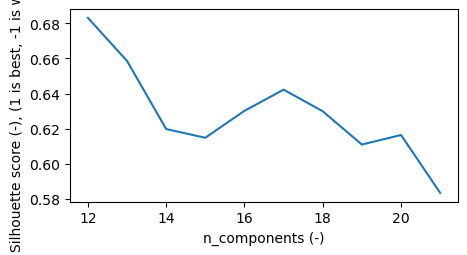

In [23]:
n_components_range = np.arange(12, 22)
scores, n_optimal = dmd.global_cluster_hyperparameter_sweep(
    n_components_range,
    transform_method="log10",
)

print("Optimal silhouette score is = {}".format(n_optimal))
plt.figure(figsize=(5, 2.5))
plt.plot(n_components_range, scores)
plt.gca().set_xlabel("n_components (-)")
plt.gca().set_ylabel("Silhouette score (-), (1 is best, -1 is worst)")

In [24]:
cluster_centroids, omega_classes, omega_array = dmd.global_cluster_omega(
    n_optimal, transform_method="log10"
)
cluster_centers_periods = 1 / (10 ** (cluster_centroids) / (2 * np.pi))

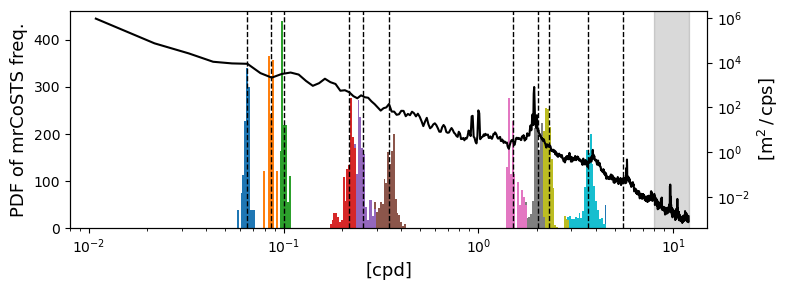

In [21]:
x_trans = (2 * np.pi / 10**omega_array / 86400.)**-1
unique_labels, label_counts = np.unique(omega_classes, return_counts=True)
weights = label_counts.max() / label_counts
x_trans_labels = [x_trans[omega_classes == label] for label in unique_labels]

weights_labels = []
unique_labels = unique_labels.astype(int)
for label in unique_labels:
    ind_array = np.flatnonzero(unique_labels == label)
    ind_list = int(ind_array)
    w = weights[ind_array]
    x_w = x_trans_labels[ind_list]
    w_broadcast = np.broadcast_to(w, (x_w.shape))
    weights_labels.append(w_broadcast)

delta_t = 3600
Fh = xrft.power_spectrum(dsh.ssh.isel(lat=np.arange(0,len(SSH.lat),50),
                                  lon=np.arange(0,len(SSH.lon),50)
                                 ).chunk({'time':-1}
                                        ).assign_coords({'time':np.arange(len(dsh.time)
                                                                         ) * 3600.}), 
                         dim='time', window='hann', window_correction=True
                        ).astype(np.single)

fig, ax = plt.subplots(figsize=(8, 3))
ax2 = ax.twinx()
fig.set_tight_layout(True)

ax.hist(
    x=x_trans_labels,
    bins=np.logspace(stop=np.log10((1.9e4/86400)**-1), 
                     start=np.log10((1.5e6/86400)**-1), 
                     num=200),
    histtype="barstacked",
    weights=weights_labels,
    # alpha=.8,
)

ax2.plot(Fh.freq_time.isel(freq_time=slice(len(Fh.freq_time)//2+1,None))*86400, 
        Fh.isel(freq_time=slice(len(Fh.freq_time)//2+1,None)
               ).mean(['lat','lon'])*2 * 1e-4, 
        c='k', label=r"Fourier")

# ax = plt.gca()
ax.set_xscale("log")
ax2.set_xscale("log")
ax2.set_yscale("log")
# ax.set_title(
#     "Global histogram of frequencies; Interpolated decomposition levels"
# )
# ax.set_xlabel(r"Period; $(2 \pi) / Im(|\omega|)$ [day]")
ax.set_xlabel(r"[cpd]", fontsize=13)
ax.set_ylabel("PDF of mrCoSTS freq.", fontsize=13)
ax2.set_ylabel("[m$^2\,/\,$cps]", fontsize=13)
[
    ax.axvline((2 * np.pi / (10**c) / 86400)**-1, color="k", ls="--", lw=1)
    for nc, c in enumerate(cluster_centroids)
];

ax.set_xlim([8e-3,1.5e1])
ax2.set_xlim([8e-3,1.5e1])
ax2.set_ylim([4e-4,2e6])

ax2.fill_between(np.array([1/(3*3600.)*86400, 1/(2*3600.)*86400]), 
                 2e-4, 2e6, 
                 color='k', alpha=.15)

# ylim_bottom, ylim_top = ax.get_ylim()
# [
#     ax.text(
#         2 * np.pi / (10**c),
#         ylim_top - ylim_top * 0.1,
#         "{:4.0f}d".format(1 / (10 ** (c) / (2 * np.pi))),
#         rotation="vertical",
#         va="top",
#         ha="right",
#     )
#     for c in cluster_centroids
# ];
plt.savefig(op.join(sdir,'Figs/HYCOM50_mrCOSTS_hist_%02dh.pdf' % nh))

In [25]:
omega_classes_list = dmd.multi_res_deterp()

In [26]:
xr_sep = dmd.global_scale_reconstruction()
xr_background = dmd.get_background()

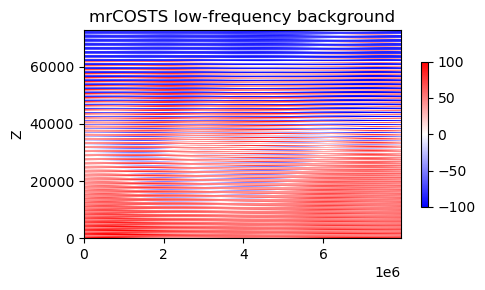

In [144]:
fig, ax = plt.subplots(figsize=(5, 3))
fig.set_tight_layout(True)
im = ax.pcolormesh(
    h_stacked.time,
    np.arange(len(h_stacked.z)), 
    xr_background, 
    vmin=-100, vmax=100, cmap="bwr",
    rasterized=True
)
ax.set_title("mrCOSTS low-frequency background")
ax.set_ylabel("Z")
# fig.autofmt_xdate()
fig.colorbar(im, shrink=.7)

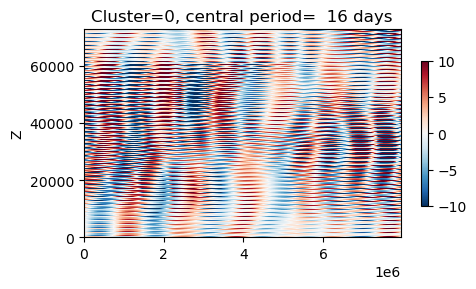

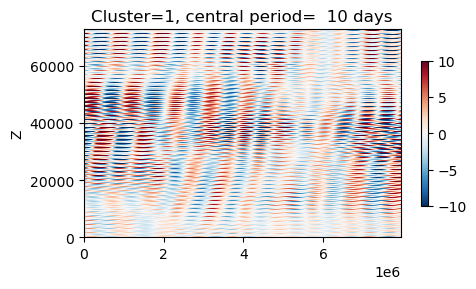

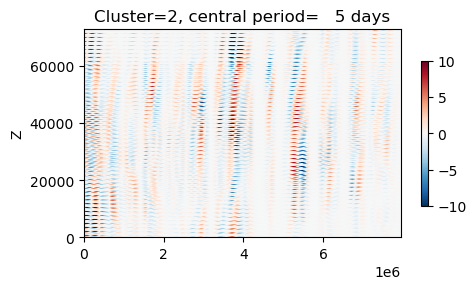

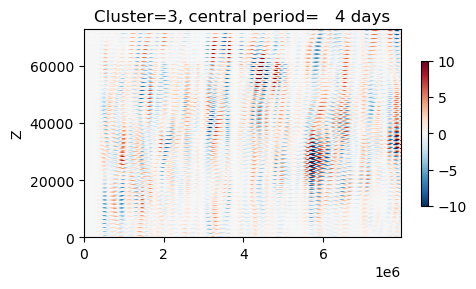

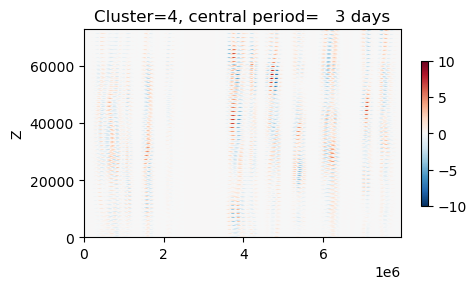

...

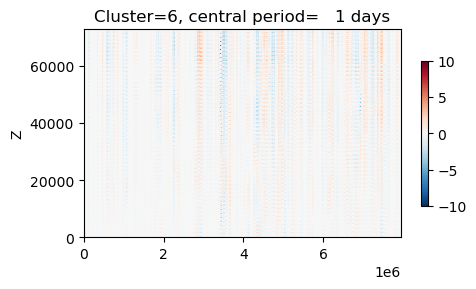

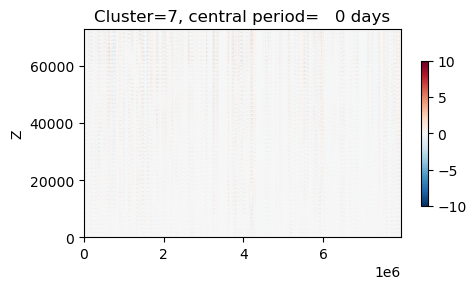

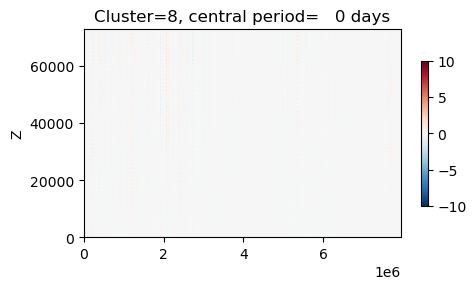

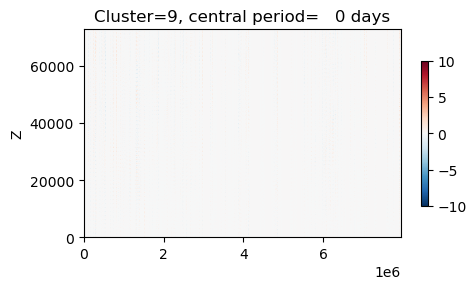

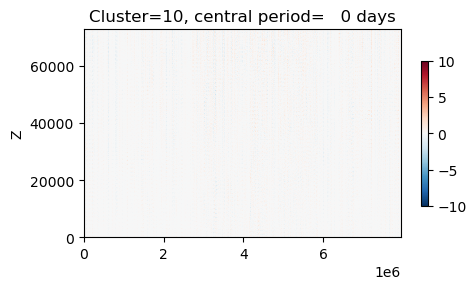

In [20]:
for ncl_center, cl_center in enumerate(cluster_centers_periods):
    
    if cl_center < (3600.*3)*2:  # Nyquist period
        continue
    
    fig, ax = plt.subplots(figsize=(5, 3))
    fig.set_tight_layout(True)
    im = ax.pcolormesh(
        h_stacked.time,
        np.arange(len(h_stacked.z)),
        xr_sep[:, ncl_center].sum(axis=0),
        vmin=-1e1,
        vmax=1e1,
        cmap="RdBu_r",
        rasterized=True,
    )
    ax.set_title(
        "Cluster={}, central period={:4.0f} days".format(ncl_center, cl_center/86400.)
    )
    ax.set_ylabel("Z")
    # fig.autofmt_xdate() 
    fig.colorbar(im, shrink=.7)
    plt.show()

In [21]:
ds_global_background = xr.DataArray(xr_background, dims=h_stacked.T.dims,
                                    coords=h_stacked.T.coords
                                   ).chunk({'time':1}).unstack()
ds_global_background.chunk(
#         {'lat':100, 'lon':100}
).to_dataset(name='background'
            ).to_zarr(op.join(sdir,
                'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/background.zarr' 
                              % (nh,xr_sep.shape[0],fscale)),
                              mode='w')

for ncl_center, cl_center in enumerate(cluster_centers_periods):
    
    ds_xr_sep = xr.DataArray(
        xr_sep.real[:, ncl_center],
        dims=["decomp_level", "z", "time"],
        coords=[
            np.arange(len(dmd.costs_array)),
            # np.arange(n_optimal),
            h_stacked.z,
            h_stacked.time,
        ],
    ).chunk({'time':1,'decomp_level':1}).unstack()
    
    # ds_xr_sep.isel(decomp_level=0).sum("cluster").plot(rasterized=True)
    ds_cluster_centers = xr.DataArray(
        np.array([1 / (10 ** (cluster_centroids[ncl_center]) / (2 * np.pi)),]),
        dims=["cluster"],
        # coords=[np.arange(n_optimal)],
        coords=[np.array([ncl_center,])],
    )
    ds_cluster_centers.attrs["units"] = "s"
    ds_cluster_centers.attrs["long_name"] = "Central period of each period band"
    
    ds_global_separation = ds_xr_sep.to_dataset(name="frequency_bands")
    ds_global_separation["frequency_bands"].attrs["units"] = "m"
    ds_global_separation["frequency_bands"].attrs["long_name"] = "mrCOSTS"
    
    ds_global_separation.coords["cluster_centers"] = ds_cluster_centers

    if ncl_center == 0:
        print(ds_global_separation)

    ds_global_separation.chunk(
        # {'lat':100, 'lon':100}
    ).to_zarr(op.join(sdir,
                'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/cluster%02d.zarr' 
                      % (nh, len(ds_global_separation.decomp_level), fscale, ncl_center)),
                      mode='w')
    print(ncl_center)
                                     
ds_global_separation

<xarray.Dataset>
Dimensions:          (lat: 260, lon: 280, decomp_level: 4, time: 736, cluster: 1)
Coordinates:
  * lat              (lat) int64 240 241 242 243 244 245 ... 495 496 497 498 499
  * lon              (lon) int64 223 224 225 226 227 228 ... 498 499 500 501 502
  * decomp_level     (decomp_level) int64 0 1 2 3
  * time             (time) float64 0.0 1.08e+04 ... 7.927e+06 7.938e+06
  * cluster          (cluster) int64 0
    cluster_centers  (cluster) float64 1.345e+06
Data variables:
    frequency_bands  (decomp_level, time, lat, lon) float64 dask.array<chunksize=(1, 1, 260, 280), meta=np.ndarray>
0
1
2
3
4
5
6
7
8
9
10
11


<xarray.Dataset>
Dimensions:          (lat: 260, lon: 280, decomp_level: 4, time: 736, cluster: 1)
Coordinates:
  * lat              (lat) int64 240 241 242 243 244 245 ... 495 496 497 498 499
  * lon              (lon) int64 223 224 225 226 227 228 ... 498 499 500 501 502
  * decomp_level     (decomp_level) int64 0 1 2 3
  * time             (time) float64 0.0 1.08e+04 ... 7.927e+06 7.938e+06
  * cluster          (cluster) int64 11
    cluster_centers  (cluster) float64 1.267e+04
Data variables:
    frequency_bands  (decomp_level, time, lat, lon) float64 dask.array<chunksize=(1, 1, 260, 280), meta=np.ndarray>

In [22]:
xr_global_reconstruction = dmd.global_reconstruction()
da_global_reconstruction = xr.DataArray(
    data=xr_global_reconstruction.real, dims=h_stacked.T.dims,
    coords=h_stacked.T.coords
).chunk({'time':1}).unstack()
da_global_reconstruction.attrs["units"] = "m"
da_global_reconstruction.attrs["long_name"] = r"HYCOM SSH"

In [23]:
da_global_reconstruction.chunk(
    # {'lat':100, 'lon':100}
).to_dataset(name='SSH').to_zarr(op.join(sdir,
                    'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/Total.zarr' 
                      % (nh,xr_sep.shape[0],fscale)),
                      mode='w')

In [23]:
nmn = 0
for nm, m in enumerate(dmd.costs_array):
    xr_low_frequency, xr_high_frequency = m.scale_separation()
    
    if nmn == 0:
        low = xr.DataArray(xr_low_frequency.T, dims=h_stacked.dims, 
                           coords=h_stacked.coords
                          ).unstack()
        hi = xr.DataArray(xr_high_frequency.T, dims=h_stacked.dims, 
                          coords=h_stacked.coords
                         ).unstack()
    else:
        low = xr.concat([low, xr.DataArray(xr_low_frequency.T, 
                                           dims=h_stacked.dims, 
                                           coords=h_stacked.coords
                                          ).unstack()
                        ], 'window')
        hi = xr.concat([hi, xr.DataArray(xr_high_frequency.T, 
                                         dims=h_stacked.dims, 
                                         coords=h_stacked.coords
                                        ).unstack()
                       ], 'window')
    nmn += 1

dsave = low.to_dataset(name='low')
dsave['high'] = hi
dsave.coords['window'] = window_lengths*nh*3600.
print(dsave)
dsave.to_zarr(op.join(sdir,
                'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/enumeration.zarr' 
                      % (nh,len(window_lengths),fscale)), mode='w'
             )

<xarray.Dataset>
Dimensions:  (lat: 260, lon: 280, time: 736, window: 4)
Coordinates:
  * lat      (lat) int64 240 241 242 243 244 245 246 ... 494 495 496 497 498 499
  * lon      (lon) int64 223 224 225 226 227 228 229 ... 497 498 499 500 501 502
  * time     (time) float64 0.0 1.08e+04 2.16e+04 ... 7.927e+06 7.938e+06
  * window   (window) float64 8.64e+04 1.728e+05 6.912e+05 2.592e+06
Data variables:
    low      (window, time, lat, lon) float64 35.32 34.07 ... -76.85 -79.07
    high     (window, time, lat, lon) float64 -0.5363 -0.5693 ... 7.337 7.646


In [28]:
for i in range(12):
    if i == 0:
        dsc3 = xr.open_zarr(op.join(sdir,
            'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/cluster%02d.zarr' 
                           % (3,4,fscale,i))
                          )
        dsc12 = xr.open_zarr(op.join(sdir,
            'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/cluster%02d.zarr' 
                           % (12,3,fscale,i))
                          )
    else:
        try:
            dsc3 = xr.concat([dsc3,xr.open_zarr(op.join(sdir,
                'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/cluster%02d.zarr' 
                               % (3,4,fscale,i)))
                            ], 'cluster')
            dsc12 = xr.concat([dsc12,xr.open_zarr(op.join(sdir,
                'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/cluster%02d.zarr' 
                               % (12,3,fscale,i)))
                            ], 'cluster')
        except:
            pass
    
dsC3 = xr.open_zarr(op.join(sdir,
            'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/Total.zarr' 
                           % (3,4,fscale))
                  )
dsC12 = xr.open_zarr(op.join(sdir,
            'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/Total.zarr' 
                           % (12,3,fscale))
                  )
dsc3

<xarray.Dataset>
Dimensions:          (cluster: 12, decomp_level: 4, time: 736, lat: 260,
                      lon: 280)
Coordinates:
  * cluster          (cluster) int64 0 1 2 3 4 5 6 7 8 9 10 11
    cluster_centers  (cluster) float64 dask.array<chunksize=(1,), meta=np.ndarray>
  * decomp_level     (decomp_level) int64 0 1 2 3
  * lat              (lat) int64 240 241 242 243 244 245 ... 495 496 497 498 499
  * lon              (lon) int64 223 224 225 226 227 228 ... 498 499 500 501 502
  * time             (time) float64 0.0 1.08e+04 ... 7.927e+06 7.938e+06
Data variables:
    frequency_bands  (cluster, decomp_level, time, lat, lon) float64 dask.array<chunksize=(1, 1, 1, 260, 280), meta=np.ndarray>

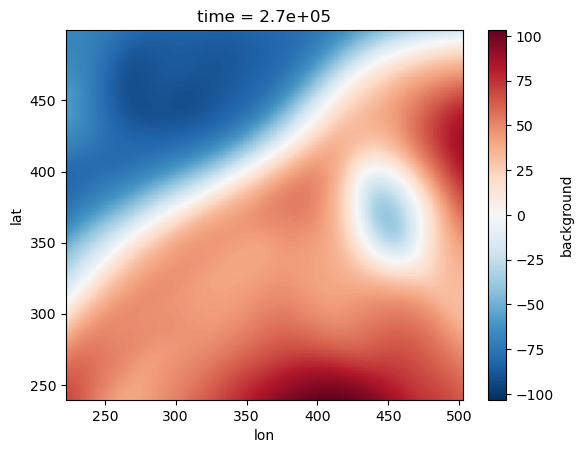

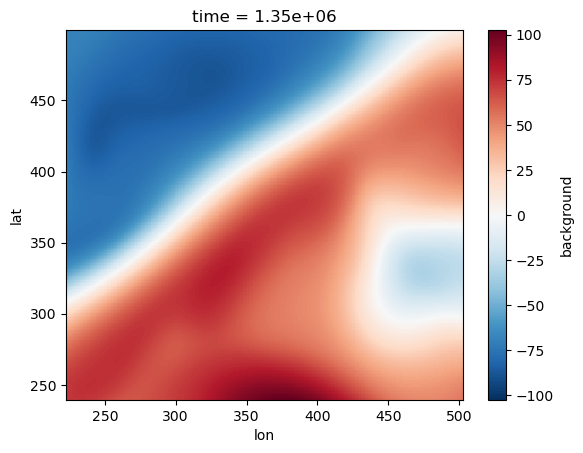

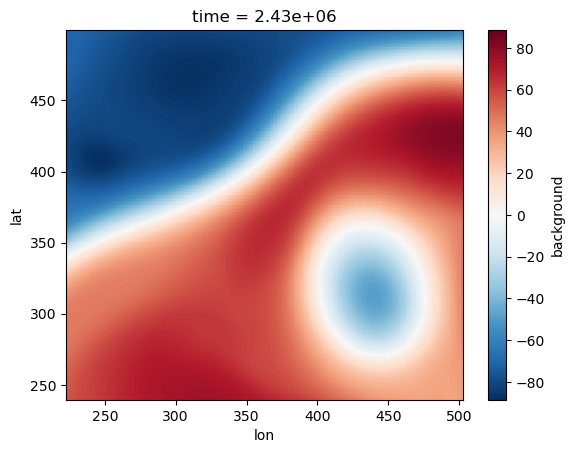

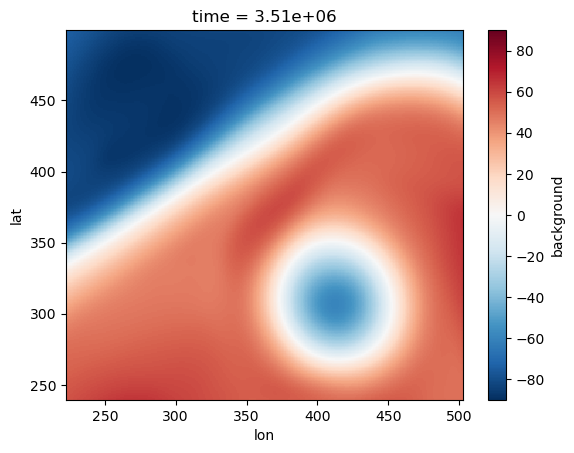

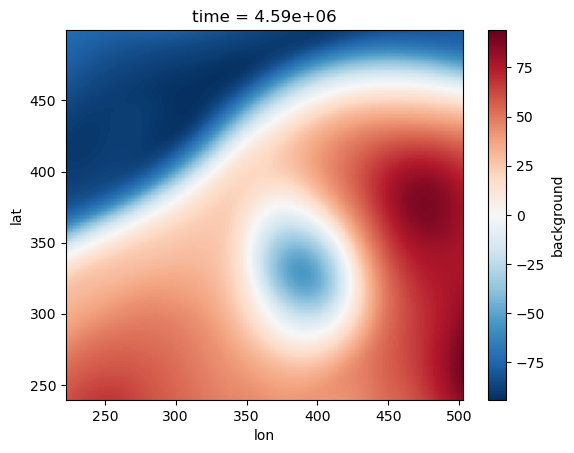

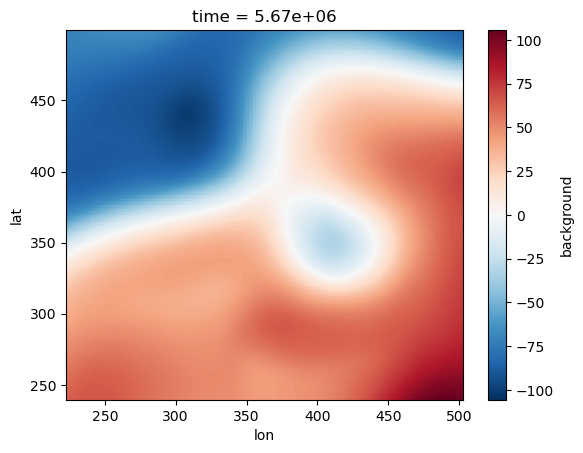

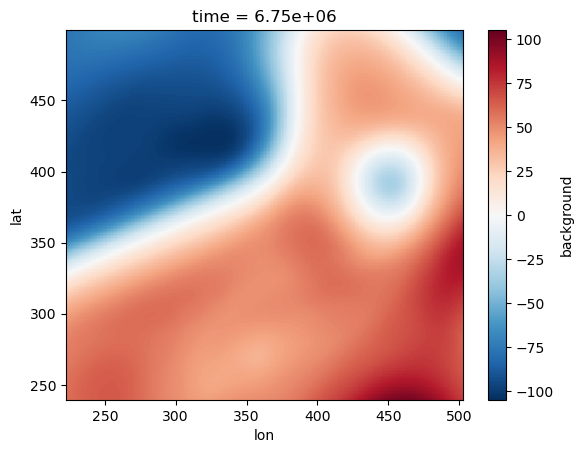

In [29]:
bg3 = xr.open_zarr(op.join(sdir,
            'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/background.zarr' 
                          % (3,4,fscale))
                 ).background
bg12 = xr.open_zarr(op.join(sdir,
            'HYCOM50/ASO/mrCOSTS_h/%02dhourly/%02d-recons_%02dkm/background.zarr' 
                          % (12,3,fscale))
                 ).background

for tt in np.arange(0,len(dsc3.time)-50,100):
    bg3.isel(time=slice(25,-25)).isel(time=tt).plot(rasterized=True)
    plt.show()

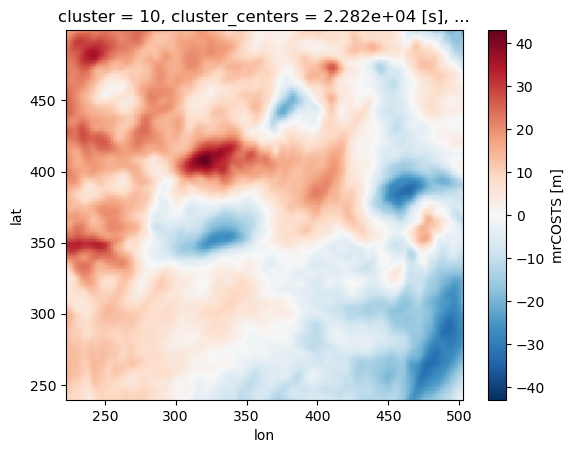

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


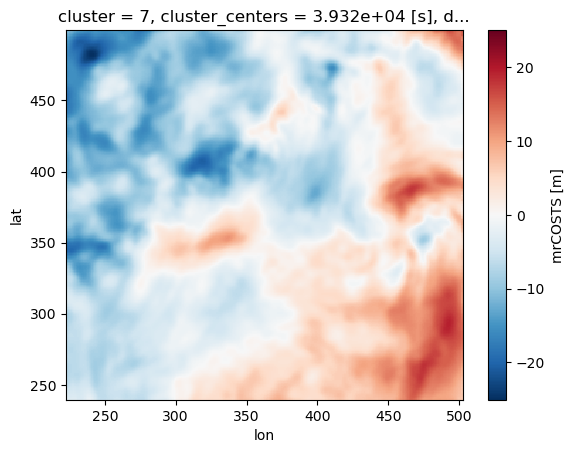

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1


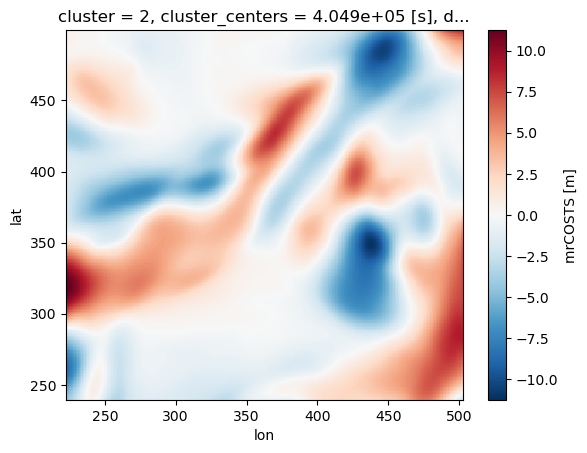

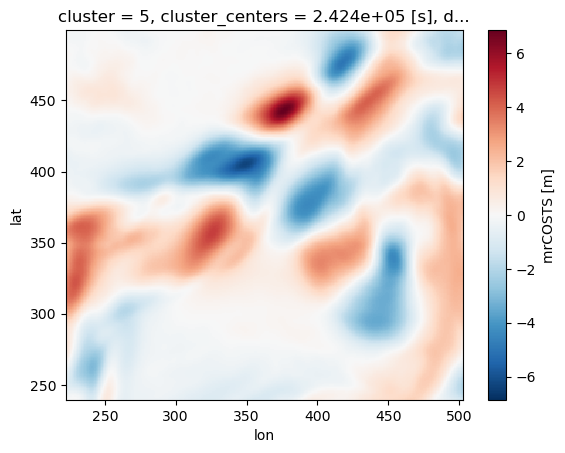

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(2)
Coordinates:
    decomp_level  int64 2


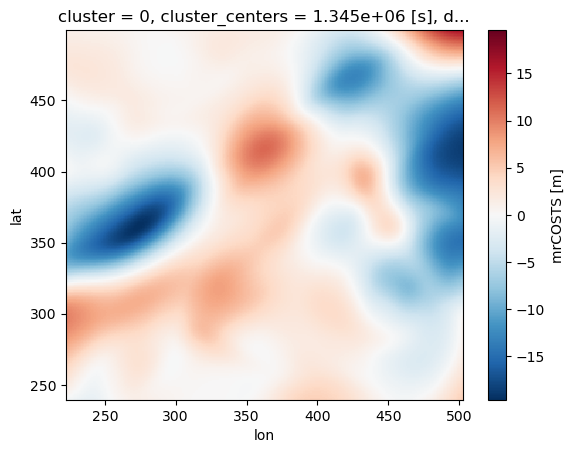

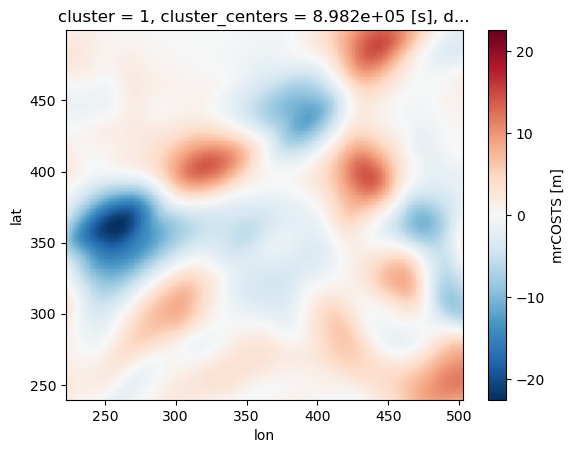

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(3)
Coordinates:
    decomp_level  int64 3
########## TIME: 0


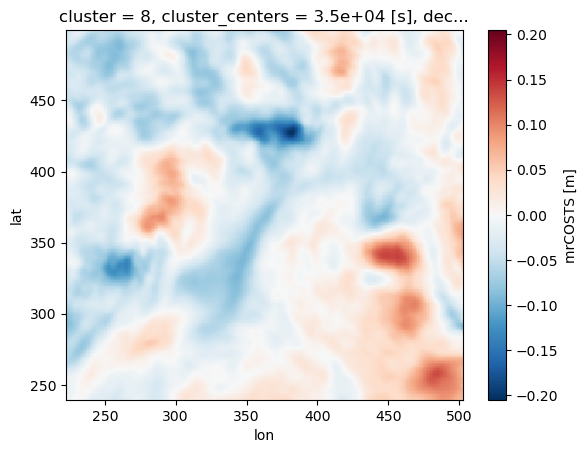

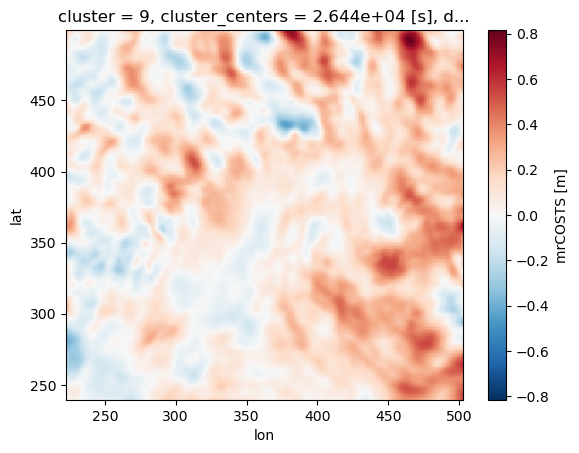

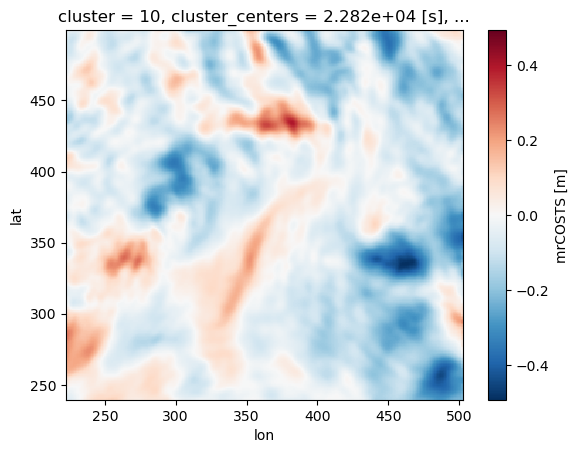

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


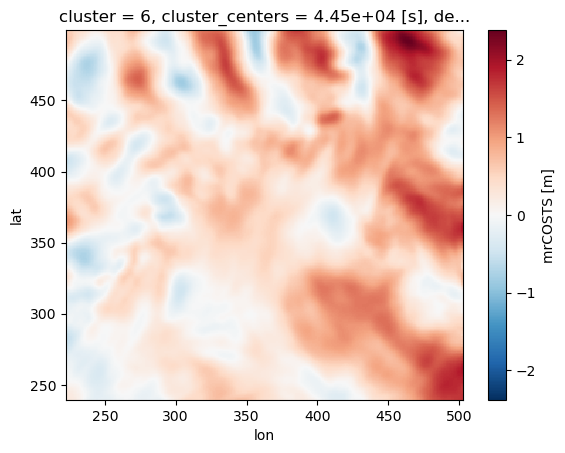

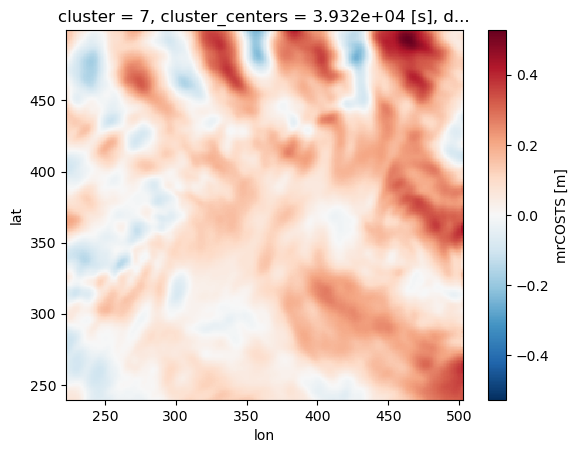

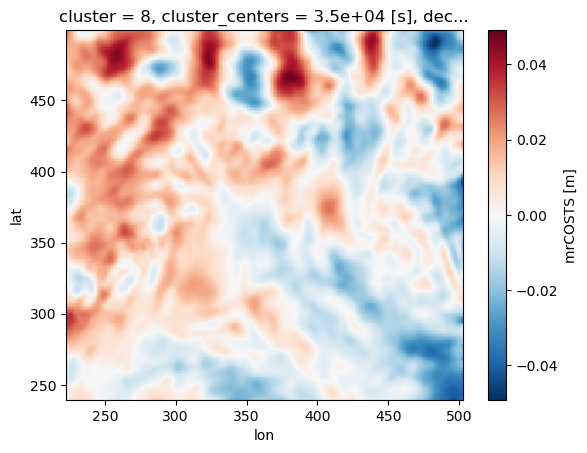

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1


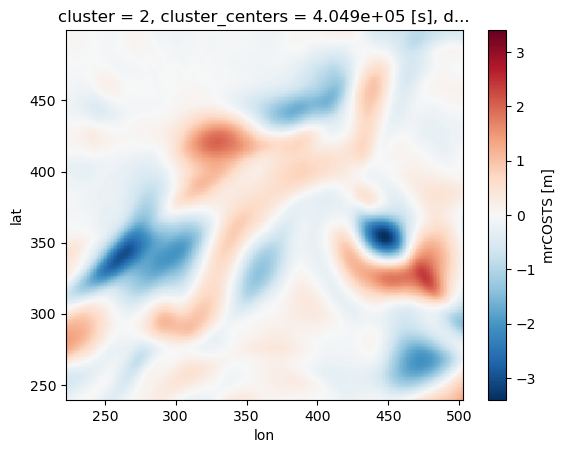

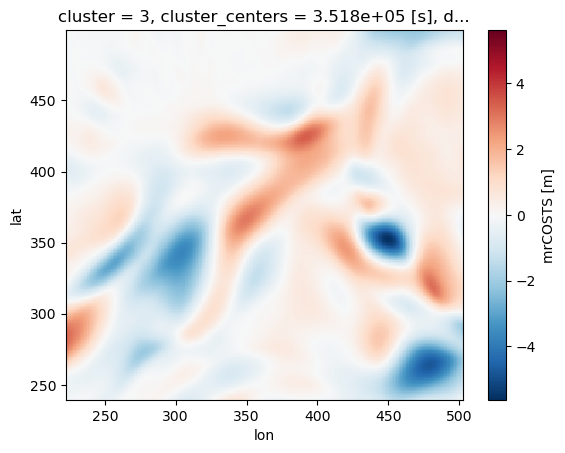

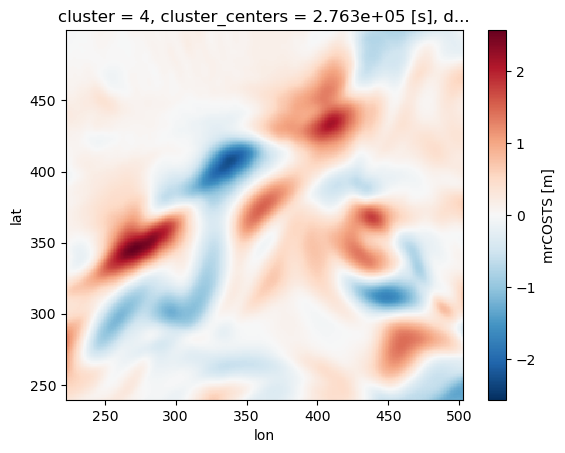

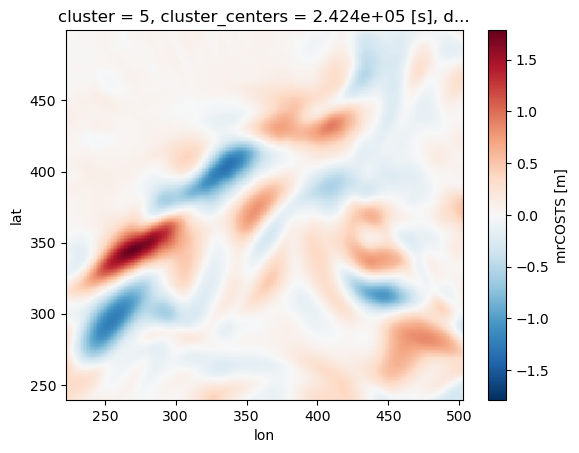

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(2)
Coordinates:
    decomp_level  int64 2


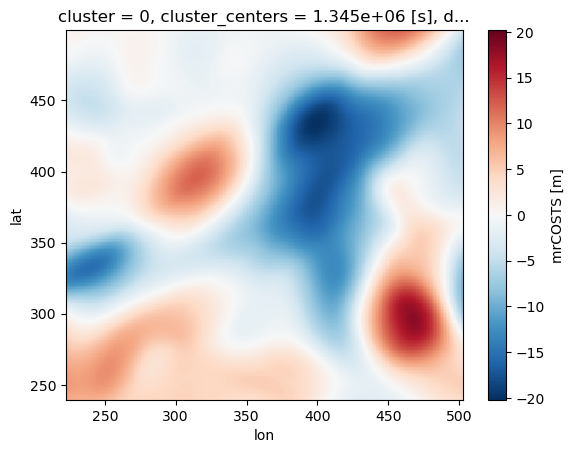

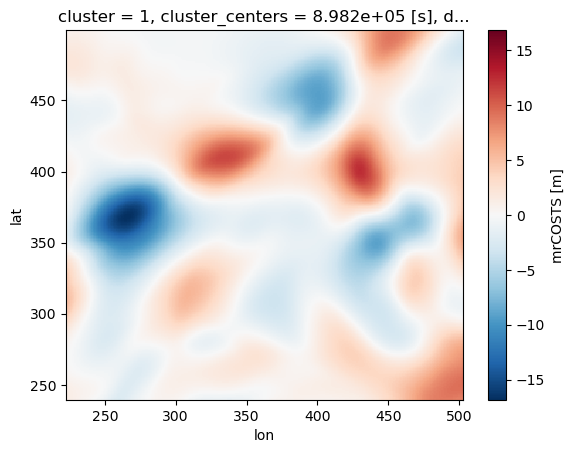

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(3)
Coordinates:
    decomp_level  int64 3
########## TIME: 100


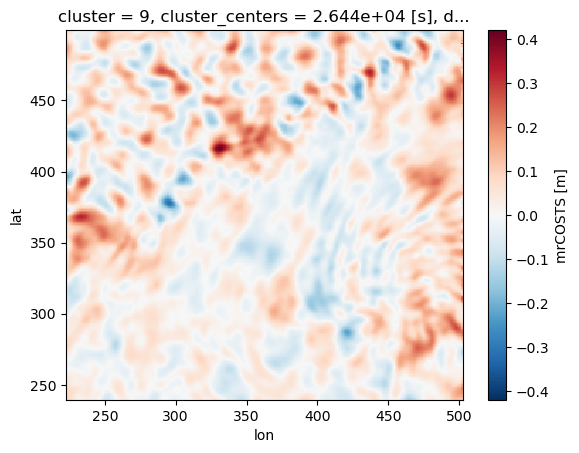

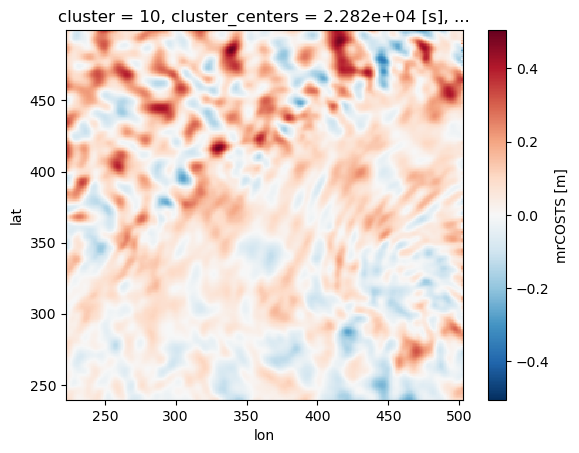

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


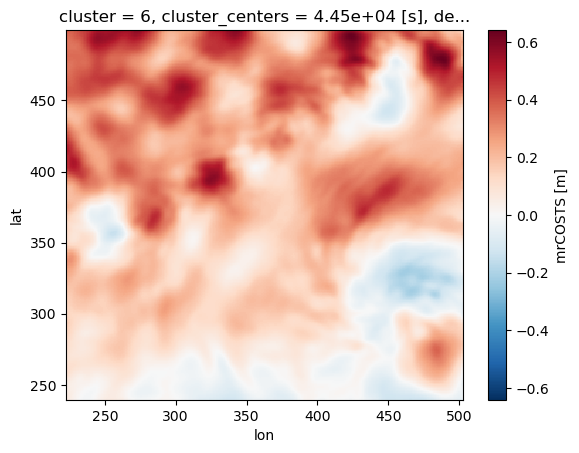

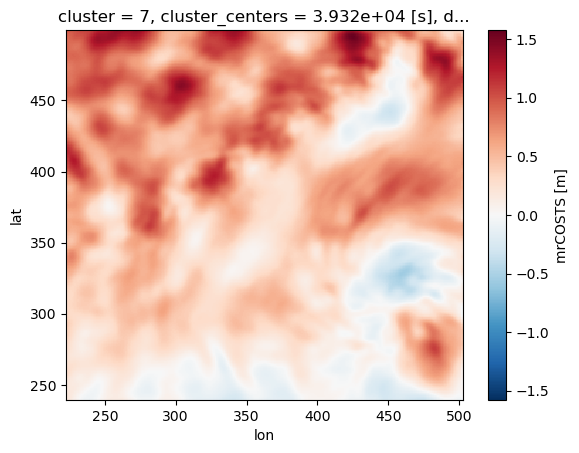

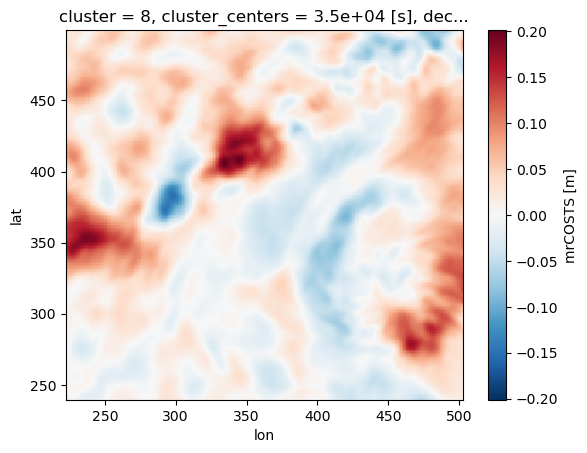

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1


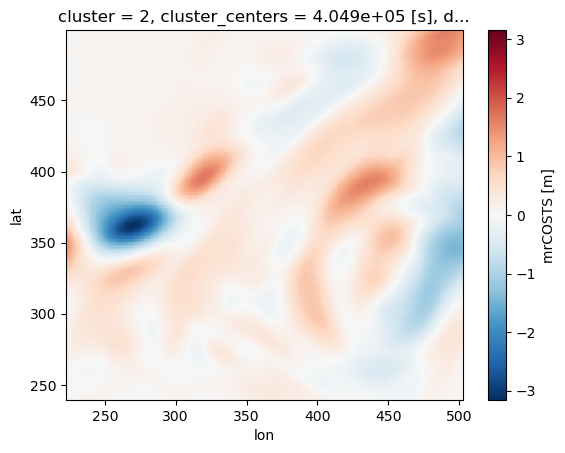

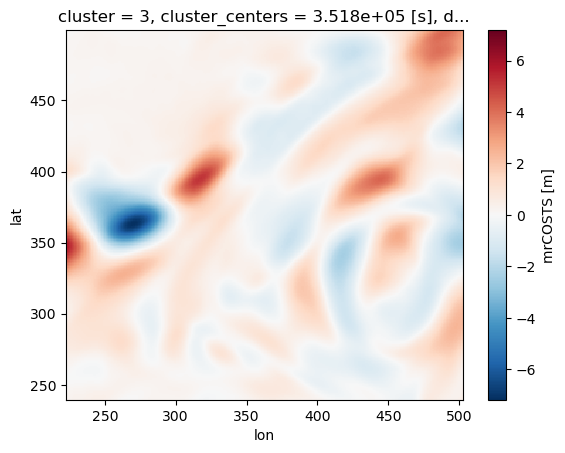

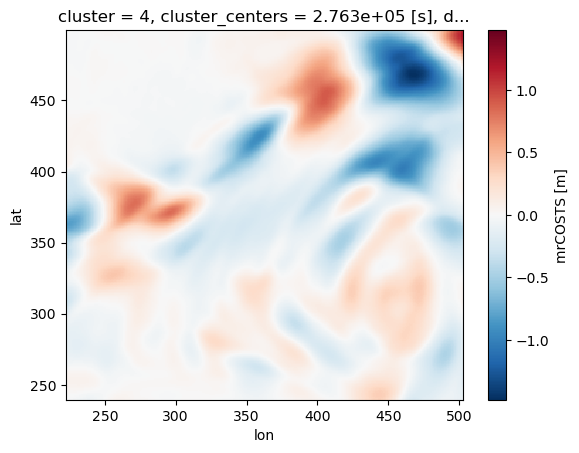

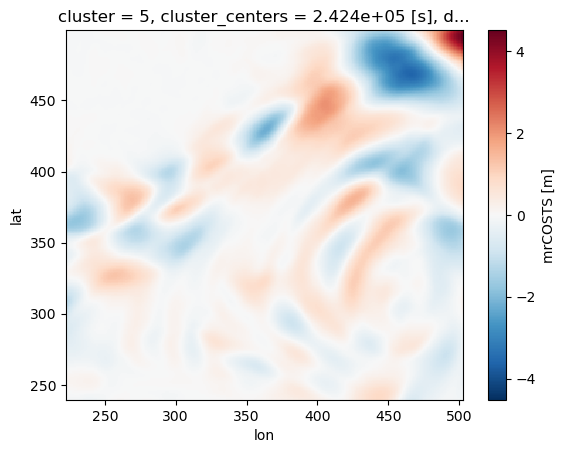

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(2)
Coordinates:
    decomp_level  int64 2


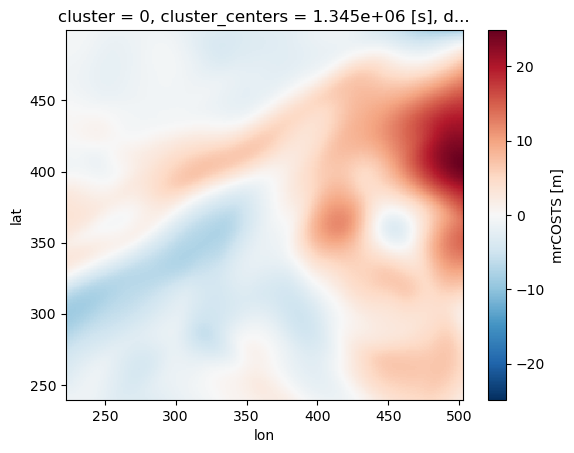

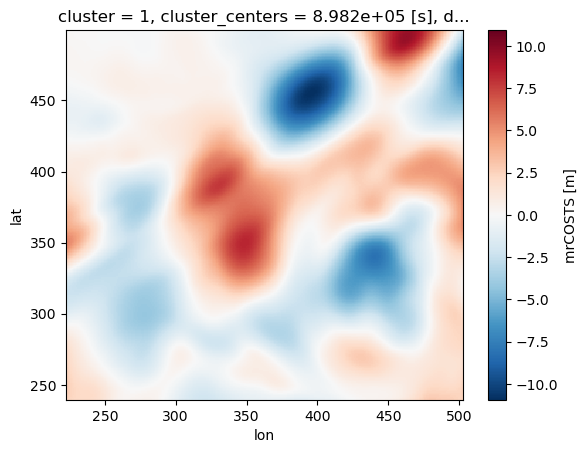

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(3)
Coordinates:
    decomp_level  int64 3
########## TIME: 200


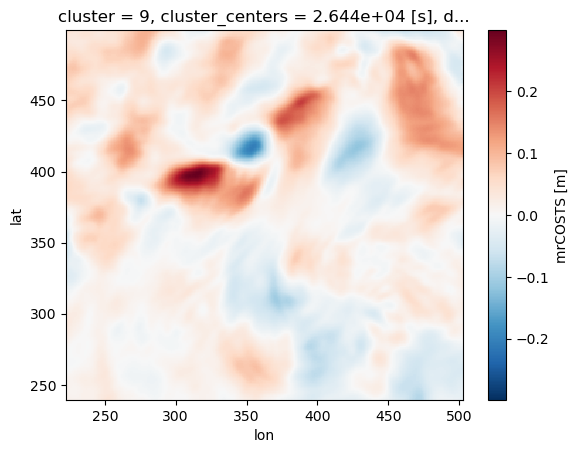

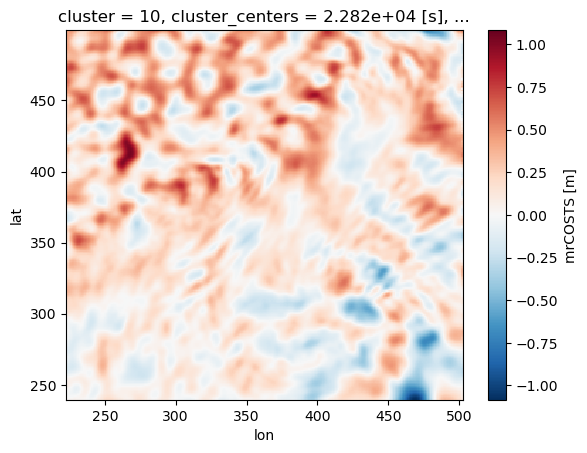

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


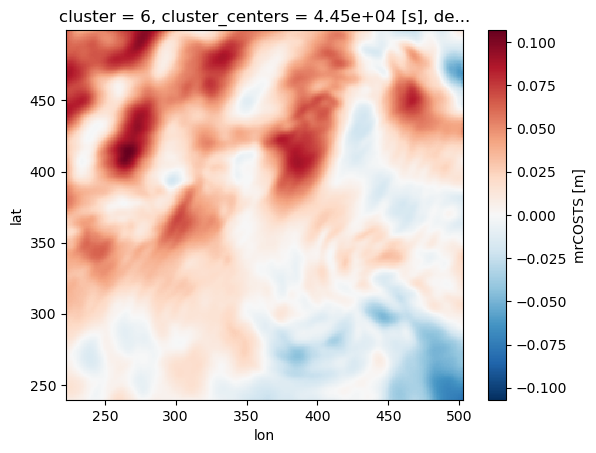

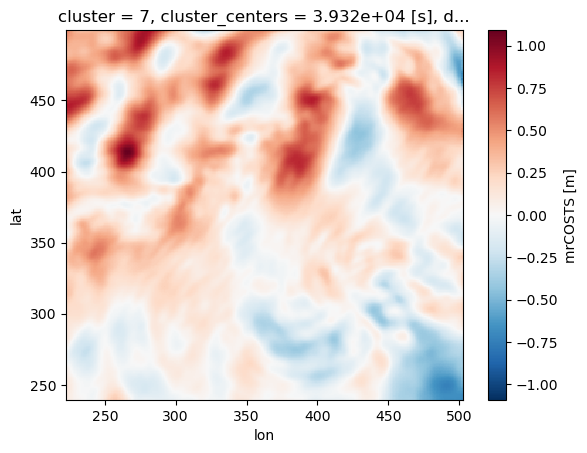

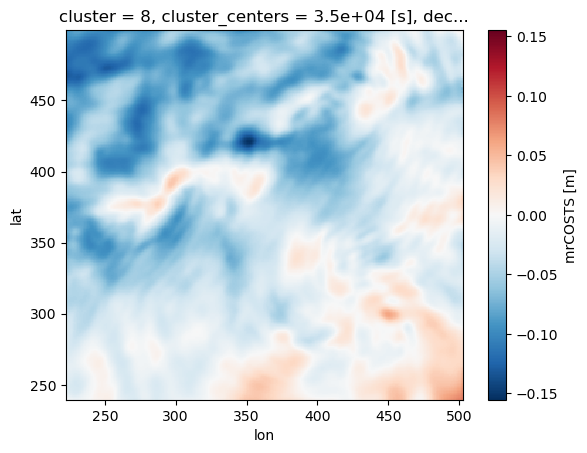

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1


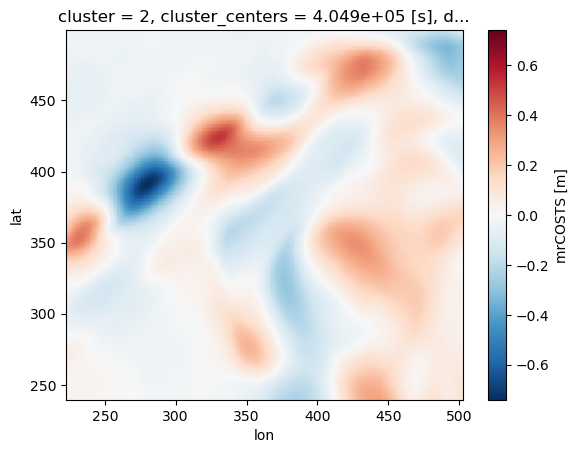

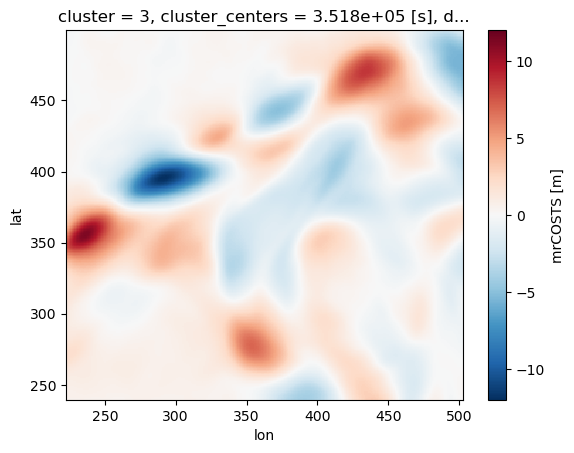

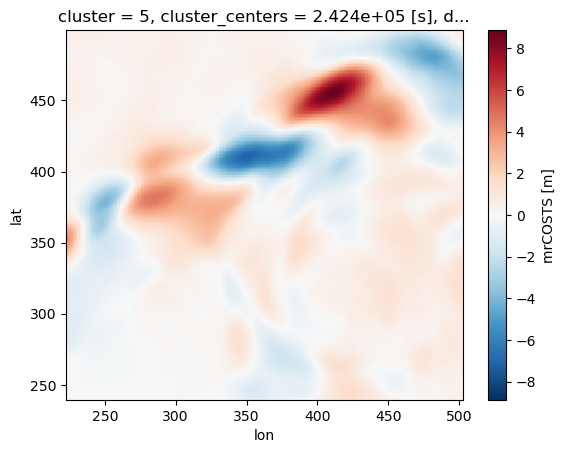

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(2)
Coordinates:
    decomp_level  int64 2


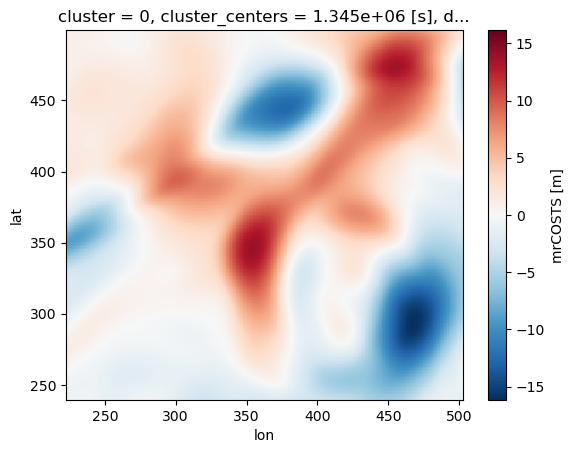

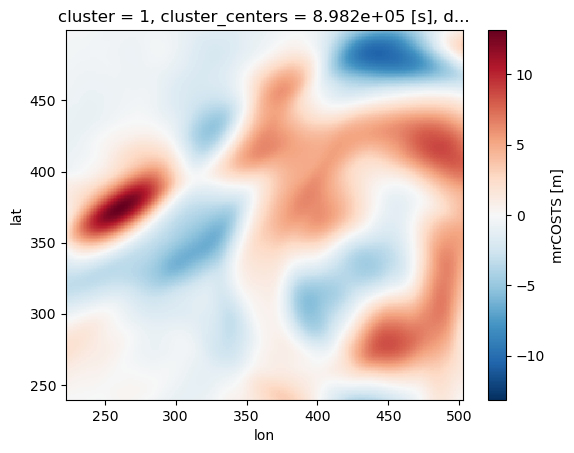

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(3)
Coordinates:
    decomp_level  int64 3
########## TIME: 300


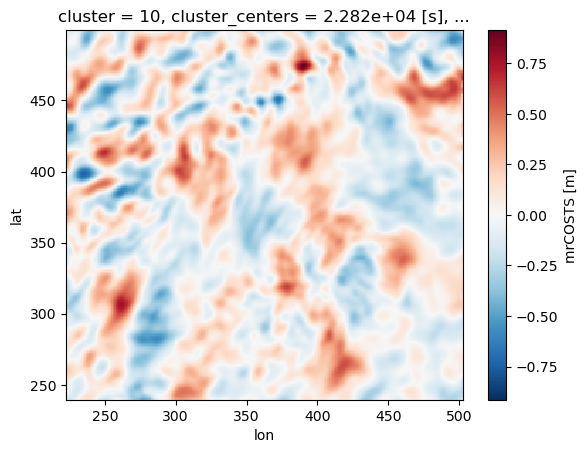

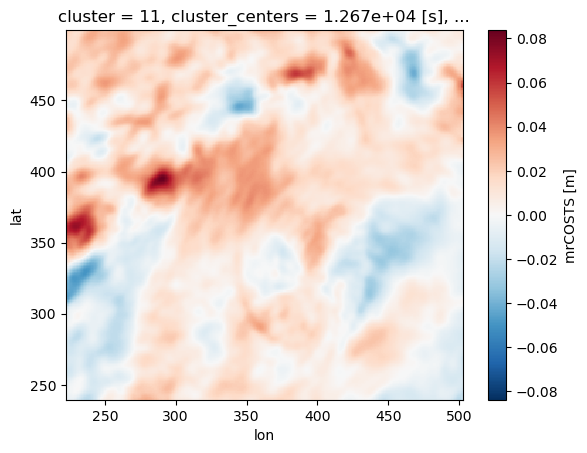

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


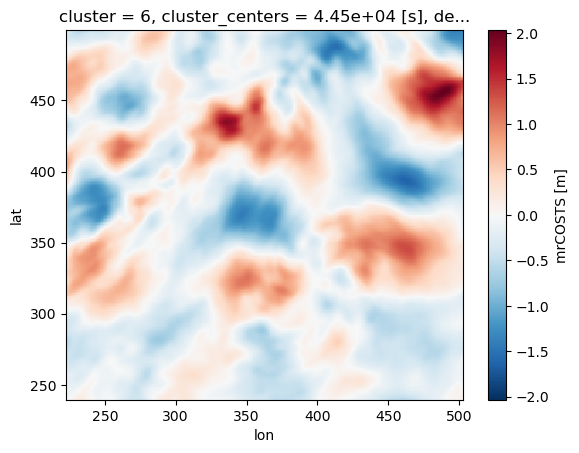

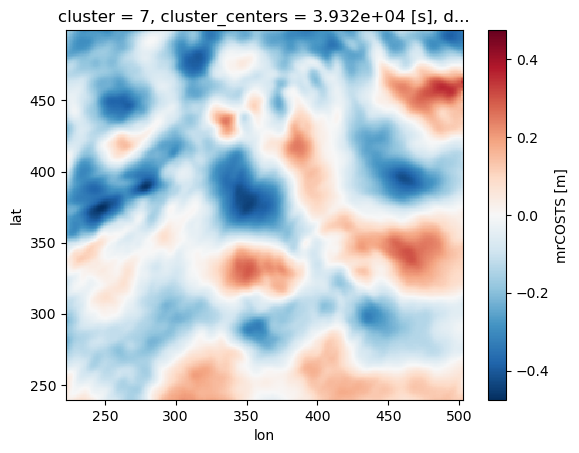

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1


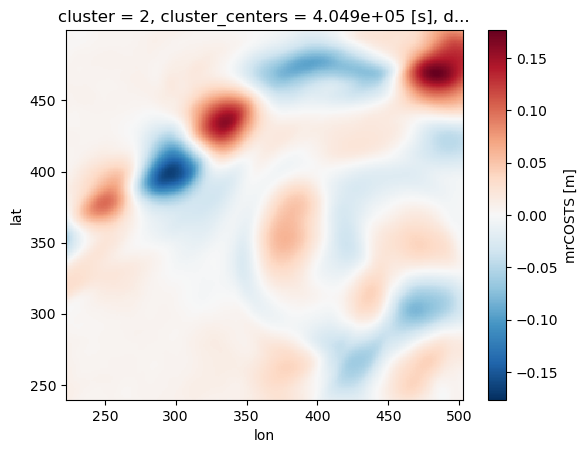

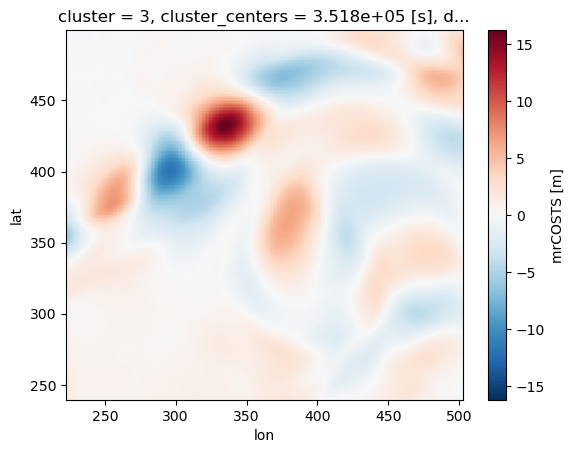

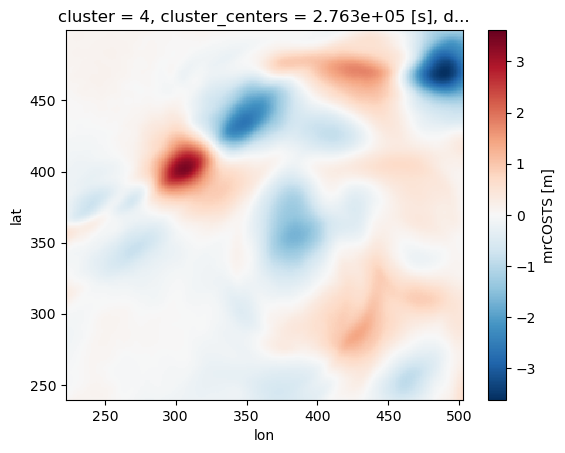

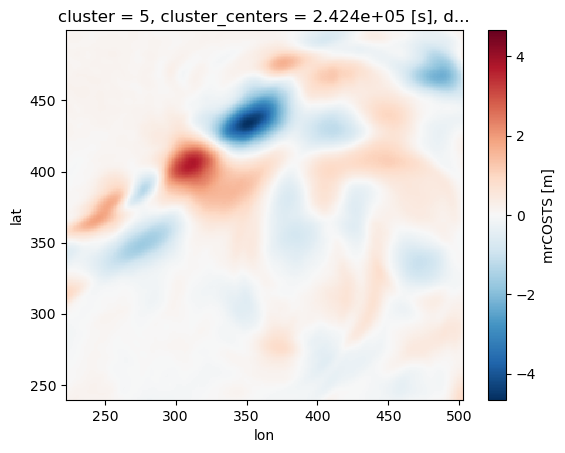

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(2)
Coordinates:
    decomp_level  int64 2


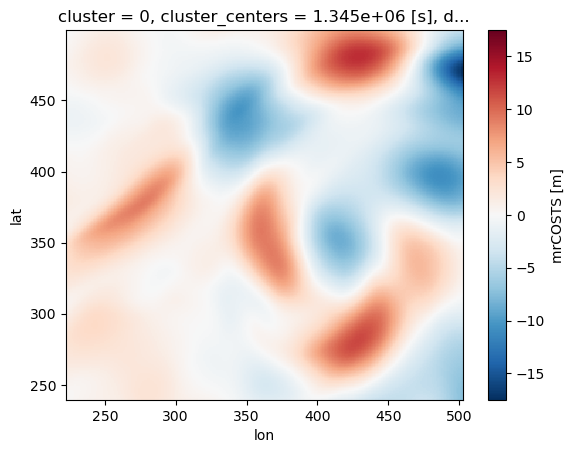

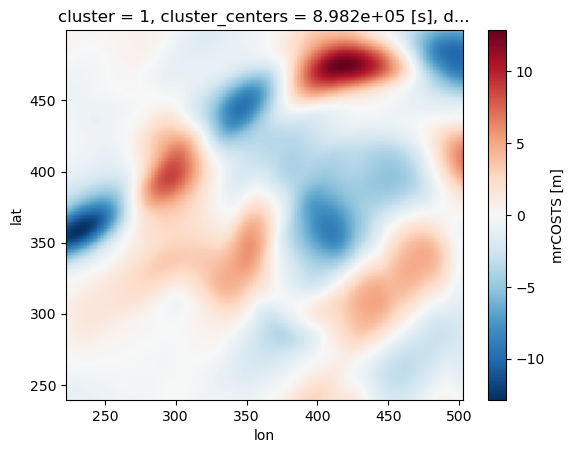

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(3)
Coordinates:
    decomp_level  int64 3
########## TIME: 400


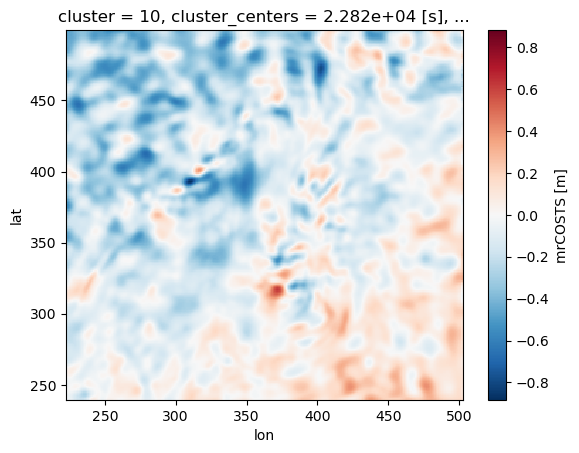

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


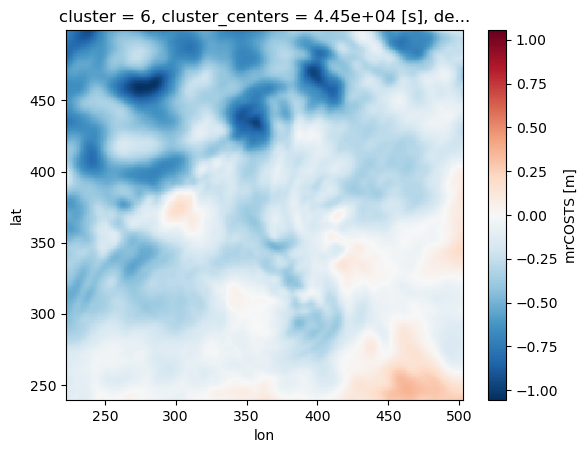

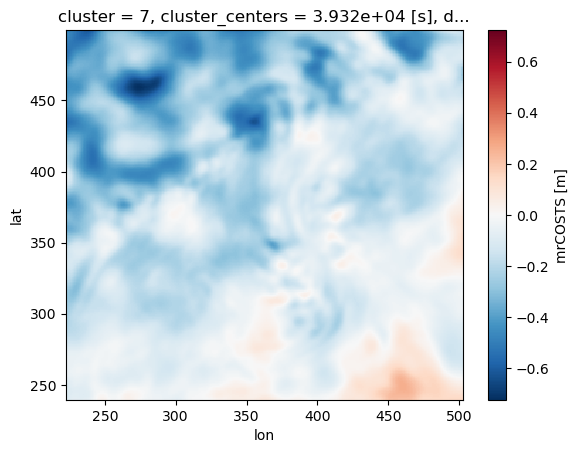

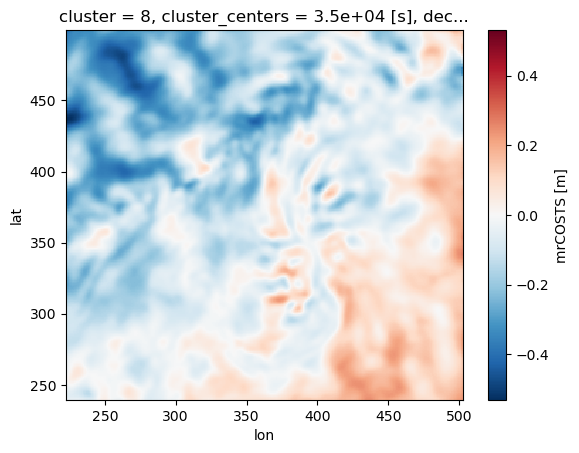

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1


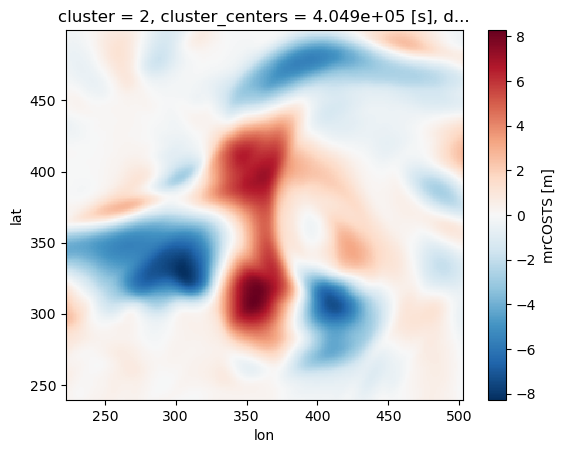

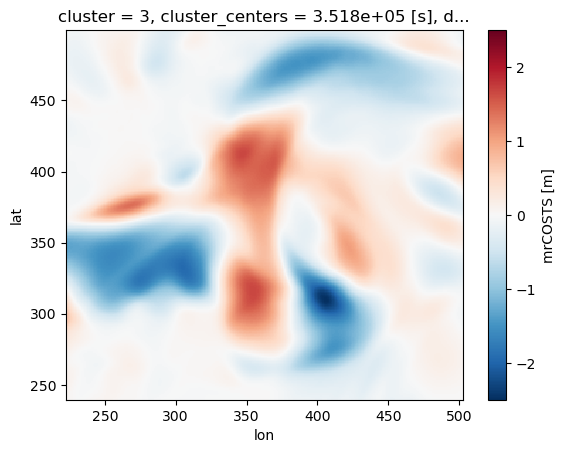

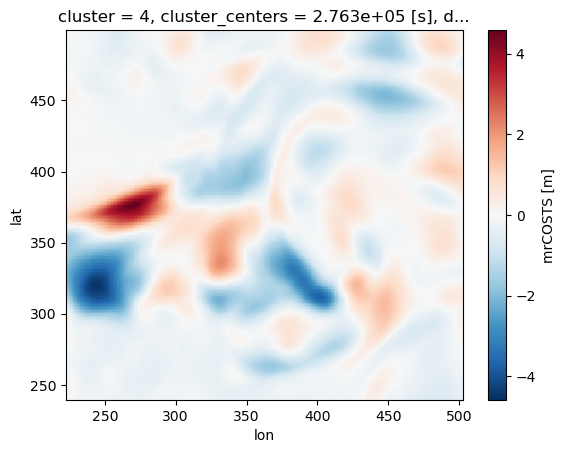

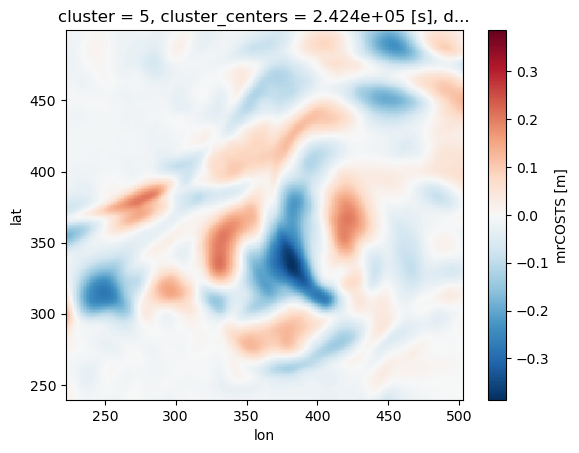

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(2)
Coordinates:
    decomp_level  int64 2


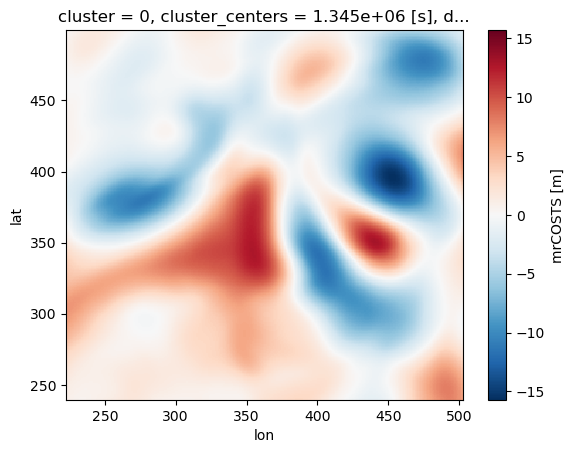

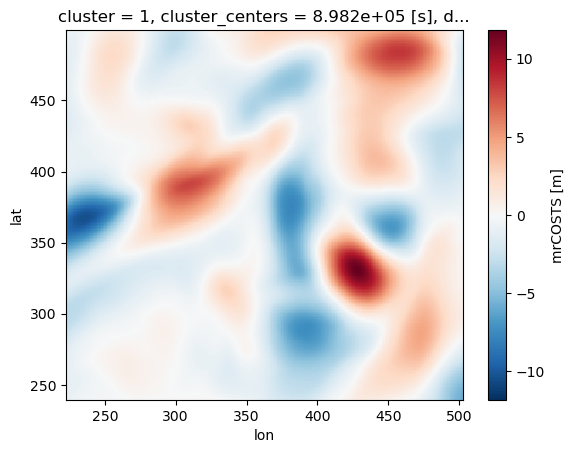

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(3)
Coordinates:
    decomp_level  int64 3
########## TIME: 500


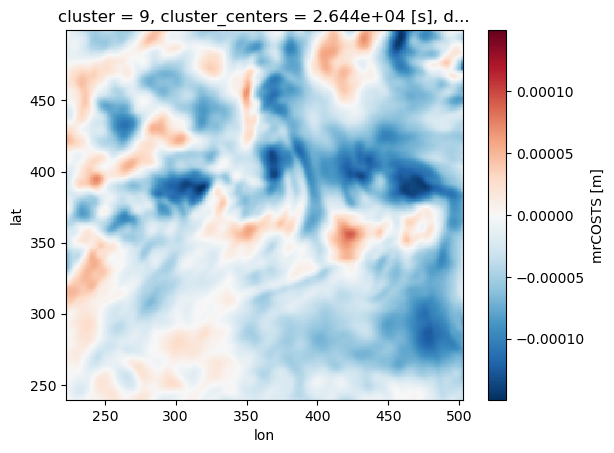

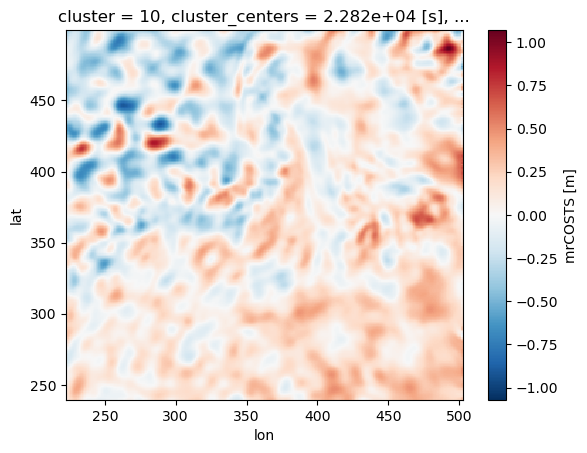

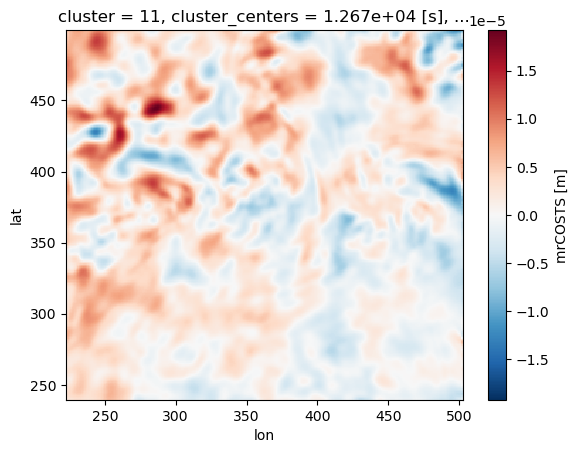

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


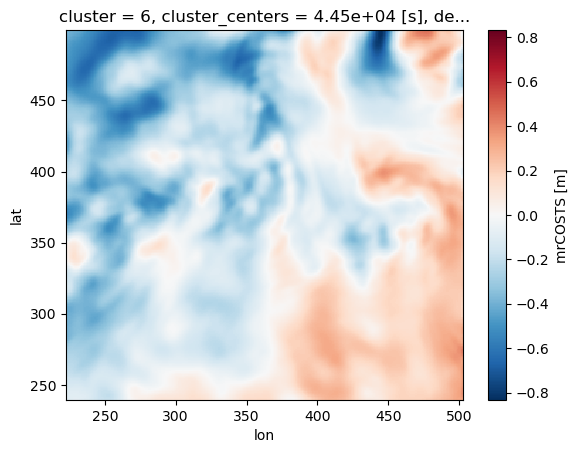

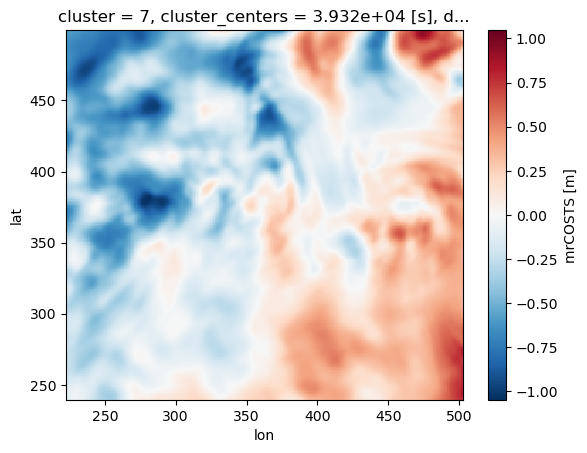

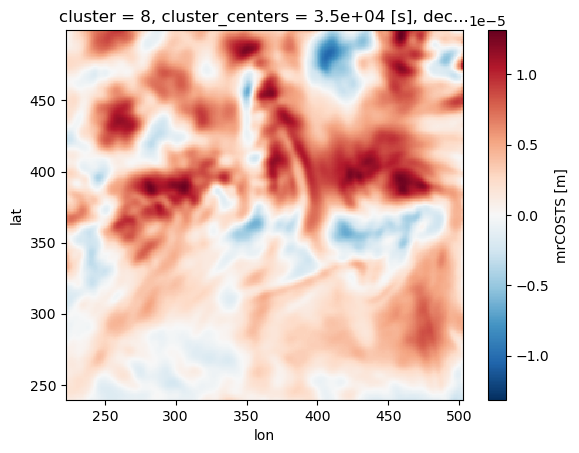

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1


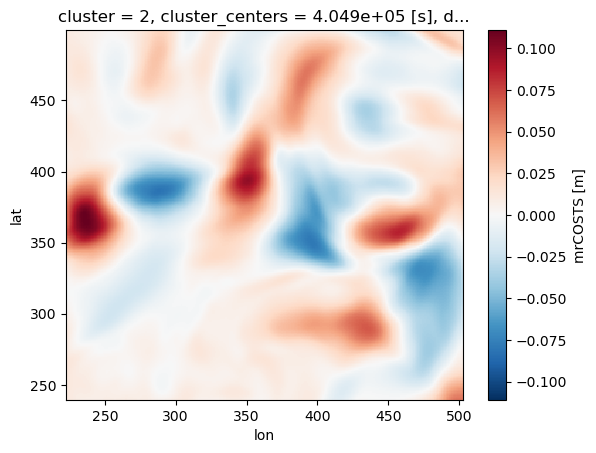

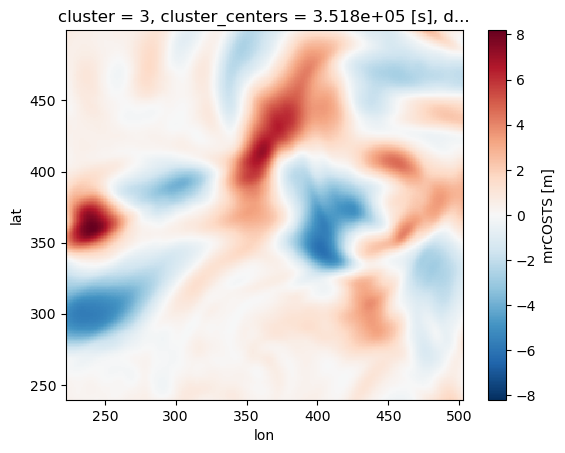

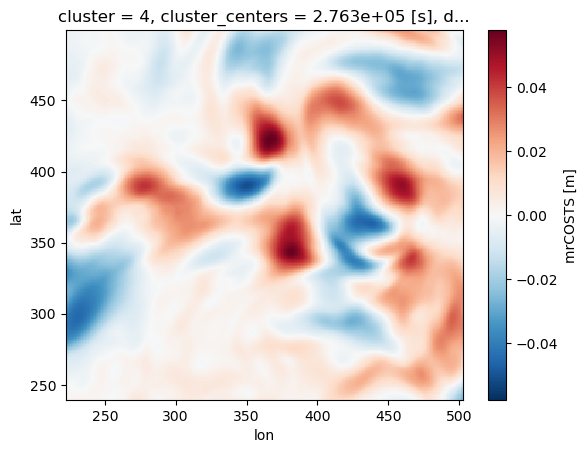

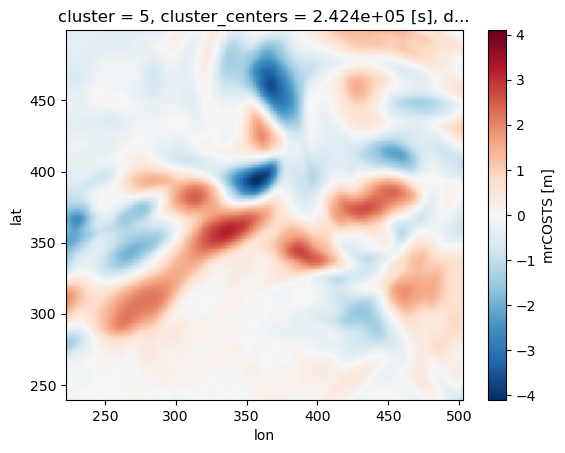

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(2)
Coordinates:
    decomp_level  int64 2


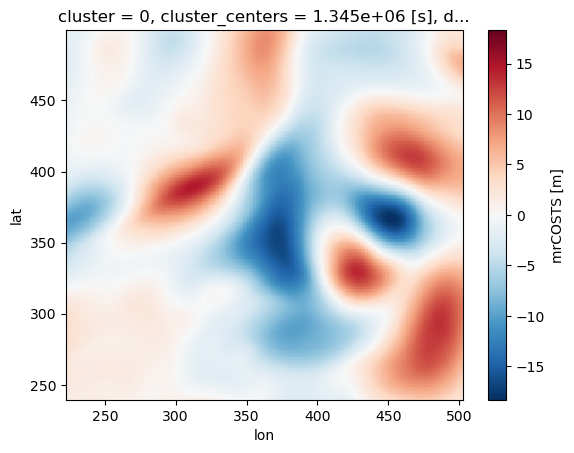

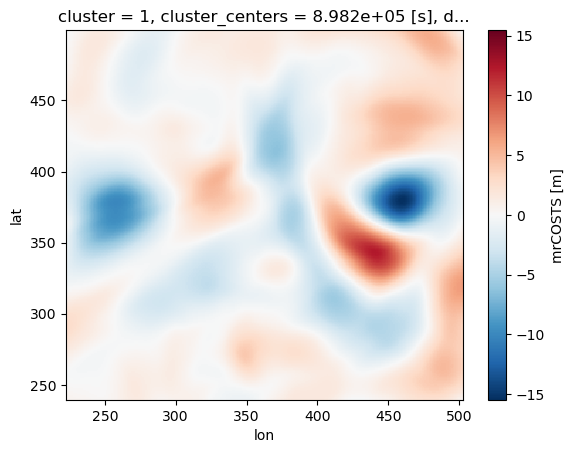

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(3)
Coordinates:
    decomp_level  int64 3
########## TIME: 600


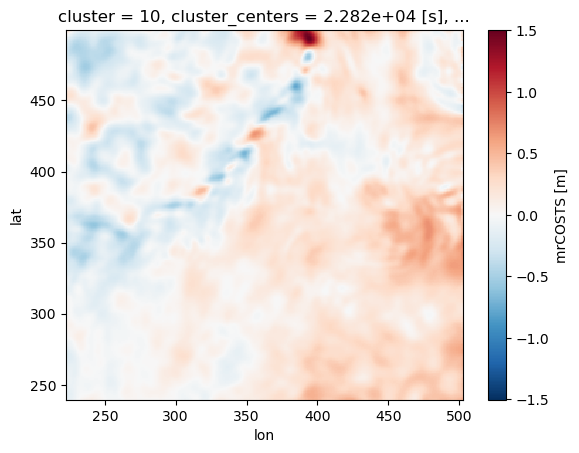

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


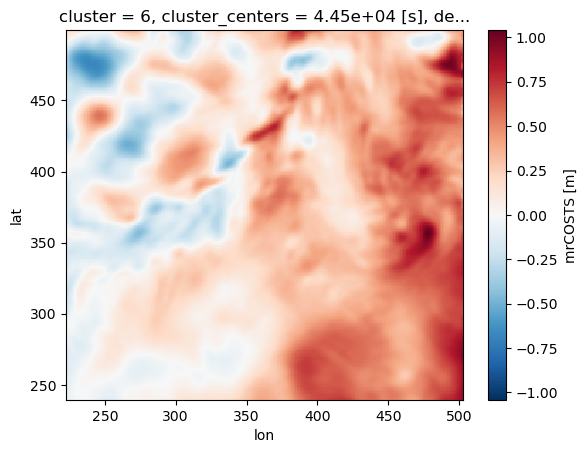

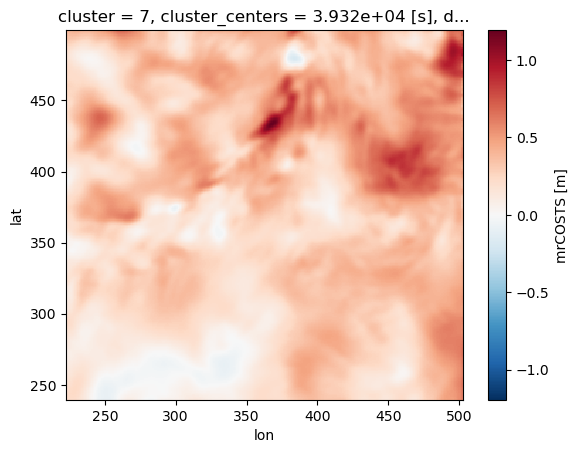

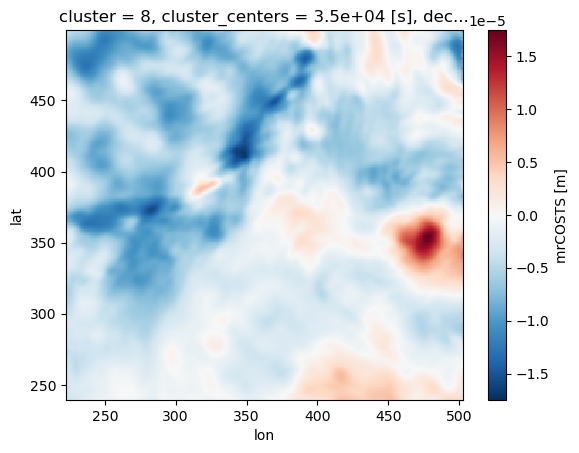

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1


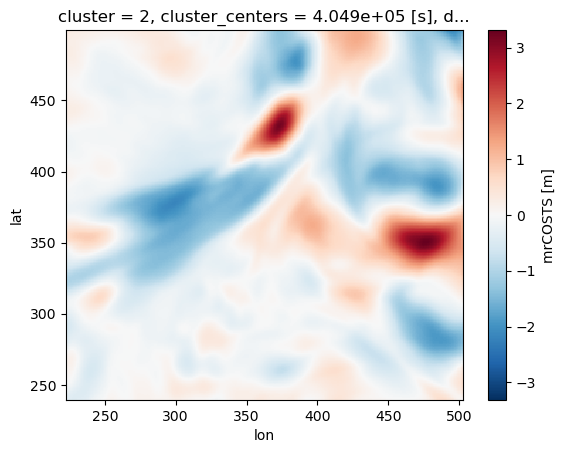

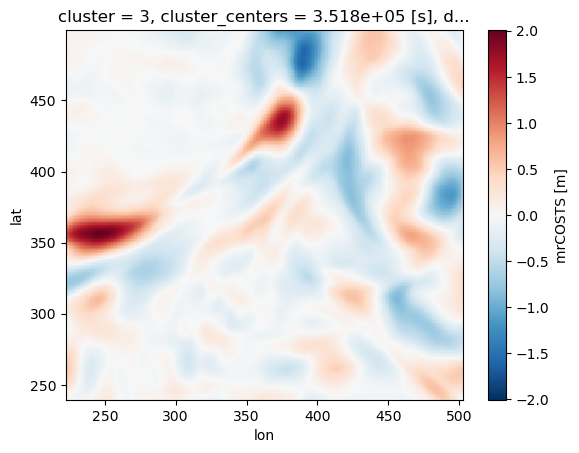

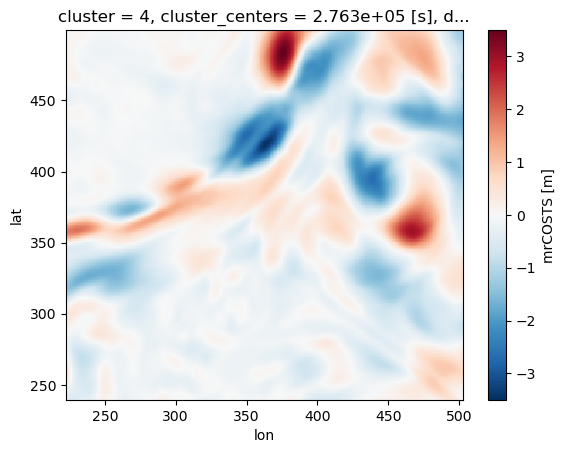

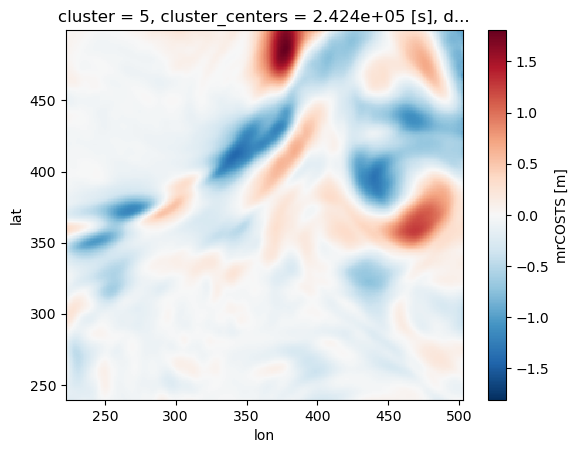

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(2)
Coordinates:
    decomp_level  int64 2


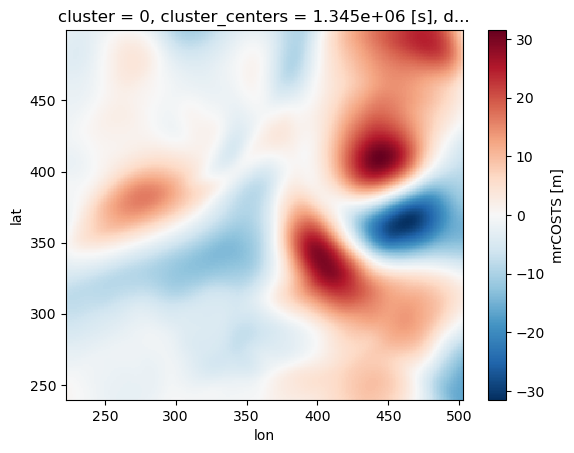

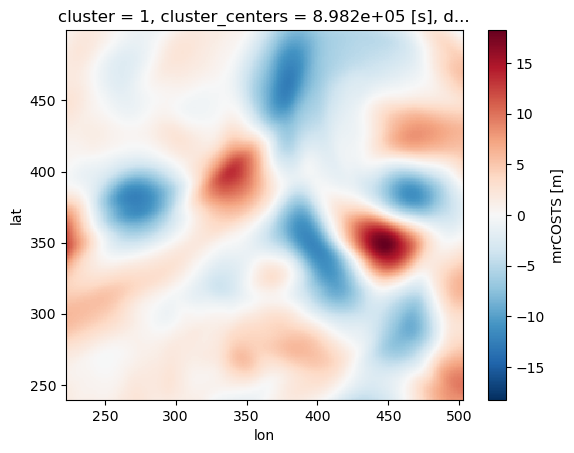

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(3)
Coordinates:
    decomp_level  int64 3
########## TIME: 700


In [23]:
for tt in np.arange(0,len(dsc.time),100):
    for i in dsc.decomp_level:
        
        for j in dsc.cluster:
            if dsc.frequency_bands.sel(decomp_level=i, cluster=j
                                      ).isel(time=tt).sum() != 0.:
                dsc.frequency_bands.sel(decomp_level=i, cluster=j
                                       ).isel(time=tt).plot(rasterized=True)
                plt.show()
            
        print("########## DECOMP:",i)
    print("########## TIME:",tt)
        
    # if i == 0:
    #     low = dsc.frequency_bands.sel(decomp_level=i
    #                      ).where(ds_global_separation.frequency_bands.sel(
    #                                                         decomp_level=i
    #                                                                      ) != 0.,
    #                             drop=True).isel(cluster=slice(None,2)
    #                                            ).sum('cluster',skipna=True)
    # else:
    #     low = xr.concat([low, 
    #                      dsc.frequency_bands.sel(decomp_level=i
    #                      ).where(ds_global_separation.frequency_bands.sel(
    #                                                         decomp_level=i
    #                                                                      ) != 0.,
    #                             drop=True).isel(cluster=slice(None,2)
    #                                            ).sum('cluster',skipna=True)
    #                     ], 'decomp_level')
      
# low = low.sum('decomp_level') + bg
# low

In [38]:
# grid info centered at T-points
dxT = xr.DataArray(hycom50_grids.pscx.data, dims=hycom01s.ssh.isel(time=0).dims, 
                   coords=hycom01s.ssh.isel(time=0).coords
                  ).reset_coords(drop=True).min()
dyT = xr.DataArray(hycom50_grids.pscy.data, dims=hycom01s.ssh.isel(time=0).dims, 
                   coords=hycom01s.ssh.isel(time=0).coords
                  ).reset_coords(drop=True).min()
modes = dsc.frequency_bands.assign_coords(lon=np.arange(0, len(dsc.lon)*dxT, dxT)
                                         ).assign_coords(lat=np.arange(0, len(dsc.lat)*dyT, dyT)
                                                        ).isel(time=slice(25,-25))
Fcluster = xrft.power_spectrum(modes.chunk({'time':-1}), 
                               dim='time', detrend='linear', 
                               window='hann', window_correction=True)
Fcluster = xrft.isotropic_power_spectrum(Fcluster.chunk({'freq_time':1,'lat':-1,'lon':-1}), dim=['lat','lon'], 
                                         detrend='constant', window='hann', window_correction=True
                                        ).sum('decomp_level')
Fcluster

<xarray.DataArray (cluster: 12, freq_time: 686, freq_r: 65)>
dask.array<sum-aggregate, shape=(12, 686, 65), dtype=float64, chunksize=(1, 1, 65), chunktype=numpy.ndarray>
Coordinates:
  * cluster          (cluster) int64 0 1 2 3 4 5 6 7 8 9 10 11
    cluster_centers  (cluster) float64 dask.array<chunksize=(1,), meta=np.ndarray>
  * freq_time        (freq_time) float64 -4.63e-05 -4.616e-05 ... 4.616e-05
  * freq_r           (freq_r) float64 4.247e-06 9.887e-06 ... 0.0004107

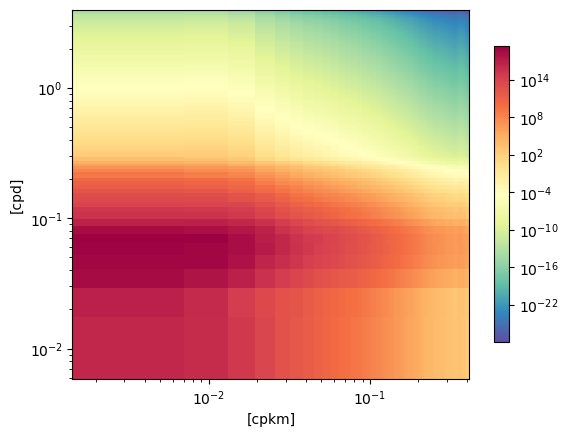

########### Cluster: 0


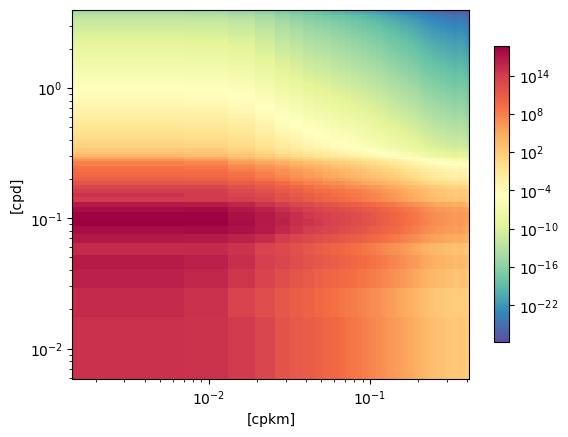

########### Cluster: 1


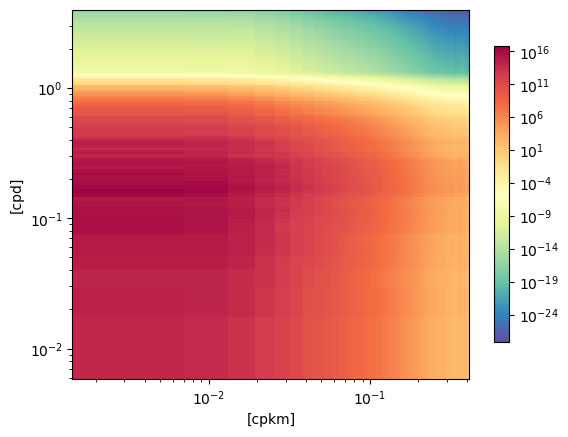

########### Cluster: 2


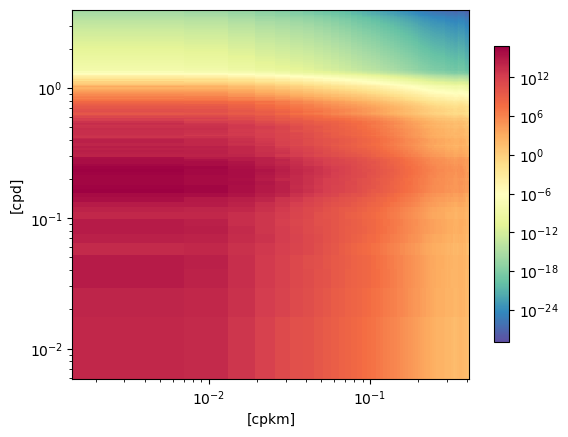

########### Cluster: 3


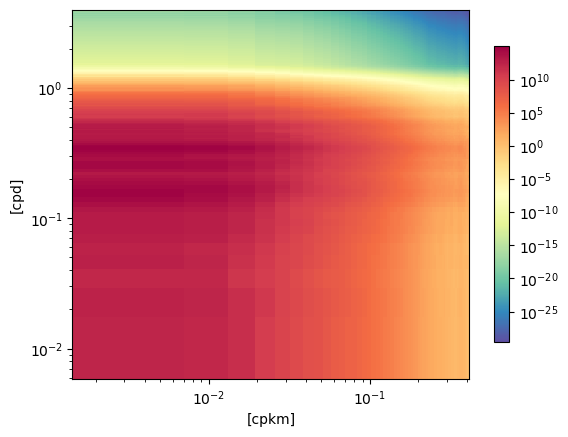

########### Cluster: 4


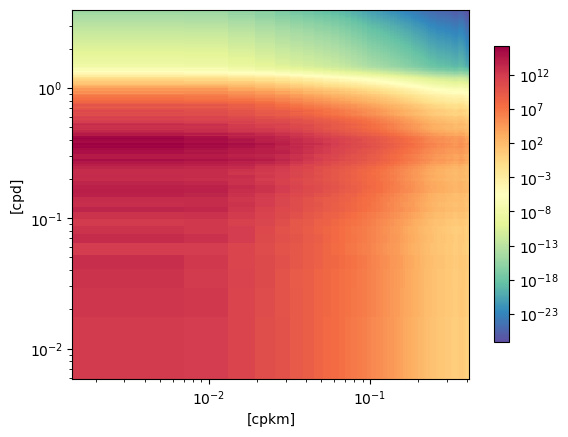

########### Cluster: 5


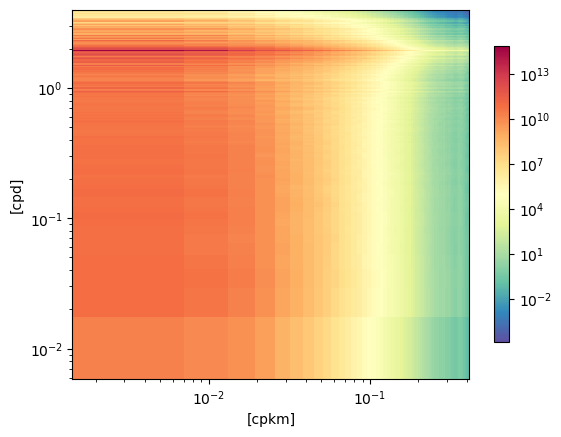

########### Cluster: 6


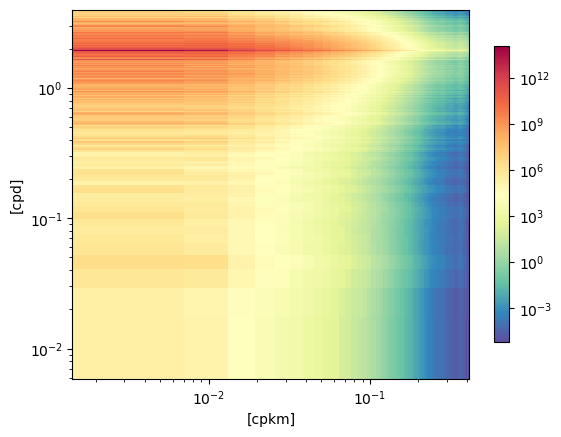

########### Cluster: 7


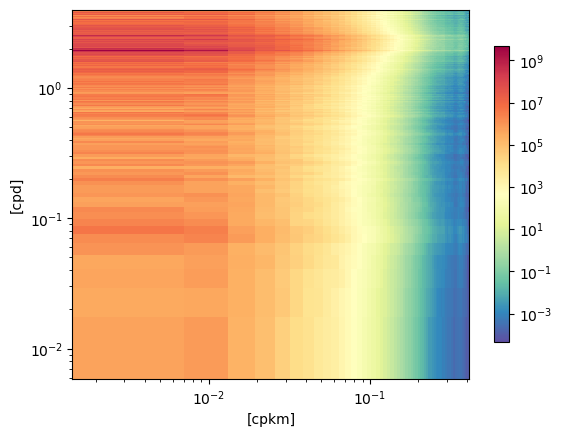

########### Cluster: 8


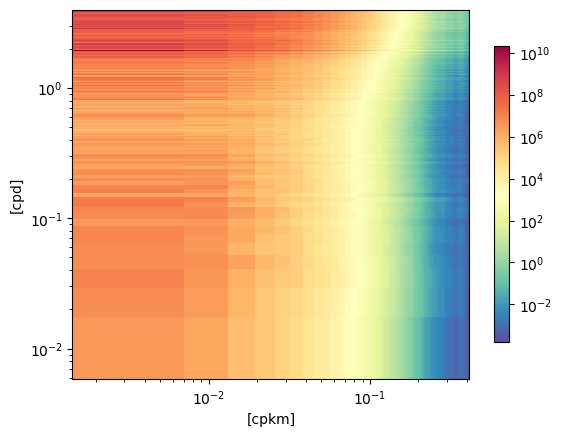

########### Cluster: 9


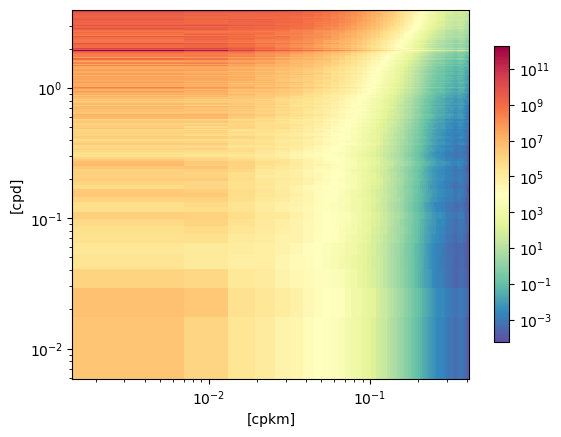

########### Cluster: 10


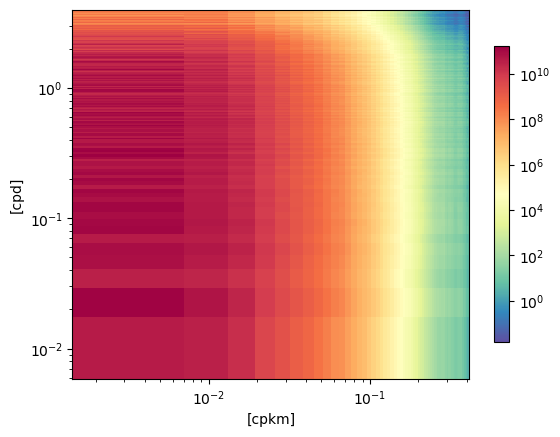

########### Cluster: 11


In [36]:
for mm in Fcluster.cluster:
    fig, ax = plt.subplots()
    im = ax.pcolormesh(Fcluster.freq_r*1e3,
                       Fcluster.freq_time[len(Fcluster.freq_time)//2+1:]*86400, 
                       Fcluster.isel(freq_time=slice(len(Fcluster.freq_time)//2+1,None)
                                    ).sel(cluster=mm),
                       cmap='Spectral_r', rasterized=True,
                       norm=clr.LogNorm()
                      )
    fig.colorbar(im, shrink=.8)
    ax.set_yscale('log')
    ax.set_xscale('log')
    ax.set_xlabel(r'[cpkm]')
    ax.set_ylabel(r'[cpd]')
    plt.show()

    print("########### Cluster:", mm.values)

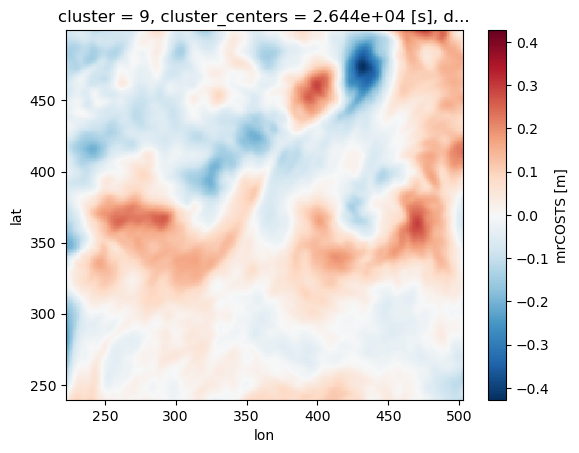

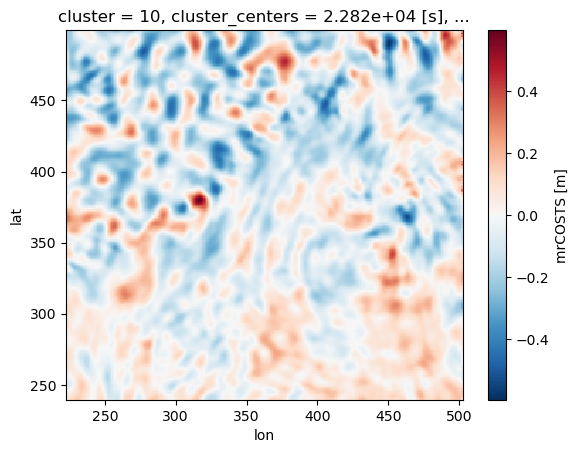

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


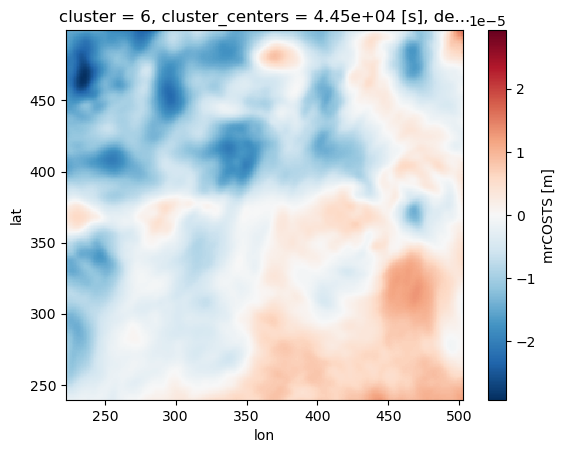

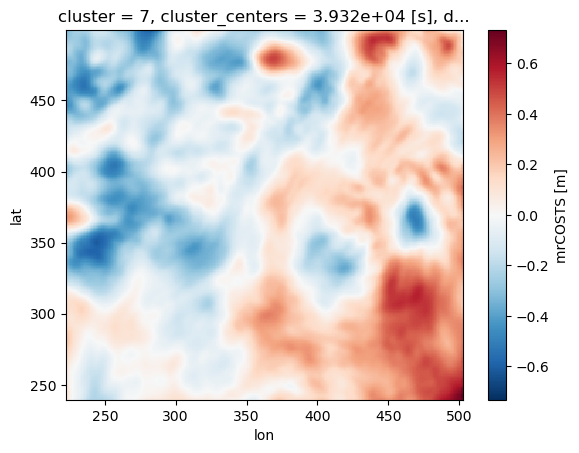

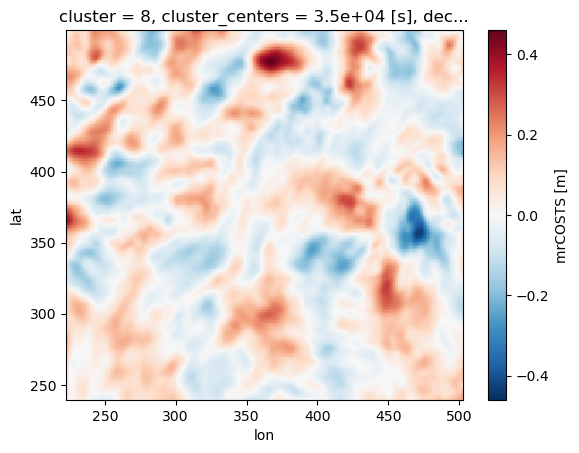

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1
########## TIME: 25


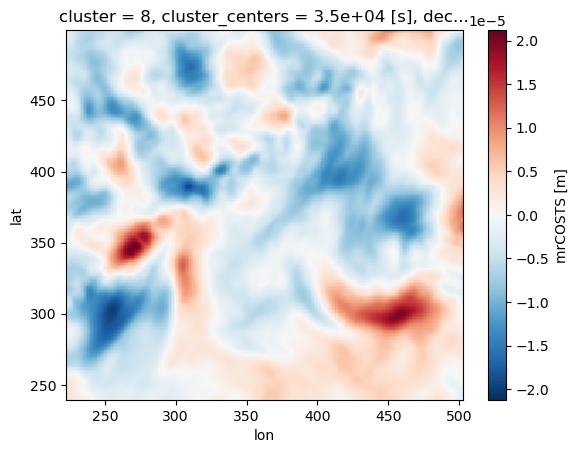

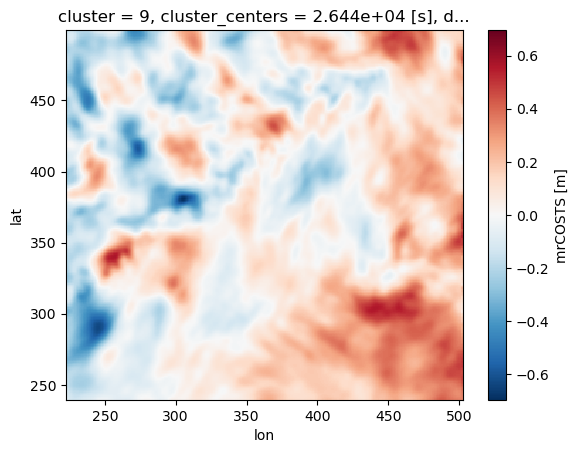

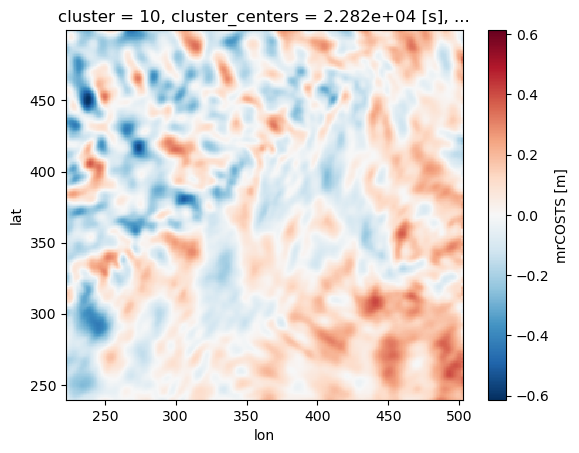

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


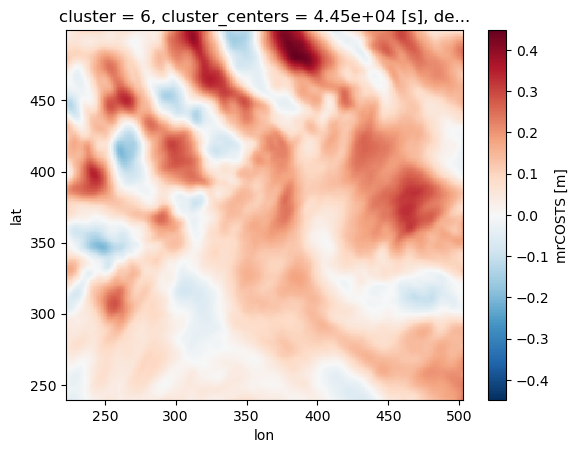

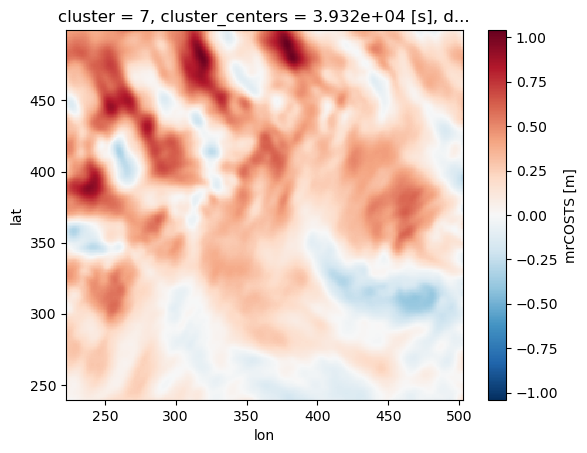

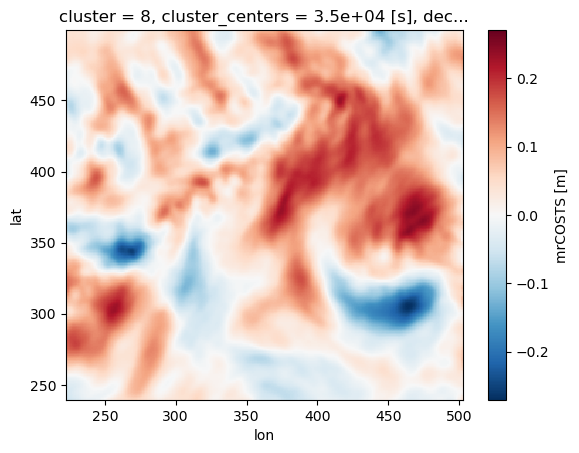

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1
########## TIME: 125


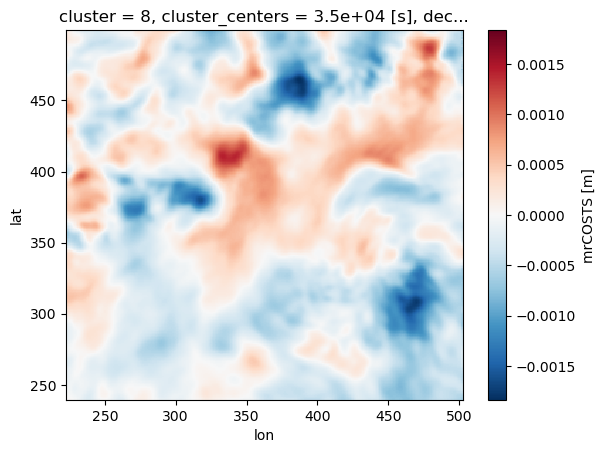

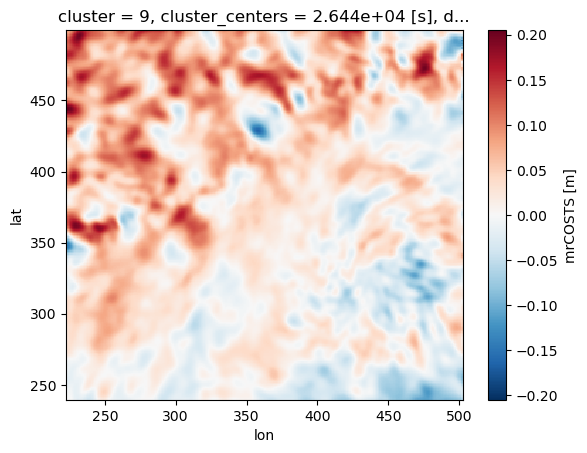

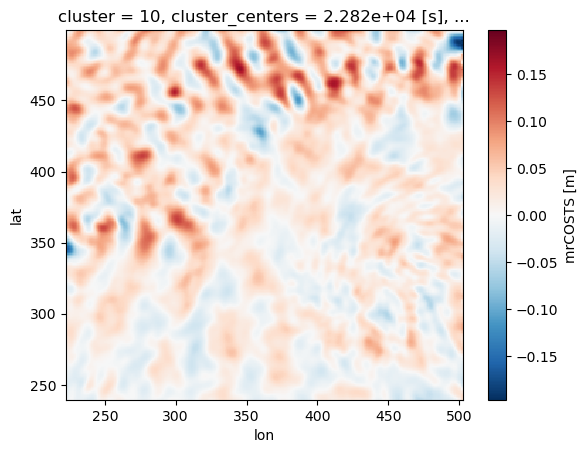

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


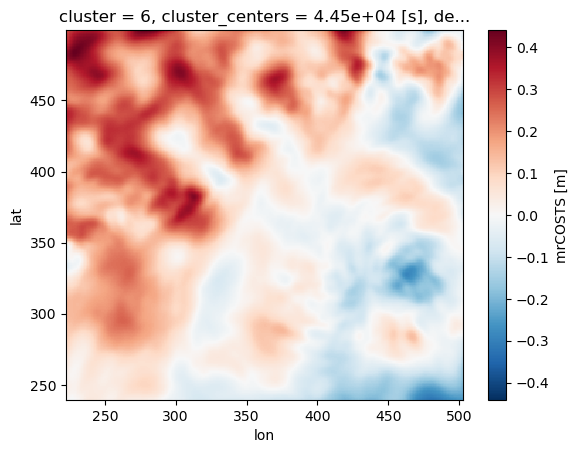

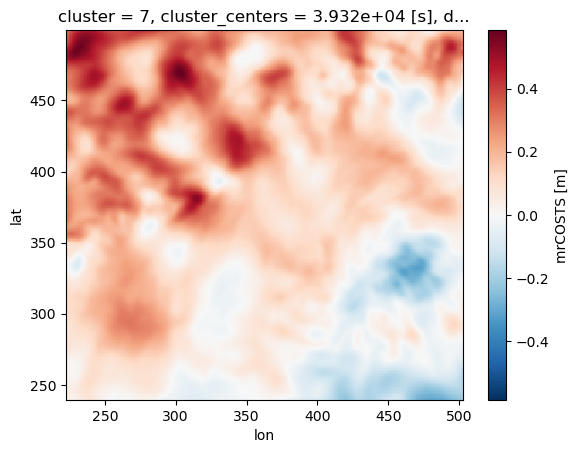

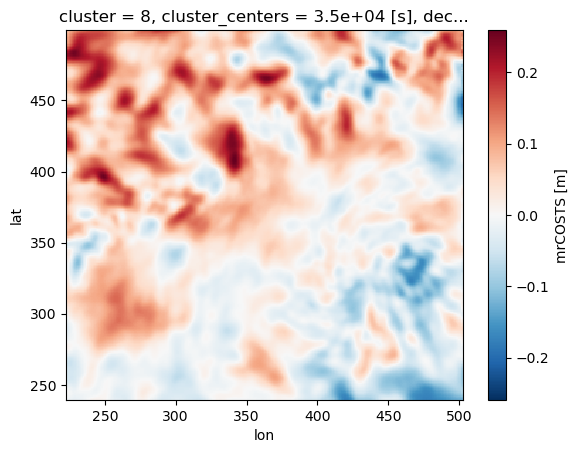

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1
########## TIME: 225


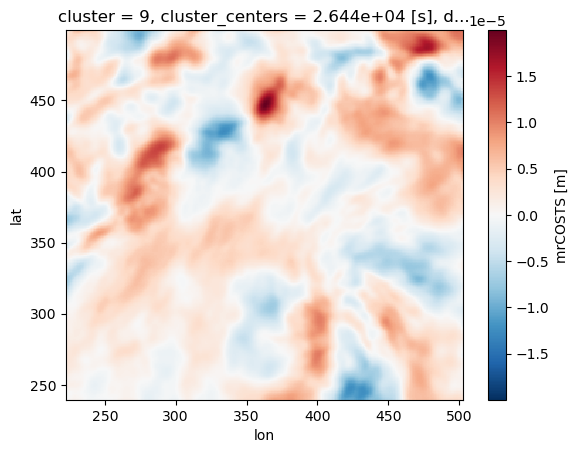

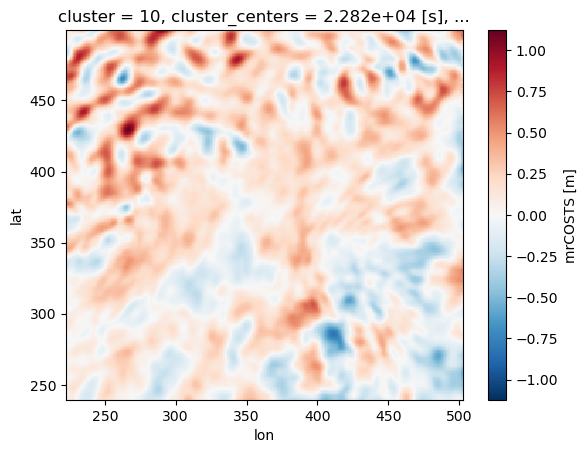

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


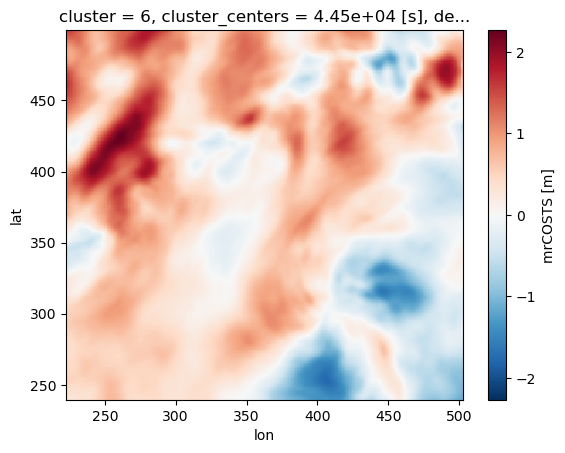

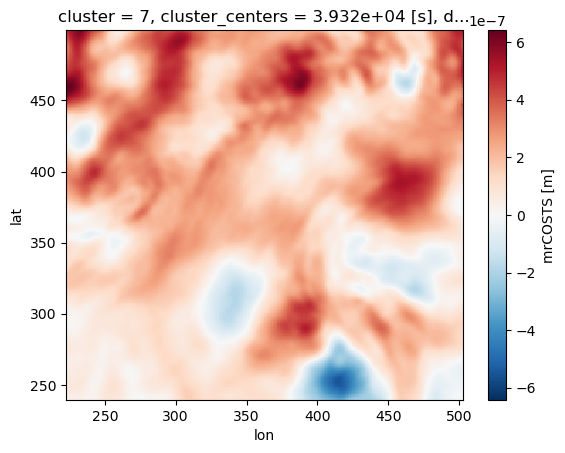

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1
########## TIME: 325


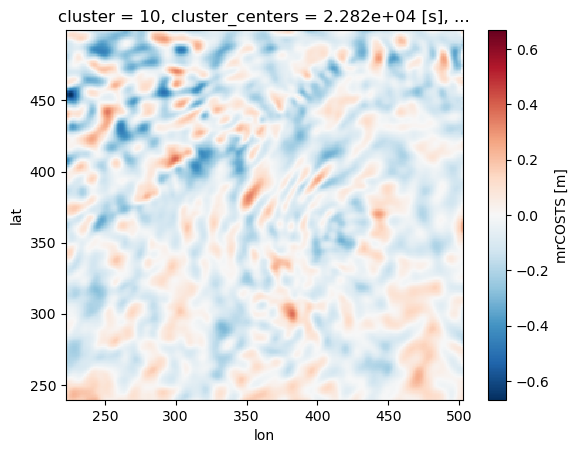

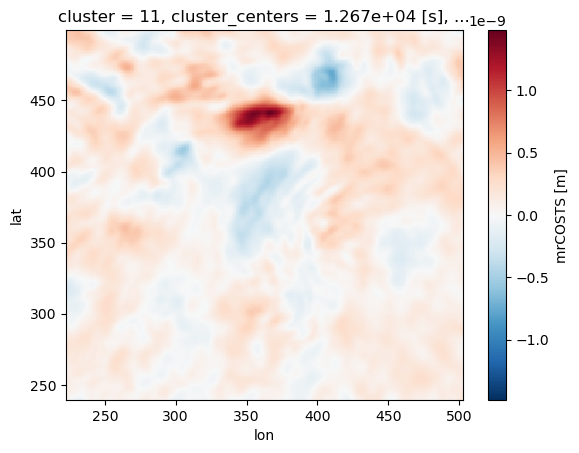

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


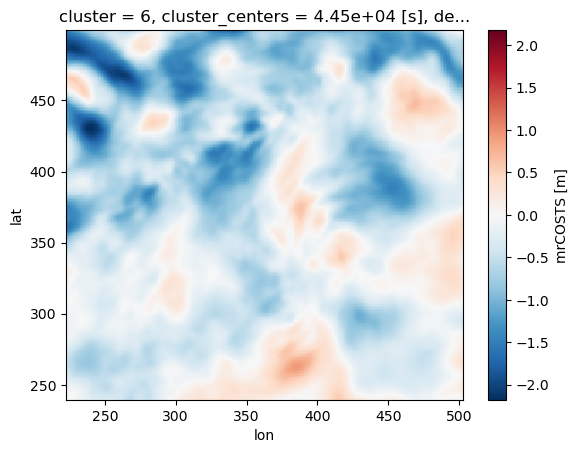

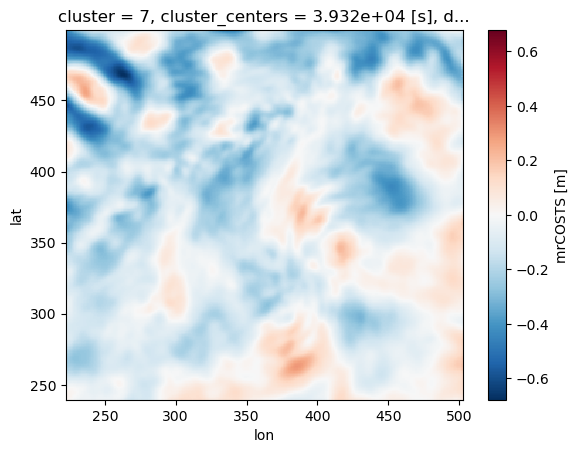

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1
########## TIME: 425


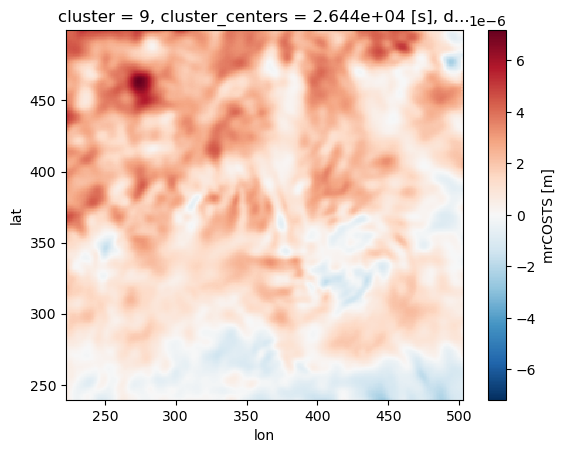

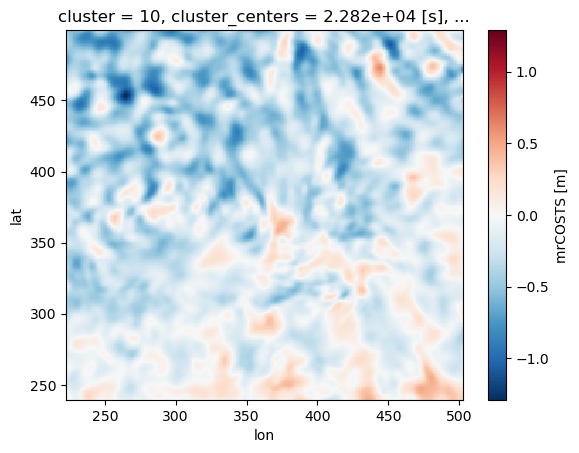

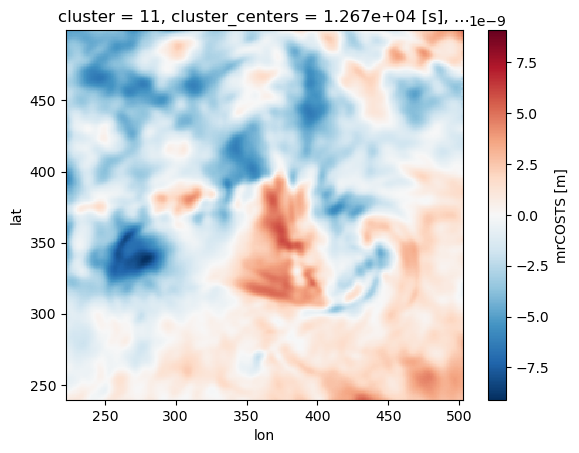

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


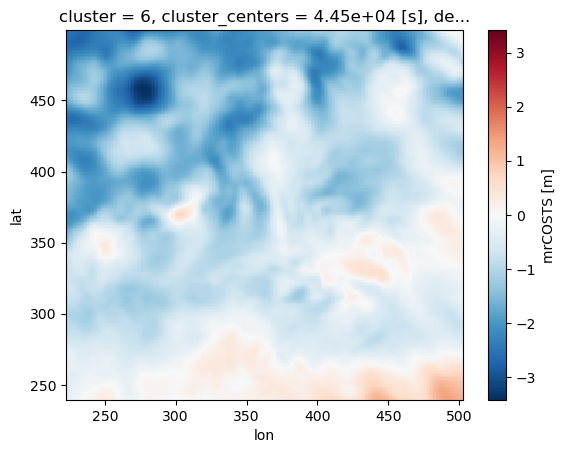

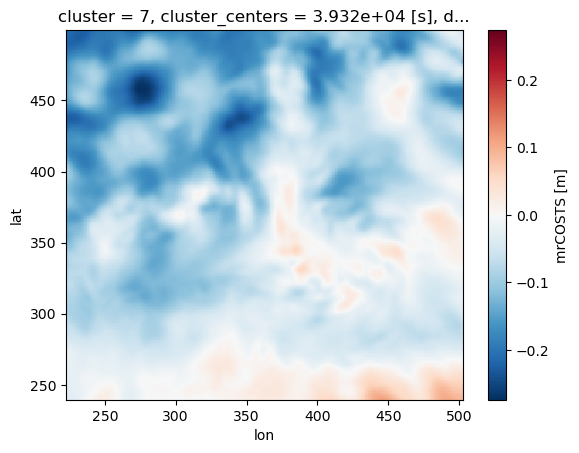

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1
########## TIME: 525


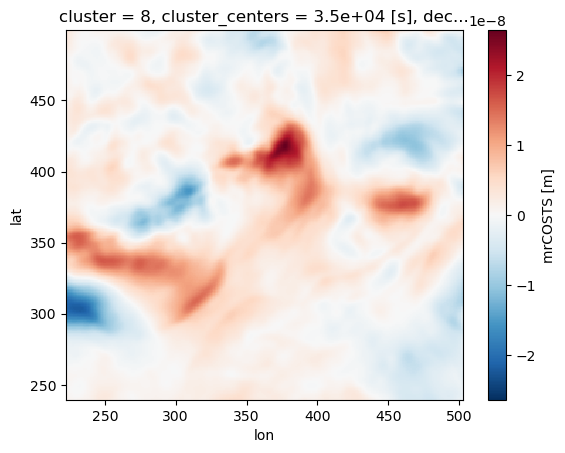

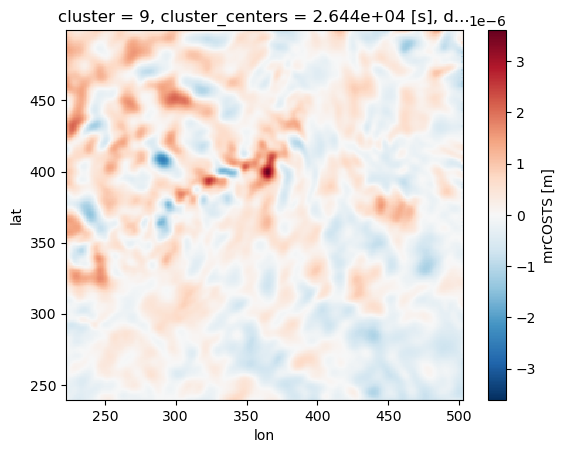

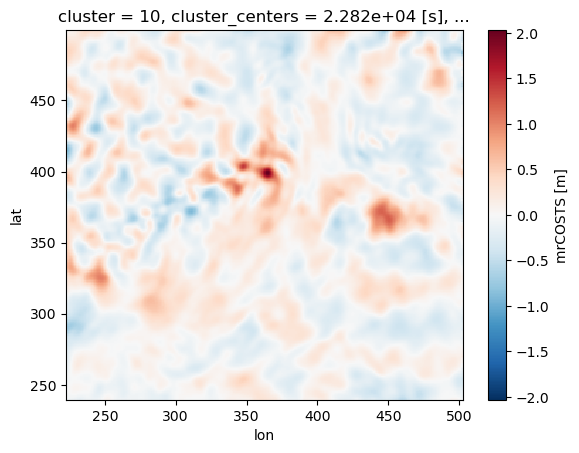

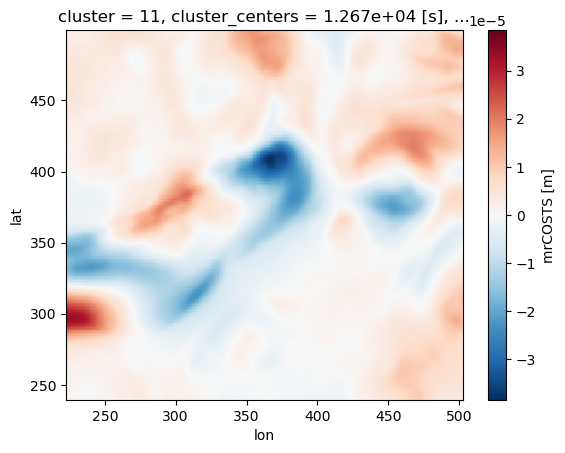

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(0)
Coordinates:
    decomp_level  int64 0


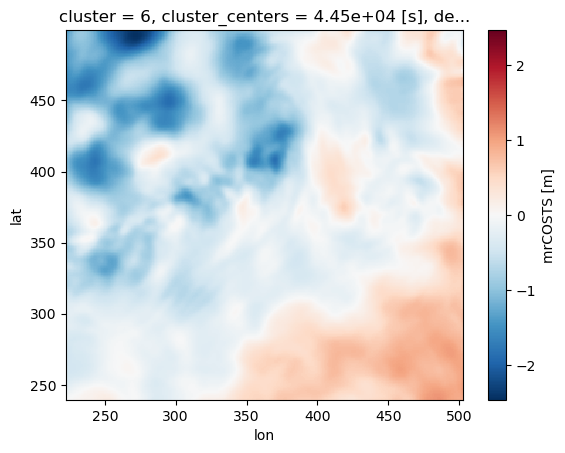

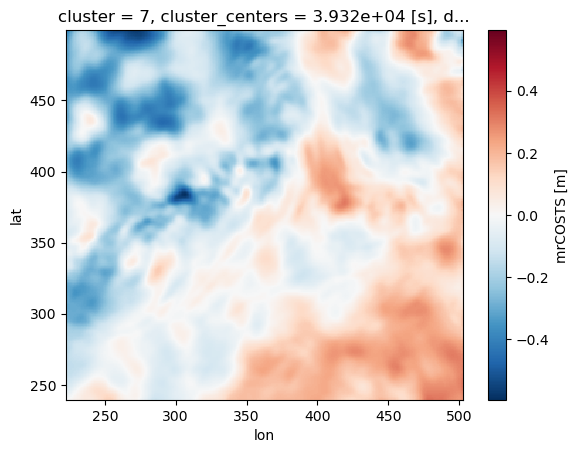

########## DECOMP: <xarray.DataArray 'decomp_level' ()>
array(1)
Coordinates:
    decomp_level  int64 1
########## TIME: 625


In [37]:
for tt in np.arange(25,len(dsc.time)-25,100):
    for i in dsc.decomp_level.isel(decomp_level=slice(None,2)):
        
        for j in dsc.cluster.isel(cluster=slice(6,None)):
            if dsc.frequency_bands.sel(decomp_level=i, cluster=j
                                      ).isel(time=tt).sum() != 0.:
                dsc.frequency_bands.sel(decomp_level=i, cluster=j
                                       ).isel(time=tt).plot(rasterized=True)
                plt.show()
            
        print("########## DECOMP:",i)
    print("########## TIME:",tt)

In [39]:
Fcluster = xrft.power_spectrum(modes.isel(decomp_level=slice(None,2), cluster=slice(6,None)
                                         ).chunk({'time':-1}), 
                               dim='time', detrend='linear', 
                               window='hann', window_correction=True)
Fcluster = xrft.isotropic_power_spectrum(Fcluster.chunk({'freq_time':1,'lat':-1,'lon':-1}), dim=['lat','lon'], 
                                         detrend='constant', window='hann', window_correction=True
                                        )
Fcluster

<xarray.DataArray (cluster: 6, decomp_level: 2, freq_time: 686, freq_r: 65)>
dask.array<mul, shape=(6, 2, 686, 65), dtype=float64, chunksize=(1, 1, 1, 65), chunktype=numpy.ndarray>
Coordinates:
  * cluster          (cluster) int64 6 7 8 9 10 11
    cluster_centers  (cluster) float64 dask.array<chunksize=(1,), meta=np.ndarray>
  * decomp_level     (decomp_level) int64 0 1
  * freq_time        (freq_time) float64 -4.63e-05 -4.616e-05 ... 4.616e-05
  * freq_r           (freq_r) float64 4.247e-06 9.887e-06 ... 0.0004107

###########################
########### DECOMP_LEVEL: 0


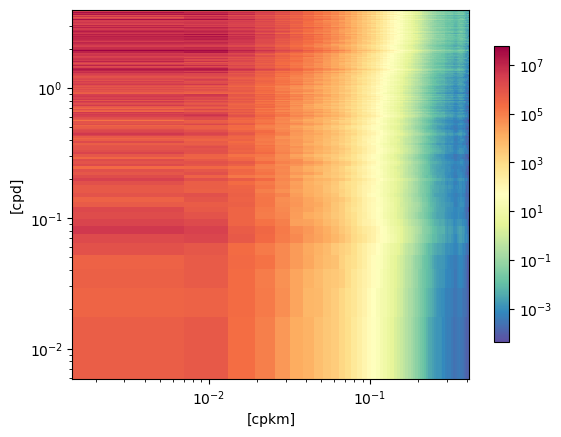

########### CLUSTER: 8


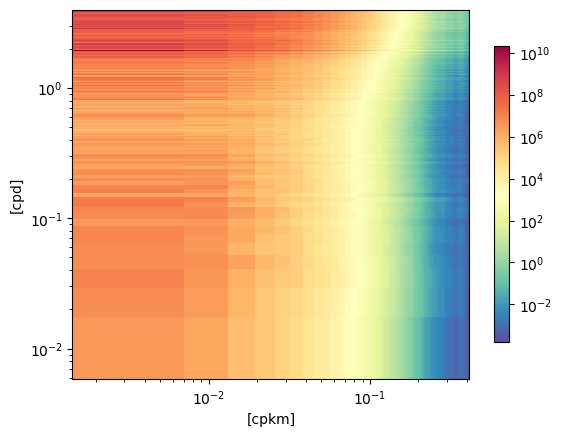

########### CLUSTER: 9


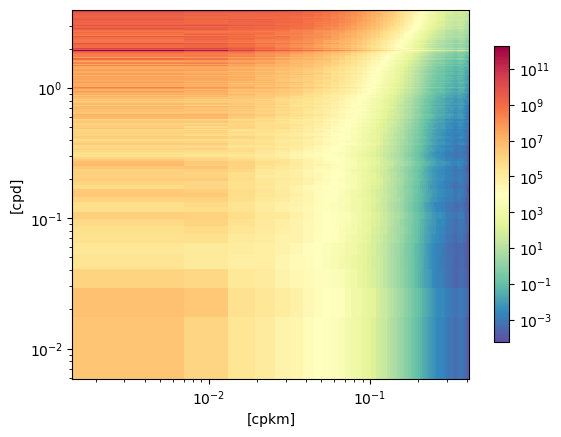

########### CLUSTER: 10


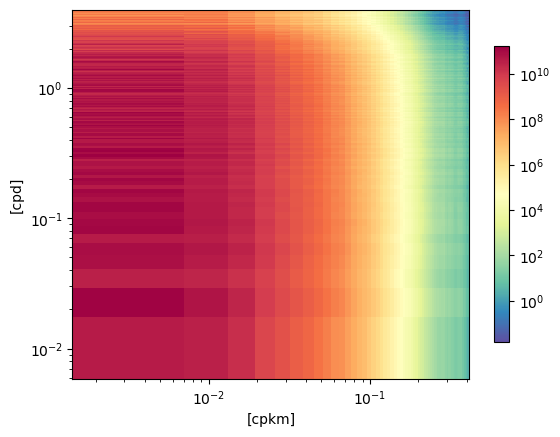

########### CLUSTER: 11
###########################
########### DECOMP_LEVEL: 1


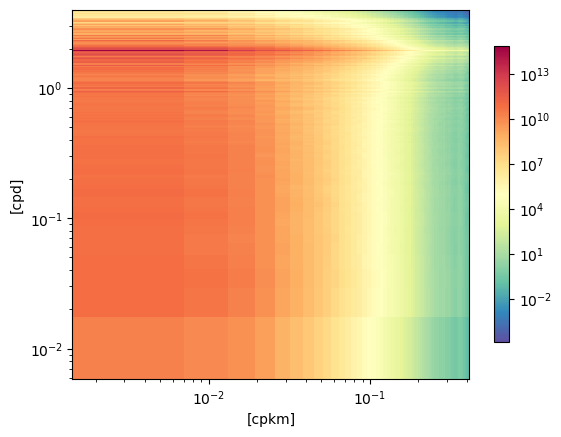

########### CLUSTER: 6


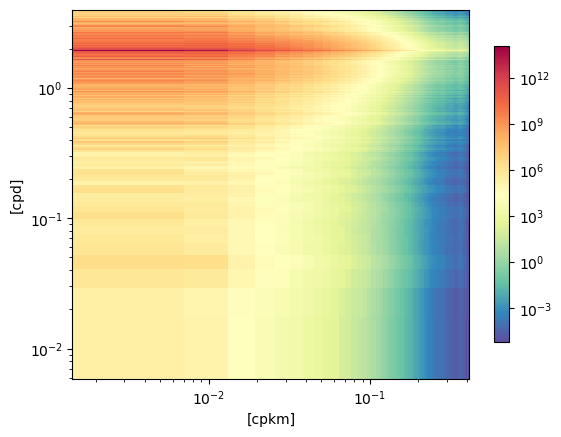

########### CLUSTER: 7


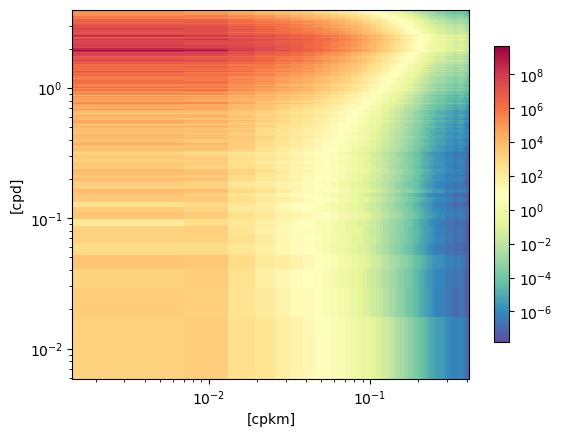

########### CLUSTER: 8


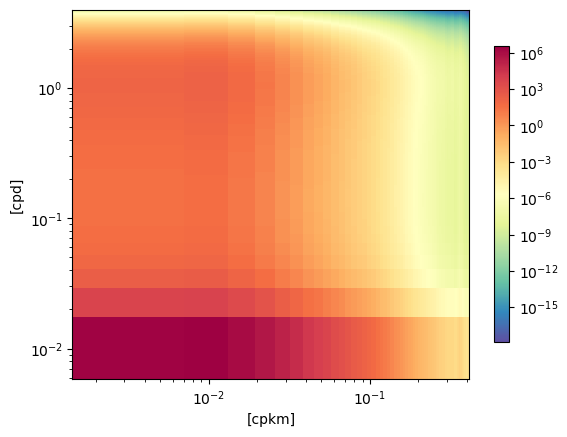

########### CLUSTER: 11


In [40]:
for dd in Fcluster.decomp_level:
    print("###########################")
    print("########### DECOMP_LEVEL:", dd.values)
    
    for cc in Fcluster.cluster:
        # plt.imshow(modes.sel(cluster=cc, decomp_level=dd).isel(time=10), origin='lower')
        # plt.show()
        if modes.sel(cluster=cc, decomp_level=dd).sum() != 0.:    
            fig, ax = plt.subplots()
            im = ax.pcolormesh(Fcluster.freq_r*1e3,
                               Fcluster.freq_time[len(Fcluster.freq_time)//2+1:]*86400., 
                               Fcluster.isel(freq_time=slice(len(Fcluster.freq_time)//2+1,None)
                                            ).sel(cluster=cc, decomp_level=dd),
                               cmap='Spectral_r', rasterized=True,
                               norm=clr.LogNorm()
                              )
            fig.colorbar(im, shrink=.8)
            ax.set_yscale('log')
            ax.set_xscale('log')
            ax.set_xlabel(r'[cpkm]')
            ax.set_ylabel(r'[cpd]')
            plt.show()
            
            print("########### CLUSTER:", cc.values)

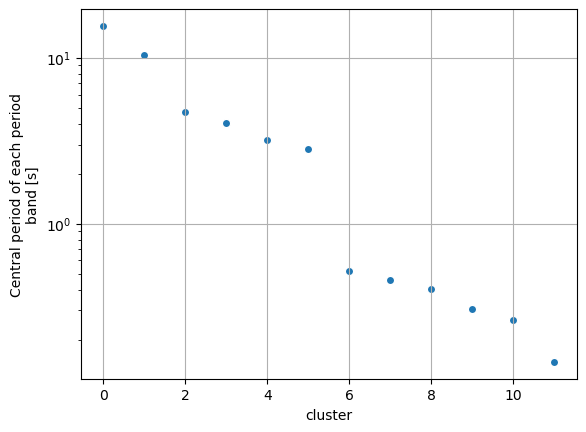

In [49]:
fig, ax = plt.subplots()
(dsc3.cluster_centers/86400.).plot.scatter(ax=ax)
ax.set_yscale('log')
ax.grid(True)

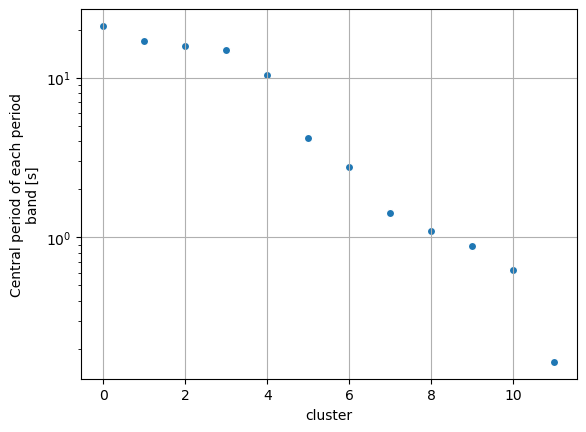

In [47]:
fig, ax = plt.subplots()
(dsc12.cluster_centers/86400.).plot.scatter(ax=ax)
ax.set_yscale('log')
ax.grid(True)

In [44]:
high3_0 = dsc.frequency_bands.isel(time=slice(25,-25), decomp_level=0, cluster=slice(None,None)
                                )
high3_1 = dsc.frequency_bands.isel(time=slice(25,-25), decomp_level=1, cluster=slice(6,None)
                                )
high = dsc.frequency_bands.isel(time=slice(25,-25), cluster=slice(7,None))
low_res = SSH - (
                 # high.sum(['decomp_level','cluster']) 
                 high0.sum(['cluster']) 
                 + high1.sum(['cluster']) 
                 # + low1.sum(['cluster'])
                )
low_res

<xarray.DataArray (time: 686, lat: 260, lon: 280)>
dask.array<sub, shape=(686, 260, 280), dtype=float64, chunksize=(1, 260, 280), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) int64 240 241 242 243 244 245 246 ... 494 495 496 497 498 499
  * lon      (lon) int64 223 224 225 226 227 228 229 ... 497 498 499 500 501 502
  * time     (time) float64 2.7e+05 2.808e+05 2.916e+05 ... 7.657e+06 7.668e+06

In [30]:
n3 = 6
low3 = (xr.concat([dsc3.frequency_bands.isel(cluster=slice(None,n3)),
                  # dsc.frequency_bands.isel(cluster=slice(-2,None))
                 ], 'cluster'
                    # decomp_level=slice(1,None)
                ).sum(['decomp_level','cluster']) 
       + bg3).isel(time=slice(28,-28))
n12 = 6
low12 = (xr.concat([dsc12.frequency_bands.isel(cluster=slice(None,n12)),
                  # dsc.frequency_bands.isel(cluster=slice(-2,None))
                 ], 'cluster'
                    # decomp_level=slice(1,None)
                ).sum(['decomp_level','cluster']) 
       + bg12).isel(time=slice(7,-7))
low12

<xarray.DataArray (time: 170, lat: 260, lon: 280)>
dask.array<getitem, shape=(170, 260, 280), dtype=float64, chunksize=(1, 260, 280), chunktype=numpy.ndarray>
Coordinates:
  * lat      (lat) int64 240 241 242 243 244 245 246 ... 494 495 496 497 498 499
  * lon      (lon) int64 223 224 225 226 227 228 229 ... 497 498 499 500 501 502
  * time     (time) float64 3.024e+05 3.456e+05 3.888e+05 ... 7.56e+06 7.603e+06
Attributes:
    long_name:  mrCOSTS
    units:      m

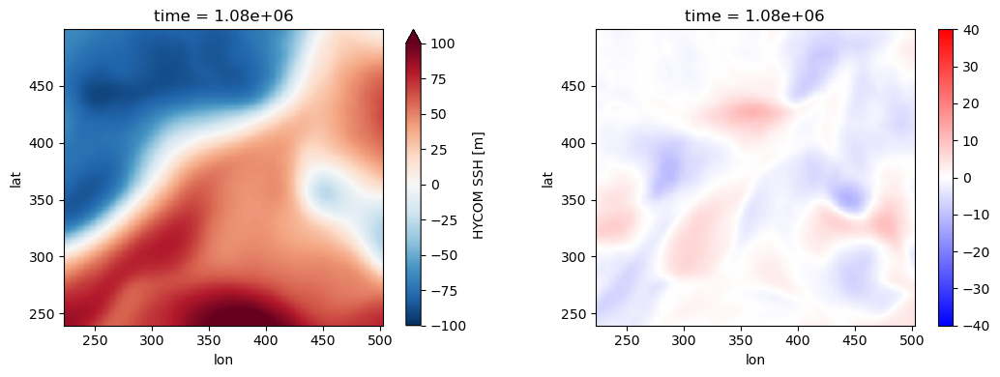

In [54]:
dssh_12 = SSH[::4] - dsC12.SSH

fig, (ax1,ax2) = plt.subplots(figsize=(11,4), nrows=1, ncols=2)
fig.set_tight_layout(True)

dsC12.SSH.isel(time=25).plot(ax=ax1, vmax=100, rasterized=True)
dssh_12.isel(time=25).plot(ax=ax2, vmax=40, rasterized=True, cmap='bwr')

ax1.set_aspect('equal')
ax2.set_aspect('equal')

In [38]:
SSH_d = dsh.ssh.copy()
SSH_d.coords['day'] = ('time', np.repeat(np.arange(92),24))
SSH_d = SSH_d.groupby('day').mean('time').compute()
SSH_d

<xarray.DataArray 'ssh' (day: 92, lat: 260, lon: 280)>
array([[[ 44.283325,  42.97122 ,  41.643124, ...,  83.45448 ,
          82.67182 ,  79.840515],
        [ 44.198986,  42.900852,  41.586468, ...,  84.450905,
          83.66589 ,  80.798256],
        [ 44.112774,  42.82982 ,  41.53015 , ...,  85.427795,
          84.64709 ,  81.734215],
        ...,
        [-63.291256, -63.08551 , -62.917713, ..., -15.823838,
         -15.638726, -14.968067],
        [-63.862415, -63.65489 , -63.482174, ..., -18.246233,
         -18.064535, -17.419529],
        [-64.44818 , -64.2382  , -64.05991 , ..., -20.702314,
         -20.52381 , -19.890406]],

       [[ 54.65579 ,  53.267757,  51.80457 , ...,  92.00699 ,
          91.663704,  90.34951 ],
        [ 54.64943 ,  53.282726,  51.837906, ...,  92.13114 ,
          91.802956,  90.53974 ],
        [ 54.642136,  53.298557,  51.873657, ...,  92.18713 ,
          91.87384 ,  90.64062 ],
...
        [-82.12527 , -81.82232 , -81.51399 , ..., -27.699791,
         -29.51407 , -36.975063],
        [-82.31669 , -82.01398 , -81.69857 , ..., -27.975195,
         -29.771759, -37.157856],
        [-82.527   , -82.23075 , -81.9147  , ..., -28.229921,
         -30.008087, -37.3036  ]],

       [[ 71.26866 ,  71.29911 ,  71.31333 , ...,  56.086956,
          55.309063,  52.218533],
        [ 71.22694 ,  71.27125 ,  71.30306 , ...,  56.115433,
          55.325367,  52.16304 ],
        [ 71.19482 ,  71.2433  ,  71.28324 , ...,  56.168056,
          55.365803,  52.1469  ],
        ...,
        [-82.41359 , -82.12787 , -81.848526, ..., -11.615436,
         -13.135525, -19.642977],
        [-82.570015, -82.27289 , -81.98336 , ..., -11.272708,
         -12.758052, -19.154436],
        [-82.75596 , -82.450905, -82.15158 , ..., -10.924446,
         -12.375588, -18.605795]]], dtype=float32)
Coordinates:
  * lat      (lat) int64 240 241 242 243 244 245 246 ... 494 495 496 497 498 499
  * lon      (lon) int64 223 224 225 226 227 228 229 ... 497 498 499 500 501 502
  * day      (day) int64 0 1 2 3 4 5 6 7 8 9 ... 82 83 84 85 86 87 88 89 90 91

In [39]:
mrSSH3_d = (xr.concat([dsc3.frequency_bands.isel(cluster=slice(None,n3)),
                  # dsc.frequency_bands.isel(cluster=slice(-2,None))
                     ], 'cluster'
                        # decomp_level=slice(1,None)
                    ).sum(['decomp_level','cluster']) 
            + bg3
           ).copy()
mrSSH3_d.coords['day'] = ('time', np.repeat(np.arange(92),8))
mrSSH3_d = mrSSH3_d.groupby('day').mean('time').compute()

mrSSH12_d = (xr.concat([dsc12.frequency_bands.isel(cluster=slice(None,n12)),
                  # dsc.frequency_bands.isel(cluster=slice(-2,None))
                     ], 'cluster'
                        # decomp_level=slice(1,None)
                    ).sum(['decomp_level','cluster']) 
             + bg12
            ).copy()
mrSSH12_d.coords['day'] = ('time', np.repeat(np.arange(92),2))
mrSSH12_d = mrSSH12_d.groupby('day').mean('time').compute()
mrSSH12_d

<xarray.DataArray (day: 92, lat: 260, lon: 280)>
array([[[ 58.57753672,  58.03849277,  57.44464661, ...,  67.95081687,
          67.76023862,  67.0785005 ],
        [ 58.33727379,  57.81827643,  57.24477351, ...,  67.78127301,
          67.5882222 ,  66.88358386],
        [ 58.09157928,  57.59277285,  57.03996239, ...,  67.59612398,
          67.4012601 ,  66.64727829],
        ...,
        [-69.30670539, -69.1832918 , -69.07827815, ...,  -3.89305081,
          -3.50281193,  -1.94785046],
        [-69.52078135, -69.39822854, -69.29197681, ...,  -6.55997322,
          -6.1744192 ,  -4.63249273],
        [-69.73745181, -69.61326932, -69.50357873, ...,  -9.31343407,
          -8.93783177,  -7.45476513]],

       [[ 60.7100897 ,  60.10056244,  59.43264695, ...,  69.55390059,
          69.3570463 ,  68.67747707],
        [ 60.3640765 ,  59.78021339,  59.13881182, ...,  69.22010803,
          69.02024358,  68.31958199],
        [ 60.01239788,  59.45354864,  58.83894884, ...,  68.86973951,
          68.66781738,  67.90518286],
...
        [-80.28153188, -80.10293348, -79.92846174, ..., -50.8122426 ,
         -52.1425661 , -57.64278885],
        [-80.37933119, -80.18178205, -79.98527806, ..., -51.67728349,
         -52.99774082, -58.47569764],
        [-80.50166256, -80.28856213, -80.07352668, ..., -52.51675176,
         -53.83136254, -59.32482067]],

       [[ 62.7569878 ,  62.81060656,  62.8578695 , ...,  67.91441527,
          67.57105188,  66.37070812],
        [ 62.66744344,  62.73413787,  62.79275115, ...,  67.32174793,
          67.00663761,  65.93988839],
        [ 62.55387062,  62.63169241,  62.70154411, ...,  66.78456178,
          66.49317529,  65.51082519],
        ...,
        [-79.28674223, -79.11962378, -78.95686208, ..., -58.85139651,
         -59.98068064, -64.74524672],
        [-79.35529161, -79.16992154, -78.98754658, ..., -59.72351938,
         -60.85857792, -65.68975518],
        [-79.44924389, -79.2490851 , -79.0500082 , ..., -60.54784701,
         -61.6870827 , -66.48918944]]])
Coordinates:
  * lat      (lat) int64 240 241 242 243 244 245 246 ... 494 495 496 497 498 499
  * lon      (lon) int64 223 224 225 226 227 228 229 ... 497 498 499 500 501 502
  * day      (day) int64 0 1 2 3 4 5 6 7 8 9 ... 82 83 84 85 86 87 88 89 90 91
Attributes:
    long_name:  mrCOSTS
    units:      m

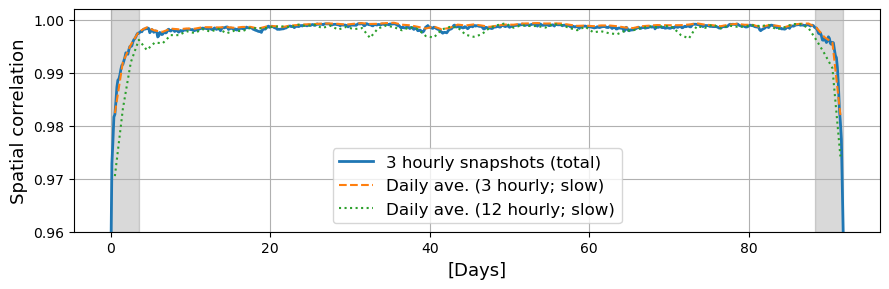

In [120]:
rcoDMD = xr.corr(SSH, xr.DataArray(dsC3.SSH.data, dims=SSH.dims), 
                 dim=['lat','lon'])
rcoDMD3_d = xr.corr(SSH_d, xr.DataArray(mrSSH3_d, dims=SSH_d.dims), 
                   dim=['lat','lon'])
rcoDMD12_d = xr.corr(SSH_d, xr.DataArray(mrSSH12_d, dims=SSH_d.dims), 
                   dim=['lat','lon'])

fig, ax = plt.subplots(figsize=(9,3))
fig.set_tight_layout(True)

ax.fill_between(np.array([0, 28*3.*3600/86400]), 
                .96, 1.002, color='k', alpha=.15)
ax.fill_between(np.array([(len(SSH)-1-28)*3.*3600/86400, 
                          (len(SSH)-1)*3.*3600/86400]), 
                .96, 1.002, color='k', alpha=.15)
ax.plot(np.arange(0,len(SSH))*3.*3600/86400, rcoDMD, lw=2,
        label=r"3 hourly snapshots (total)")
ax.plot(np.arange(.5,len(SSH_d)+.5), rcoDMD3_d, ls='--', 
        label=r"Daily ave. (3 hourly; slow)")
ax.plot(np.arange(.5,len(SSH_d)+.5), rcoDMD12_d, ls=':', 
        label=r"Daily ave. (12 hourly; slow)")

ax.legend(loc='lower center', fontsize=12)
ax.set_ylim([.96,1.002])
ax.set_ylabel(r"Spatial correlation", fontsize=13)
ax.set_xlabel(r"[Days]", fontsize=13)
ax.grid(True)
plt.savefig(op.join(sdir,'Figs/HYCOM50_mrCOSTS_correlation.pdf'))

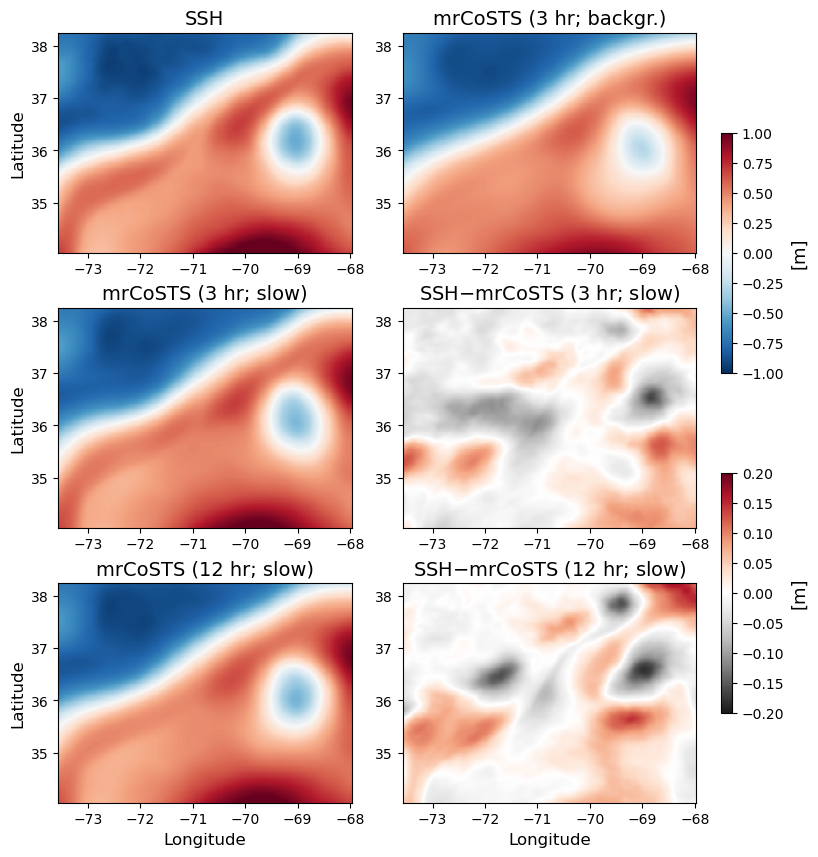

In [148]:
tt = 28

fig, axes = plt.subplots(figsize=(9,10), nrows=3, ncols=2)
# fig.set_tight_layout(True)

im0 = axes[0,0].pcolormesh(hycom_grid.plon, hycom_grid.plat,
                     SSH.isel(time=tt)*1e-2, 
                     rasterized=True, vmax=1, vmin=-1, cmap='RdBu_r')
axes[0,1].pcolormesh(hycom_grid.plon, hycom_grid.plat,
                     bg3.isel(time=0).real*1e-2, rasterized=True, 
                     vmax=1, vmin=-1, cmap='RdBu_r')
axes[1,0].pcolormesh(hycom_grid.plon, hycom_grid.plat,
                     low3.isel(time=0).real*1e-2, rasterized=True, 
                     vmax=1, vmin=-1, cmap='RdBu_r')
im1 = axes[1,1].pcolormesh(hycom_grid.plon, hycom_grid.plat,
                     (SSH.isel(time=tt) - low3.isel(time=0).real.data)*1e-2, 
                     rasterized=True,
                     cmap='RdGy_r', vmax=.2, vmin=-.2)
axes[2,0].pcolormesh(hycom_grid.plon, hycom_grid.plat,
                     low12.isel(time=0).real*1e-2, rasterized=True, 
                     vmax=1, vmin=-1, cmap='RdBu_r')
axes[2,1].pcolormesh(hycom_grid.plon, hycom_grid.plat,
                     (SSH.isel(time=tt) - low12.isel(time=0).real.data)*1e-2, 
                     rasterized=True,
                     cmap='RdGy_r', vmax=.2, vmin=-.2)

axes[0,0].set_aspect('equal')
axes[0,1].set_aspect('equal')
axes[1,0].set_aspect('equal')
axes[1,1].set_aspect('equal')
axes[2,0].set_aspect('equal')
axes[2,1].set_aspect('equal')

axes[0,0].set_title(r"SSH", fontsize=14)
axes[0,1].set_title(r"mrCoSTS (3 hr; backgr.)", fontsize=14)
axes[1,0].set_title(r"mrCoSTS (3 hr; slow)", fontsize=14)
axes[1,1].set_title(r"SSH$-$mrCoSTS (3 hr; slow)", fontsize=14)
axes[2,0].set_title(r"mrCoSTS (12 hr; slow)", fontsize=14)
axes[2,1].set_title(r"SSH$-$mrCoSTS (12 hr; slow)", fontsize=14)

axes[0,0].set_ylabel(r"Latitude", fontsize=12)
axes[1,0].set_ylabel(r"Latitude", fontsize=12)
axes[2,0].set_ylabel(r"Latitude", fontsize=12)
axes[2,0].set_xlabel(r"Longitude", fontsize=12)
axes[2,1].set_xlabel(r"Longitude", fontsize=12)

fig.subplots_adjust(right=.85, hspace=.25, wspace=.12) 
cbax0 = fig.add_axes([0.87, 0.54, 0.012, 0.24])
cbar0 = fig.colorbar(im0, orientation='vertical', cax=cbax0)
cbar0.set_label(r"[m]", fontsize=13)

cbax1 = fig.add_axes([0.87, 0.2, 0.012, 0.24])
cbar1 = fig.colorbar(im1, orientation='vertical', cax=cbax1)
cbar1.set_label(r"[m]", fontsize=13)

plt.savefig(op.join(sdir,'Figs/HYCOM50_mrCOSTS.pdf'))

In [31]:
hycomf  = xr.apply_ufunc(gsw.f, hycom_grid.plat, dask='parallelized')
hycomfq = xr.apply_ufunc(gsw.f, hycom_grid.qlat, dask='parallelized')
hycomfu = xr.apply_ufunc(gsw.f, hycom_grid.ulat, dask='parallelized')
hycomfv = xr.apply_ufunc(gsw.f, hycom_grid.vlat, dask='parallelized')
hycomf

<xarray.DataArray 'plat' (lat: 260, lon: 280)>
array([[8.16740126e-05, 8.16740126e-05, 8.16740126e-05, ...,
        8.16740126e-05, 8.16740126e-05, 8.16740126e-05],
       [8.17089468e-05, 8.17089468e-05, 8.17089468e-05, ...,
        8.17089468e-05, 8.17089468e-05, 8.17089468e-05],
       [8.17438662e-05, 8.17438662e-05, 8.17438662e-05, ...,
        8.17438662e-05, 8.17438662e-05, 8.17438662e-05],
       ...,
       [9.02029385e-05, 9.02029385e-05, 9.02029385e-05, ...,
        9.02029385e-05, 9.02029385e-05, 9.02029385e-05],
       [9.02343708e-05, 9.02343708e-05, 9.02343708e-05, ...,
        9.02343708e-05, 9.02343708e-05, 9.02343708e-05],
       [9.02657811e-05, 9.02657811e-05, 9.02657811e-05, ...,
        9.02657811e-05, 9.02657811e-05, 9.02657811e-05]])
Dimensions without coordinates: lat, lon

In [32]:
grav= 9.807

def diff(a, shift, axis):
    return a - np.roll(a, shift, axis)

In [33]:
def t_gradx(t, dx):
    return (diff(t, 1, axis=-1) / dx)
def t_grady(t, dy):
    return (diff(t, 1, axis=-2) / dy)

def t_vort(u, v, dxp, dyp, dyu, dxv):
    return (
        diff(v * dyu, 1, axis=-1)
        - diff(u * dxv, 1, axis=-2)
    ) / (dxp * dyp)

def t_div(u, v, dxq, dyq, dxu, dyv):
    return (
        diff(v * dxu, 1, axis=-2)
        + diff(u * dyv, 1, axis=-1)
    ) / (dxq * dyq)

def t_str(u, v, dxp, dyp, dxq, dyq, dxu, dyu, dxv, dyv):
    str1 = (diff(u * dyv, 1, axis=-1)
            - diff(v * dxu, 1, axis=-2)
           ) / (dyq * dxq)
    str2 = (diff(u * dxv, 1, axis=-2)
            + diff(v * dyu, 1, axis=-1)
           ) / (dyp * dxp)
    str1 = .25*(str1 
                + np.roll(str1,1,-1) 
                + np.roll(str1,1,-2)
                + np.roll(np.roll(str1,1,-1),1,-2)
               )
    return np.sqrt(str1**2
        + str2**2
    )

def q_vort(u, v, dxq, dyq, dxu, dyv):
    return (
        diff(v * dyv, 1, axis=-1)
        - diff(u * dxu, 1, axis=-2)
    ) / (dxq * dyq)

def q_div(u, v, dxp, dyp, dyu, dxv):
    return (
        diff(v * dxv, 1, axis=-2)
        + diff(u * dyu, 1, axis=-1)
    ) / (dxp * dyp)

def q_str(u, v, dxp, dyp, dxq, dyq, dxu, dyu, dxv, dyv):
    str1 = (diff(u * dyu, 1, axis=-1)
            - diff(v * dxv, 1, axis=-2)
           ) / (dyp * dxp)
    str2 = (diff(u * dxu, 1, axis=-2)
            + diff(v * dyv, 1, axis=-1)
           ) / (dyq * dxq)
    str1 = .25*(str1 
                + np.roll(str1,1,-1) 
                + np.roll(str1,1,-2)
                + np.roll(np.roll(str1,1,-1),1,-2)
               )
    return np.sqrt(str1**2
        + str2**2
    )

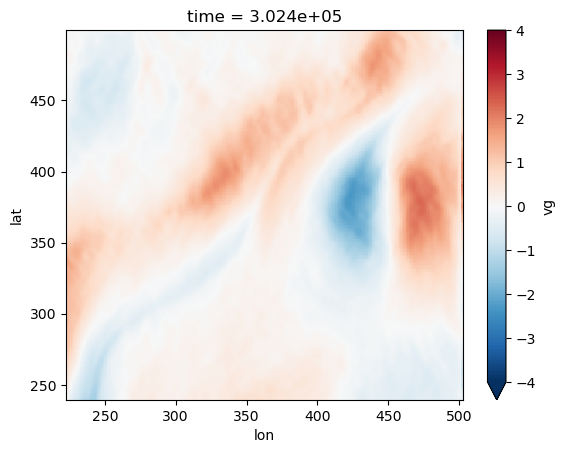

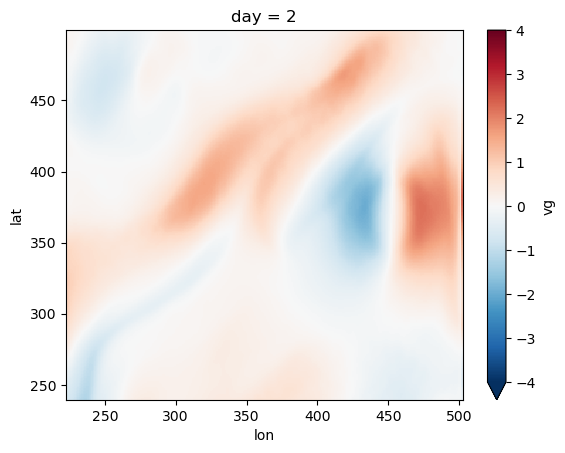

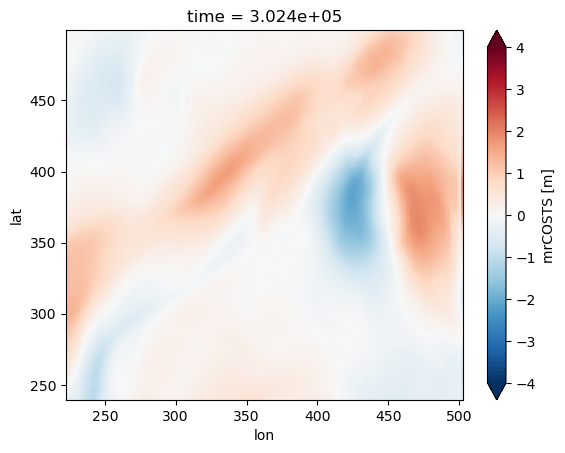

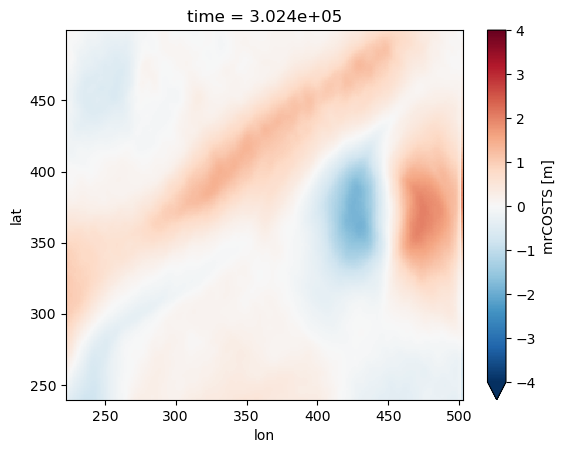

In [44]:
tt = 28
ug_raw = -(xr.apply_ufunc(
    t_grady,
    SSH[tt:][::4]*1e-2, 
    hycom_grid.pscy, 
    input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
) * grav / hycomfv).reset_coords(drop=True).rename('ug')
vg_raw = (xr.apply_ufunc(
    t_gradx,
    SSH[tt:][::4]*1e-2, 
    hycom_grid.pscx, 
    input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
) * grav / hycomfu).reset_coords(drop=True).rename('vg')
vg_raw.isel(time=0).plot(vmax=4., rasterized=True)
plt.show()

ug_d = -(xr.apply_ufunc(
    t_grady,
    SSH_d[2:]*1e-2, 
    hycom_grid.pscy, 
    input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
) * grav / hycomfv).reset_coords(drop=True).rename('ug')
vg_d = (xr.apply_ufunc(
    t_gradx,
    SSH_d[2:]*1e-2, 
    hycom_grid.pscx, 
    input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
) * grav / hycomfu).reset_coords(drop=True).rename('vg')
vg_d.isel(day=0).plot(vmax=4., rasterized=True)
plt.show()

# ugmrdmd = -(xr.apply_ufunc(
#     t_grady,
#     slowSSH.sum('mode').transpose('time','lat','lon'
#                                  )[25:][::2].chunk({'lat':-1,'lon':-1})*1e-2, 
#     hycom_grid.pscy, 
#     input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ) * grav / hycomfv).reset_coords(drop=True).rename('ug')
# vgmrdmd = (xr.apply_ufunc(
#     t_gradx,
#     slowSSH.sum('mode').transpose('time','lat','lon'
#                                  )[25:][::2].chunk({'lat':-1,'lon':-1})*1e-2, 
#     hycom_grid.pscx, 
#     input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ) * grav / hycomfu).reset_coords(drop=True).rename('vg')
# vgmrdmd.isel(time=0).plot(vmax=4., rasterized=True)
# plt.show()

# ugcost_r = -(xr.apply_ufunc(
#     t_grady,
#     low_res.transpose('time','lat','lon'
#                     )[::2].chunk({'lat':-1,'lon':-1})*1e-2, 
#     hycom_grid.pscy, 
#     input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ) * grav / hycomfv).reset_coords(drop=True).rename('ug')
# vgcost_r = (xr.apply_ufunc(
#     t_gradx,
#     low_res.transpose('time','lat','lon'
#                     )[::2].chunk({'lat':-1,'lon':-1})*1e-2, 
#     hycom_grid.pscx, 
#     input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ) * grav / hycomfu).reset_coords(drop=True).rename('vg')
# vgcost_r.isel(time=0).plot(vmax=4., rasterized=True)
# plt.show()

ugcost3 = -(xr.apply_ufunc(
    t_grady,
    low3.transpose('time','lat','lon'
                    )[::4].chunk({'lat':-1,'lon':-1})*1e-2, 
    hycom_grid.pscy, 
    input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
) * grav / hycomfv).reset_coords(drop=True).rename('ug')
vgcost3 = (xr.apply_ufunc(
    t_gradx,
    low3.transpose('time','lat','lon'
                    )[::4].chunk({'lat':-1,'lon':-1})*1e-2, 
    hycom_grid.pscx, 
    input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
) * grav / hycomfu).reset_coords(drop=True).rename('vg')
vgcost3.isel(time=0).plot(vmax=4., rasterized=True)
plt.show()

ugcost12 = -(xr.apply_ufunc(
    t_grady,
    low12.transpose('time','lat','lon'
                    ).chunk({'lat':-1,'lon':-1})*1e-2, 
    hycom_grid.pscy, 
    input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
) * grav / hycomfv).reset_coords(drop=True).rename('ug')
vgcost12 = (xr.apply_ufunc(
    t_gradx,
    low12.transpose('time','lat','lon'
                    ).chunk({'lat':-1,'lon':-1})*1e-2, 
    hycom_grid.pscx, 
    input_core_dims = 2 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
) * grav / hycomfu).reset_coords(drop=True).rename('vg')
vgcost12.isel(time=0).plot(vmax=4., rasterized=True)
plt.show()

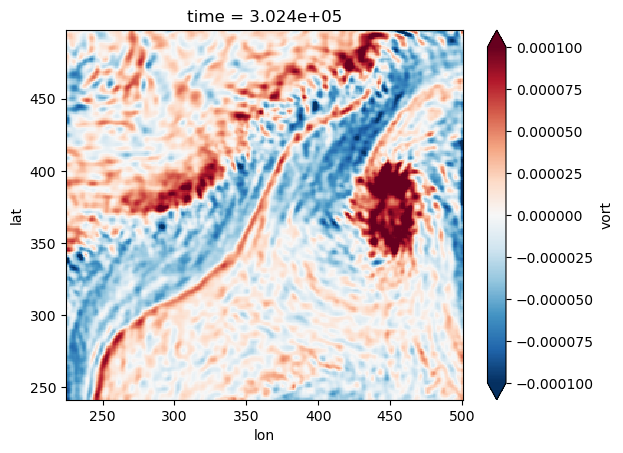

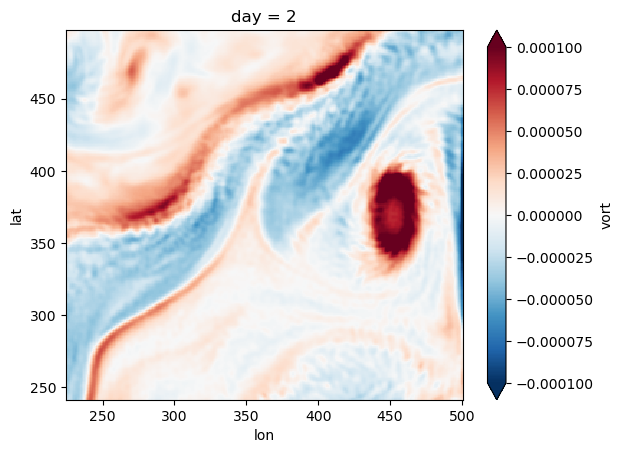

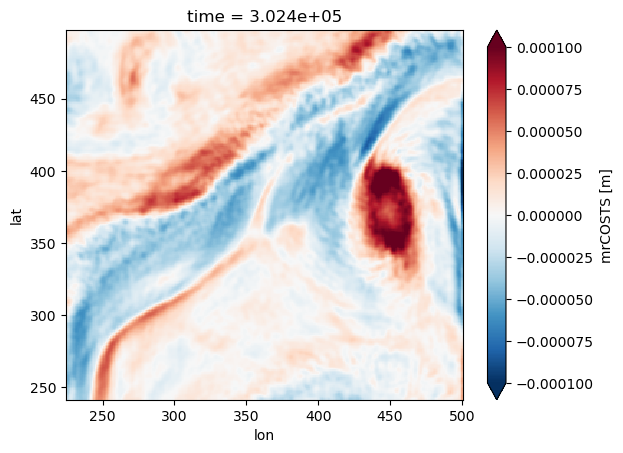

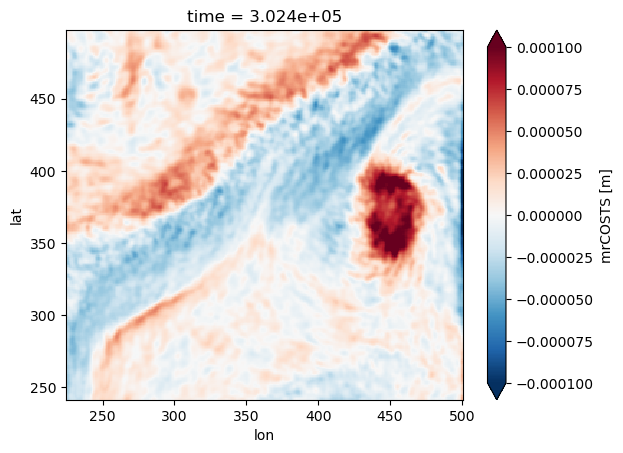

In [45]:
# vor_raw = xr.apply_ufunc(
#     t_vort,
#     SSU[::12], 
#     vg_raw, 
#     hycom_grid.qscx, hycom_grid.qscy,
#     hycom_grid.uscy, hycom_grid.vscx,
#     input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('vort')
# div_raw = xr.apply_ufunc(
#     t_div,
#     ug_raw, 
#     vg_raw, 
#     hycom_grid.pscx, hycom_grid.pscy,
#     hycom_grid.uscx, hycom_grid.vscy,
#     input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('div')
# str_raw = xr.apply_ufunc(
#     t_str,
#     ug_raw, 
#     vg_raw, 
#     hycom_grid.pscx, hycom_grid.pscy,
#     hycom_grid.qscx, hycom_grid.qscy,
#     hycom_grid.uscx, hycom_grid.uscy,
#     hycom_grid.vscx, hycom_grid.vscy,
#     input_core_dims = 10 * [['lat', 'lon']],   # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('strain')
# vor_raw.isel(time=0).plot(vmax=1e-4, rasterized=True)
# plt.show()

vorg_raw = xr.apply_ufunc(
    t_vort,
    ug_raw, 
    vg_raw, 
    hycom_grid.pscx, hycom_grid.pscy,
    hycom_grid.uscy, hycom_grid.vscx,
    input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('vort')
divg_raw = xr.apply_ufunc(
    t_div,
    ug_raw, 
    vg_raw, 
    hycom_grid.qscx, hycom_grid.qscy,
    hycom_grid.uscx, hycom_grid.vscy,
    input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('div')
strg_raw = xr.apply_ufunc(
    t_str,
    ug_raw, 
    vg_raw, 
    hycom_grid.pscx, hycom_grid.pscy,
    hycom_grid.qscx, hycom_grid.qscy,
    hycom_grid.uscx, hycom_grid.uscy,
    hycom_grid.vscx, hycom_grid.vscy,
    input_core_dims = 10 * [['lat', 'lon']],   # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('strain')
vorg_raw.isel(time=0).plot(vmax=1e-4, rasterized=True)
plt.show()

vorg_d = xr.apply_ufunc(
    t_vort,
    ug_d, 
    vg_d, 
    hycom_grid.pscx, hycom_grid.pscy,
    hycom_grid.uscy, hycom_grid.vscx,
    input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('vort')
divg_d = xr.apply_ufunc(
    t_div,
    ug_d, 
    vg_d, 
    hycom_grid.qscx, hycom_grid.qscy,
    hycom_grid.uscx, hycom_grid.vscy,
    input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('div')
strg_d = xr.apply_ufunc(
    t_str,
    ug_d, 
    vg_d, 
    hycom_grid.pscx, hycom_grid.pscy,
    hycom_grid.qscx, hycom_grid.qscy,
    hycom_grid.uscx, hycom_grid.uscy,
    hycom_grid.vscx, hycom_grid.vscy,
    input_core_dims = 10 * [['lat', 'lon']],   # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('strain')
vorg_d.isel(day=0).plot(vmax=1e-4, rasterized=True)
plt.show()

# vorgcost_r = xr.apply_ufunc(
#     t_vort,
#     ugcost_r, 
#     vgcost_r, 
#     hycom_grid.pscx, hycom_grid.pscy,
#     hycom_grid.uscy, hycom_grid.vscx,
#     input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('vort')
# divgcost_r = xr.apply_ufunc(
#     t_div,
#     ugcost_r, 
#     vgcost_r, 
#     hycom_grid.qscx, hycom_grid.qscy,
#     hycom_grid.uscx, hycom_grid.vscy,
#     input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('div')
# strgcost_r = xr.apply_ufunc(
#     t_str,
#     ugcost_r, 
#     vgcost_r, 
#     hycom_grid.pscx, hycom_grid.pscy,
#     hycom_grid.qscx, hycom_grid.qscy,
#     hycom_grid.uscx, hycom_grid.uscy,
#     hycom_grid.vscx, hycom_grid.vscy,
#     input_core_dims = 10 * [['lat', 'lon']],   # 4 inputs
#     output_core_dims = [['lat', 'lon']],
#     output_dtypes=[SSH.dtype],
#     dask="parallelized"
# ).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('strain')
# vorgcost_r.isel(time=0).plot(vmax=1e-4, rasterized=True)
# plt.show()

vorgcost3 = xr.apply_ufunc(
    t_vort,
    ugcost3, 
    vgcost3, 
    hycom_grid.pscx, hycom_grid.pscy,
    hycom_grid.uscy, hycom_grid.vscx,
    input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('vort')
divgcost3 = xr.apply_ufunc(
    t_div,
    ugcost3, 
    vgcost3, 
    hycom_grid.qscx, hycom_grid.qscy,
    hycom_grid.uscx, hycom_grid.vscy,
    input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('div')
strgcost3 = xr.apply_ufunc(
    t_str,
    ugcost3, 
    vgcost3, 
    hycom_grid.pscx, hycom_grid.pscy,
    hycom_grid.qscx, hycom_grid.qscy,
    hycom_grid.uscx, hycom_grid.uscy,
    hycom_grid.vscx, hycom_grid.vscy,
    input_core_dims = 10 * [['lat', 'lon']],   # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('strain')
vorgcost3.isel(time=0).plot(vmax=1e-4, rasterized=True)
plt.show()

vorgcost12 = xr.apply_ufunc(
    t_vort,
    ugcost12, 
    vgcost12, 
    hycom_grid.pscx, hycom_grid.pscy,
    hycom_grid.uscy, hycom_grid.vscx,
    input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('vort')
divgcost12 = xr.apply_ufunc(
    t_div,
    ugcost12, 
    vgcost12, 
    hycom_grid.qscx, hycom_grid.qscy,
    hycom_grid.uscx, hycom_grid.vscy,
    input_core_dims = 6 * [['lat', 'lon']],    # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('div')
strgcost12 = xr.apply_ufunc(
    t_str,
    ugcost12, 
    vgcost12, 
    hycom_grid.pscx, hycom_grid.pscy,
    hycom_grid.qscx, hycom_grid.qscy,
    hycom_grid.uscx, hycom_grid.uscy,
    hycom_grid.vscx, hycom_grid.vscy,
    input_core_dims = 10 * [['lat', 'lon']],   # 4 inputs
    output_core_dims = [['lat', 'lon']],
    output_dtypes=[SSH.dtype],
    dask="parallelized"
).isel(lat=slice(2,-2),lon=slice(2,-2)).reset_coords(drop=True).rename('strain')
vorgcost12.isel(time=0).plot(vmax=1e-4, rasterized=True)
plt.show()

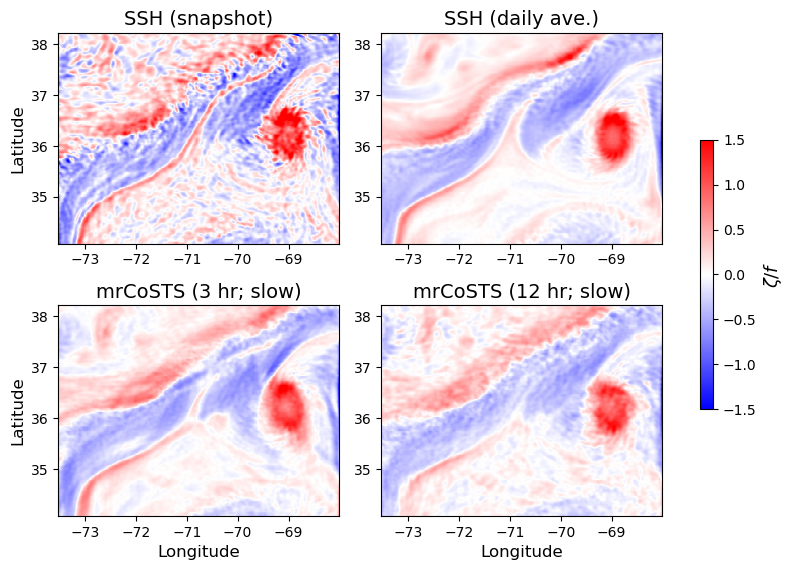

In [46]:
fig, axes = plt.subplots(figsize=(10,7), nrows=2, ncols=2)
# fig.set_tight_layout(True)

im0 = axes[0,0].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     vorg_raw.isel(time=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='bwr', vmax=1.5, vmin=-1.5)
axes[0,1].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     vorg_d.isel(day=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='bwr', vmax=1.5, vmin=-1.5)
axes[1,0].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     vorgcost3.isel(time=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='bwr', vmax=1.5, vmin=-1.5)
axes[1,1].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     vorgcost12.isel(time=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='bwr', vmax=1.5, vmin=-1.5)

axes[0,0].set_aspect('equal')
axes[0,1].set_aspect('equal')
axes[1,0].set_aspect('equal')
axes[1,1].set_aspect('equal')

axes[0,0].set_title(r"SSH (snapshot)", fontsize=14)
axes[0,1].set_title(r"SSH (daily ave.)", fontsize=14)
axes[1,0].set_title(r"mrCoSTS (3 hr; slow)", fontsize=14)
axes[1,1].set_title(r"mrCoSTS (12 hr; slow)", fontsize=14)

axes[0,0].set_ylabel(r"Latitude", fontsize=12)
axes[1,0].set_ylabel(r"Latitude", fontsize=12)
axes[1,0].set_xlabel(r"Longitude", fontsize=12)
axes[1,1].set_xlabel(r"Longitude", fontsize=12)

fig.subplots_adjust(right=.88, hspace=.02, wspace=.15)
cbar0 = fig.colorbar(im0, ax=axes, shrink=.5)
cbar0.set_label(r"$\zeta/f$", fontsize=13)

plt.savefig(op.join(sdir,'Figs/HYCOM50-vort_mrCOSTS.pdf'))

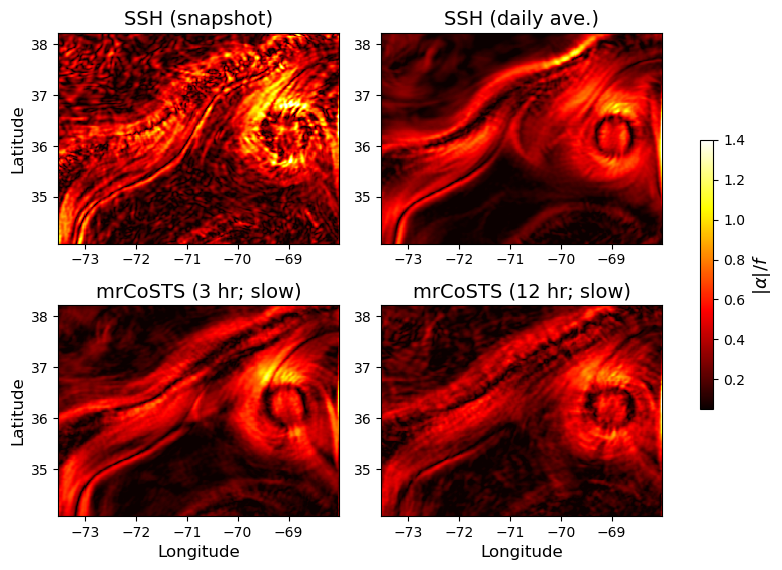

In [48]:
fig, axes = plt.subplots(figsize=(10,7), nrows=2, ncols=2)
# fig.set_tight_layout(True)

im0 = axes[0,0].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     strg_raw.isel(time=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='hot', vmax=1.4, vmin=.05)
axes[0,1].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     strg_d.isel(day=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='hot', vmax=1.4, vmin=.05)
axes[1,0].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     strgcost3.isel(time=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='hot', vmax=1.4, vmin=.05)
axes[1,1].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     strgcost12.isel(time=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='hot', vmax=1.4, vmin=.05)

axes[0,0].set_aspect('equal')
axes[0,1].set_aspect('equal')
axes[1,0].set_aspect('equal')
axes[1,1].set_aspect('equal')

axes[0,0].set_title(r"SSH (snapshot)", fontsize=14)
axes[0,1].set_title(r"SSH (daily ave.)", fontsize=14)
axes[1,0].set_title(r"mrCoSTS (3 hr; slow)", fontsize=14)
axes[1,1].set_title(r"mrCoSTS (12 hr; slow)", fontsize=14)

axes[0,0].set_ylabel(r"Latitude", fontsize=12)
axes[1,0].set_ylabel(r"Latitude", fontsize=12)
axes[1,0].set_xlabel(r"Longitude", fontsize=12)
axes[1,1].set_xlabel(r"Longitude", fontsize=12)

fig.subplots_adjust(right=.88, hspace=.02, wspace=.15)
cbar0 = fig.colorbar(im0, ax=axes, shrink=.5)
cbar0.set_label(r"$|\alpha|/f$", fontsize=13)

plt.savefig(op.join(sdir,'Figs/HYCOM50-str_mrCOSTS.pdf'))

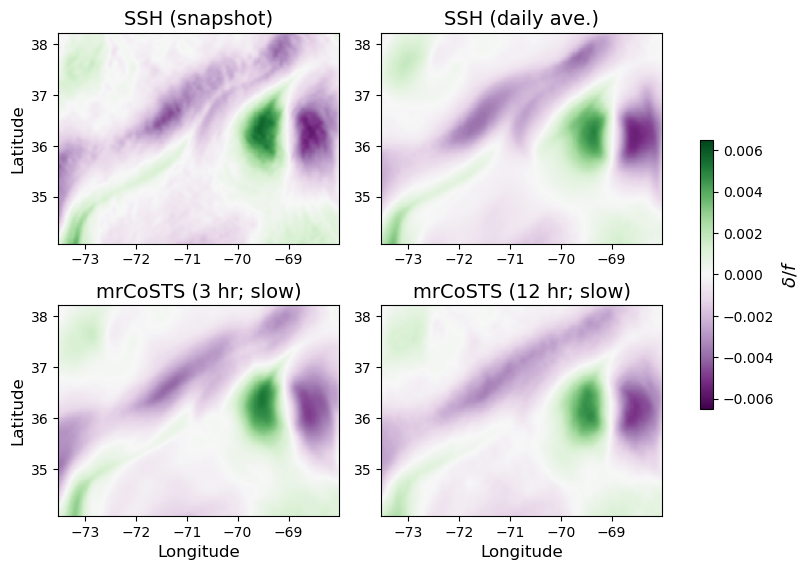

In [55]:
fig, axes = plt.subplots(figsize=(10,7), nrows=2, ncols=2)
# fig.set_tight_layout(True)

im0 = axes[0,0].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     divg_raw.isel(time=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='PRGn', vmax=.0065, vmin=-.0065)
axes[0,1].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     divg_d.isel(day=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='PRGn', vmax=.0065, vmin=-.0065)
axes[1,0].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     divgcost3.isel(time=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='PRGn', vmax=.0065, vmin=-.0065)
axes[1,1].pcolormesh(hycom_grid.plon.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     hycom_grid.plat.isel(lat=slice(2,-2),lon=slice(2,-2)),
                     divgcost12.isel(time=0)/hycomf.isel(lat=slice(2,-2),lon=slice(2,-2)), 
                     rasterized=True,
                     cmap='PRGn', vmax=.0065, vmin=-.0065)

axes[0,0].set_aspect('equal')
axes[0,1].set_aspect('equal')
axes[1,0].set_aspect('equal')
axes[1,1].set_aspect('equal')

axes[0,0].set_title(r"SSH (snapshot)", fontsize=14)
axes[0,1].set_title(r"SSH (daily ave.)", fontsize=14)
axes[1,0].set_title(r"mrCoSTS (3 hr; slow)", fontsize=14)
axes[1,1].set_title(r"mrCoSTS (12 hr; slow)", fontsize=14)

axes[0,0].set_ylabel(r"Latitude", fontsize=12)
axes[1,0].set_ylabel(r"Latitude", fontsize=12)
axes[1,0].set_xlabel(r"Longitude", fontsize=12)
axes[1,1].set_xlabel(r"Longitude", fontsize=12)

fig.subplots_adjust(right=.88, hspace=.02, wspace=.15)
cbar0 = fig.colorbar(im0, ax=axes, shrink=.5)
cbar0.set_label(r"$\delta/f$", fontsize=13)

plt.savefig(op.join(sdir,'Figs/HYCOM50-div_mrCOSTS.pdf'))

In [129]:
vbins = np.linspace(-4e0,4e0,40)
sbins = np.linspace(0,4e0,20)
hist_h = xhist((strg_raw
                / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
               ).rename('strain').chunk({'time':10,'lat':-1,'lon':-1}), 
               (vorg_raw
                / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
               ).rename('vort').chunk({'time':10,'lat':-1,'lon':-1}), 
               bins=[sbins, vbins], density=True
              ).compute()
hist_d = xhist((strg_d
                / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
               ).rename('strain').chunk({'day':10,'lat':-1,'lon':-1}), 
               (vorg_d
                / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
               ).rename('vort').chunk({'day':10,'lat':-1,'lon':-1}), 
               bins=[sbins, vbins], density=True
              ).compute()
hist_3 = xhist((strgcost3
                / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
               ).rename('strain').chunk({'time':10,'lat':-1,'lon':-1}), 
               (vorgcost3
                / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
               ).rename('vort').chunk({'time':10,'lat':-1,'lon':-1}), 
               bins=[sbins, vbins], density=True
              ).compute()
# hist_r = xhist((strgcost_r
#                 / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
#                ).rename('strain').chunk({'time':10,'lat':-1,'lon':-1}), 
#                (vorgcost_r
#                 / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
#                ).rename('vort').chunk({'time':10,'lat':-1,'lon':-1}), 
#                bins=[sbins, vbins], density=True
#               ).compute()
hist_12 = xhist((strgcost12
                / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
               ).rename('strain').chunk({'time':10,'lat':-1,'lon':-1}), 
               (vorgcost12
                / hycomf.isel(lat=slice(2,-2),lon=slice(2,-2))
               ).rename('vort').chunk({'time':10,'lat':-1,'lon':-1}), 
               bins=[sbins, vbins], density=True
              ).compute()

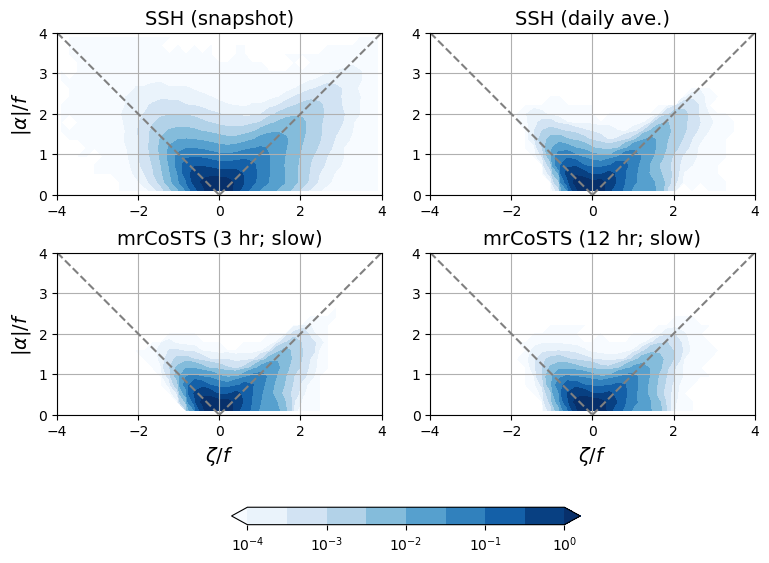

In [147]:
fig, axes = plt.subplots(figsize=(9,8), nrows=2, ncols=2)
# fig.set_tight_layout(True)

im0 = axes[0,0].contourf(hist_h.vort_bin,
                 hist_h.strain_bin,
                 hist_h, 
                 cmap='Blues', locator=ticker.LogLocator(), 
                 norm=clr.LogNorm(), levels=np.logspace(-4,0,9),
                 extend='both'
#                       rasterized=True
               )
im1 = axes[0,1].contourf(hist_d.vort_bin,
                 hist_d.strain_bin,
                 hist_d, 
                 cmap='Blues', locator=ticker.LogLocator(), 
                 norm=clr.LogNorm(), levels=np.logspace(-4,0,9),
                 extend='both'
#                       rasterized=True
               )
im2 = axes[1,0].contourf(hist_3.vort_bin,
                 hist_3.strain_bin,
                 hist_3, 
                 cmap='Blues', locator=ticker.LogLocator(), 
                 norm=clr.LogNorm(), levels=np.logspace(-4,0,9),
                 extend='both'
#                       rasterized=True
               )
im3 = axes[1,1].contourf(hist_12.vort_bin,
                 hist_12.strain_bin,
                 hist_12, 
                 cmap='Blues', locator=ticker.LogLocator(), 
                 norm=clr.LogNorm(), levels=np.logspace(-4,0,9),
                 extend='both'
#                       rasterized=True
               )
for c in im0.collections:
    c.set_rasterized(True)
for c in im1.collections:
    c.set_rasterized(True)
for c in im2.collections:
    c.set_rasterized(True)
for c in im3.collections:
    c.set_rasterized(True)

axes[0,0].plot(np.linspace(0,4,5),np.linspace(0,4,5),c='grey',ls='--')
axes[0,0].plot(np.linspace(-4,0,5),np.linspace(4,0,5),c='grey',ls='--')
axes[0,1].plot(np.linspace(0,4,5),np.linspace(0,4,5),c='grey',ls='--')
axes[0,1].plot(np.linspace(-4,0,5),np.linspace(4,0,5),c='grey',ls='--')
axes[1,0].plot(np.linspace(0,4,5),np.linspace(0,4,5),c='grey',ls='--')
axes[1,0].plot(np.linspace(-4,0,5),np.linspace(4,0,5),c='grey',ls='--')
axes[1,1].plot(np.linspace(0,4,5),np.linspace(0,4,5),c='grey',ls='--')
axes[1,1].plot(np.linspace(-4,0,5),np.linspace(4,0,5),c='grey',ls='--')

axes[0,0].set_xlim([-4,4])
axes[0,0].set_ylim([0,4])
axes[0,1].set_xlim([-4,4])
axes[0,1].set_ylim([0,4])
axes[1,0].set_xlim([-4,4])
axes[1,0].set_ylim([0,4])
axes[1,1].set_xlim([-4,4])
axes[1,1].set_ylim([0,4])

axes[0,0].set_title(r"SSH (snapshot)", fontsize=14)
axes[0,1].set_title(r"SSH (daily ave.)", fontsize=14)
axes[1,0].set_title(r"mrCoSTS (3 hr; slow)", fontsize=14)
axes[1,1].set_title(r"mrCoSTS (12 hr; slow)", fontsize=14)

axes[1,0].set_xlabel(r"$\zeta/f$", fontsize=14)
axes[0,0].set_ylabel(r"$|\alpha|/f$", fontsize=14)
axes[1,1].set_xlabel(r"$\zeta/f$", fontsize=14)
axes[1,0].set_ylabel(r"$|\alpha|/f$", fontsize=14)

axes[0,0].grid(True)
axes[0,0].set_aspect('equal')
axes[0,1].grid(True)
axes[0,1].set_aspect('equal')
axes[1,0].grid(True)
axes[1,0].set_aspect('equal')
axes[1,1].grid(True)
axes[1,1].set_aspect('equal')

fig.subplots_adjust(hspace=.04, wspace=.15)
cbar = fig.colorbar(im0, orientation='horizontal', ax=axes, shrink=.5, 
                    ticks=[1e-4,1e-3,1e-2,1e-1,1e0])

plt.savefig(op.join(sdir,'Figs/vort-strain-HYCOM50jointPDF.pdf'))